In [1]:
### ValDXer testing
import os
os.environ["HDXER_PATH"] = "/home/alexi/Documents/HDXer"
from ValDX.ValidationDX import ValDXer
from ValDX.VDX_Settings import Settings
import pandas as pd
import MDAnalysis as mda
from MDAnalysis.coordinates.XTC import XTCWriter


settings = Settings(name='test_full0.5')
settings.replicates = 1
settings.gamma_range = (2,6)
settings.train_frac = 0.5
settings.RW_exponent = [0]
settings.split_mode = 'R3'
settings.stride = 1000
# settings.HDXer_stride = 10000

settings.RW_do_reweighting = True
settings.RW_do_params = False
import pickle

VDX = ValDXer(settings)
expt_name = 'Experimental'
test_name = "BRD4apo1_test"

import cProfile
import pstats

/home/alexi/Documents/ValDX


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
Experiment name test_full0.5 already exists. Attempting t

In [2]:
import mdtraj as md

In [3]:
### add code to read in sequence from CIF file instead of copying it manually

cif_file = "raw_data/BRD4/BRD4_APO/AF-O60885-F1-model_v4.cif"

sequence_header = "_entity_poly.pdbx_seq_one_letter_code"
sequence = ""
seq_head_idx = 0
with open(cif_file, 'r') as f:
    lines = f.readlines()
    for idx, line in enumerate(lines):
        if sequence_header in line:
            seq_head_idx = idx+1
            break
    
    for idx, line in enumerate(lines[seq_head_idx:]):
        if idx > 0 and line[0] == ";":
            break
        sequence += line.strip()


# print(sequence)



# strip sequence of non letters
sequence = ''.join([i for i in sequence if i.isalpha()])

print(sequence)

print("Sequence length: ", len(sequence))


MSAESGPGTRLRNLPVMGDGLETSQMSTTQAQAQPQPANAASTNPPPPETSNPNKPKRQTNQLQYLLRVVLKTLWKHQFAWPFQQPVDAVKLNLPDYYKIIKTPMDMGTIKKRLENNYYWNAQECIQDFNTMFTNCYIYNKPGDDIVLMAEALEKLFLQKINELPTEETEIMIVQAKGRGRGRKETGTAKPGVSTVPNTTQASTPPQTQTPQPNPPPVQATPHPFPAVTPDLIVQTPVMTVVPPQPLQTPPPVPPQPQPPPAPAPQPVQSHPPIIAATPQPVKTKKGVKRKADTTTPTTIDPIHEPPSLPPEPKTTKLGQRRESSRPVKPPKKDVPDSQQHPAPEKSSKVSEQLKCCSGILKEMFAKKHAAYAWPFYKPVDVEALGLHDYCDIIKHPMDMSTIKSKLEAREYRDAQEFGADVRLMFSNCYKYNPPDHEVVAMARKLQDVFEMRFAKMPDEPEEPVVAVSSPAVPPPTKVVAPPSSSDSSSDSSSDSDSSTDDSEEERAQRLAELQEQLKAVHEQLAALSQPQQNKPKKKEKDKKEKKKEKHKRKEEVEENKKSKAKEPPPKKTKKNNSSNSNVSKKEPAPMKSKPPPTYESEEEDKCKPMSYEEKRQLSLDINKLPGEKLGRVVHIIQSREPSLKNSNPDEIEIDFETLKPSTLRELERYVTSCLRKKRKPQAEKVDVIAGSSKMKGFSSSESESSSESSSSDSEDSETEMAPKSKKKGHPGREQKKHHHHHHQQMQQAPAPVPQQPPPPPQQPPPPPPPQQQQQPPPPPPPPSMPQQAAPAMKSSPPPFIATQVPVLEPQLPGSVFDPIGHFTQPILHLPQPELPPHLPQPPEHSTPPHLNQHAVVSPPALHNALPQQPSRPSNRAAALPPKPARPPAVSPALTQTPLLPQPPMAQPPQVLLEDEEPPAPPLTSMQMQLYLQQLQKVQPPTPLLPSVKVQSQPPPPLPPPPHPSVQQQLQQQPPPPPPPQPQPPPQQQHQPPPRPVHLQ

In [4]:
# # convert sequence to FASTA format
# def write_fasta(sequence, header, file_name):
#     """
#     Writes a single-letter amino acid sequence to a FASTA file.
    
#     Parameters:
#     - sequence: A string containing the amino acid sequence.
#     - header: A string to be used as the header in the FASTA file.
#     - file_name: The name of the FASTA file to be created.
#     """
#     print(f"Writing sequence to {file_name}")
#     with open(file_name, 'w') as fasta_file:
#         # Write the header with the '>' symbol
#         fasta_file.write(f">{header}\n")
        
#         # Write the sequence in lines of 80 characters
#         for i in range(0, len(sequence), 80):
#             fasta_file.write(sequence[i:i+80] + "\n")


In [5]:
# # fasta_path = os.path.join("raw_data", "BRD4", 'BRD4_APO.fasta')
# write_fasta(sequence, 'LXRa', fasta_path)


In [6]:
# raw_hdx_path = "raw_data/BRD4/BRD4_APO/ELN55049_AllResultsTables_Curated.csv"
# raw_hdx = pd.read_csv(raw_hdx_path)
# raw_hdx.head()

In [7]:
# # convert FD in DeutTime to -1
# raw_hdx["Exposure"] = raw_hdx["DeutTime"].replace('FD', -1)

# # remove 's' from Deuteration Time
# raw_hdx["Exposure"] = raw_hdx["Exposure"].str.replace('s', '').astype(float)

# # replace NaN with -1
# raw_hdx["Exposure"].fillna(-1, inplace=True)

# raw_hdx.head()

In [8]:

# # print entire dataframe
# pd.set_option('display.max_rows', None)
# pd.set_option('display.max_columns', None)
# pd.set_option('display.width', None)
# print(raw_hdx.loc[raw_hdx["Exposure"] == 0]["Uptake"])

In [9]:
# print(raw_hdx.loc[raw_hdx["Exposure"] == 0].Uptake.value_counts(dropna=False))

# # fill NaNs with 0
# raw_hdx["Uptake"].fillna(0, inplace=True)

In [10]:
# # group by Start and End to extract peptide using ngroup
# raw_hdx["Peptide"] = raw_hdx.groupby(["Start", "End"]).ngroup()

# raw_hdx.head()



In [11]:
# # average Uptake for each peptide and Exposure
# hdx = raw_hdx.groupby(["Start","End","Peptide", "Exposure"])["Uptake"].mean().reset_index()

# print(hdx)

In [12]:
# # select Exposure -1
# max_uptake = hdx.loc[hdx["Exposure"] == -1]["Uptake"].values

# print(max_uptake)

# no_exposure_times = hdx["Exposure"].unique()
# print(len(no_exposure_times))

# # extend max_uptake to all Exposure times (each elemetn should be repeated len(no_exposure_times) times) ie [[m]*no_exposure_times for m in max_uptake]
# max_uptake = [m for m in max_uptake for _ in range(len(no_exposure_times))]
# print(max_uptake)


# # add max_uptake to hdx
# hdx["MaxUptake"] = max_uptake


In [13]:
# print(hdx)

In [14]:
# hdx['UptakeFraction'] = hdx['Uptake'] / hdx['MaxUptake']

# hdx.head()

In [15]:
# # remove Exposure -1
# hdx = hdx.loc[hdx["Exposure"] != -1]

# hdx.head()

In [16]:

# # pivot exposure and uptake fraction
# hdx = hdx.groupby(['Start', 'End', 'Exposure'])['UptakeFraction'].mean().reset_index()

# print(hdx)




In [17]:
# # clamp UptakeFraction to 1
# hdx["UptakeFraction"] = hdx["UptakeFraction"].clip(upper=1)
# print(hdx)


In [18]:
# # conver to HDXer format ie start, end, exposure_1, exposure_2 

# # pivot so that exposure time is the column name drop the exposure column
# hdx = hdx.pivot(index=['Start', 'End'], columns='Exposure', values='UptakeFraction').reset_index()

# # change Start to ResStr and End to ResEnd
# hdx = hdx.rename(columns={'Start': 'ResStr', 'End': 'ResEnd'})

# # drop the exposure column
# hdx.columns.name = None

# print(hdx)


In [19]:
# print(hdx)


In [20]:

# hdx = hdx.round(5)
# hdx.to_csv(os.path.join("raw_data", "BRD4", 'BRD4_APO.dat'), sep=' ', index=False)


In [21]:
# segs = raw_hdx[['Start', 'End']].drop_duplicates().sort_values(by=['Start', 'End']).reset_index(drop=True)


In [22]:

# # convert to list of tuples
# segs = [tuple(x) for x in segs.values]

# print(segs)


In [23]:


# # write list as new lines with space delimiter
# with open(os.path.join("raw_data", "BRD4", 'BRD4_APO_segs.txt'), 'w') as f:
#     for item in segs:
#         f.write("%s\n" % ' '.join(map(str, item)))

In [24]:
# from pdbfixer import PDBFixer
# from openmm.app import PDBFile

# BPTI_dir = "/Users/alexi/Library/CloudStorage/OneDrive-Nexus365/Rotation_Projects/Rotation_3/Project/ValDX/raw_data/BRD4/BRD4_APO"
# sim_dir = os.path.join(BPTI_dir, "alphafold_quick")

# pdb_list = [f for f in os.listdir(sim_dir) if f.endswith('.pdb')]

# print(pdb_list) 


# H_sim_dir = os.path.join(BPTI_dir, "alphafold_H")

# os.makedirs(H_sim_dir, exist_ok=True)

# for pdb in pdb_list:
#     fixer = PDBFixer(os.path.join(sim_dir, pdb))
#     fixer.addMissingHydrogens(7.0)
#     H_pdb_name = pdb.replace('.pdb', '_H.pdb')
#     PDBFile.writeFile(fixer.topology, fixer.positions, open(os.path.join(H_sim_dir, H_pdb_name), 'w'), keepIds=True)

# pdb_list = [f for f in os.listdir(H_sim_dir) if f.endswith('.pdb')]



Generate conformations with Alphafold

# need to find out how to generate a wide range of conformations

In [25]:
def pre_process_main():
    # BPTI data
    BPTI_dir = "/home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO"

    # BPTI_dir = "/home/alexi/Documents/ValDX/raw_data/HDXer_tutorial/BPTI"

    os.listdir(BPTI_dir)

    segs_name = "BRD4_APO_segs.txt"
    segs_path = os.path.join(BPTI_dir, segs_name)

    hdx_name = "BRD4_APO.dat"
    hdx_path = os.path.join(BPTI_dir, hdx_name)
    print(hdx_path)

    rates_name = "out__train_MD_Simulated_1Intrinsic_rates.dat"
    rates_path = os.path.join(BPTI_dir, rates_name)
    sim_name = 'BRD4_AF'

    sim_dir = os.path.join(BPTI_dir, "alphafold_quick")

    pdb_list = [f for f in os.listdir(sim_dir) if f.endswith('.pdb')]

    print(pdb_list) 


    H_sim_dir = os.path.join(BPTI_dir, "alphafold_H")

    os.makedirs(H_sim_dir, exist_ok=True)

    for pdb in pdb_list:
        continue
        fixer = PDBFixer(os.path.join(sim_dir, pdb))
        fixer.addMissingHydrogens(7.0)
        H_pdb_name = pdb.replace('.pdb', '_H.pdb')
        PDBFile.writeFile(fixer.topology, fixer.positions, open(os.path.join(H_sim_dir, H_pdb_name), 'w'), keepIds=True)

    pdb_list = [f for f in os.listdir(H_sim_dir) if f.endswith('.pdb')]
    print(pdb_list)

    top_path = "/home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO_484_protonated.pdb"
    # pdb_paths = [os.path.join(H_sim_dir, i) for i in pdb_list]

    # print("top",top_path)


    # print(pdb_paths)

    # small_traj_path = top_path.replace(".pdb","_small.xtc")
    # # small_traj_path = os.path.join(sim_dir, small_traj_name)

    # u = mda.Universe(top_path, pdb_paths)

    # print(small_traj_path)
        
    # with XTCWriter(small_traj_path, n_atoms=u.atoms.n_atoms) as W:
    #     for ts in u.trajectory:
    #         W.write(u.atoms)

    # traj_paths = [os.path.join(sim_dir, i) for i in os.listdir(sim_dir) if i.endswith(".pdb")]
    
    traj_paths = ["/home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO_484_protonated.xtc"]
    print(traj_paths)
    return hdx_path, segs_path, rates_path, top_path, traj_paths, sim_name, expt_name, test_name


In [26]:
hdx_path, segs_path, rates_path, top_path, traj_paths, sim_name, expt_name, test_name = pre_process_main()

/home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO/BRD4_APO.dat
['BRD4_apo_unrelaxed_rank_003_alphafold2_ptm_model_5_seed_000.pdb', 'BRD4_apo_unrelaxed_rank_002_alphafold2_ptm_model_1_seed_000.pdb', 'BRD4_apo_unrelaxed_rank_004_alphafold2_ptm_model_4_seed_000.pdb', 'BRD4_apo_unrelaxed_rank_005_alphafold2_ptm_model_3_seed_000.pdb', 'BRD4_apo_unrelaxed_rank_001_alphafold2_ptm_model_2_seed_000.pdb']
['BRD4_apo_unrelaxed_rank_002_alphafold2_ptm_model_1_seed_000_H.pdb', 'BRD4_apo_unrelaxed_rank_004_alphafold2_ptm_model_4_seed_000_H.pdb', 'BRD4_apo_unrelaxed_rank_003_alphafold2_ptm_model_5_seed_000_H.pdb', 'BRD4_apo_unrelaxed_rank_005_alphafold2_ptm_model_3_seed_000_H.pdb', 'BRD4_apo_unrelaxed_rank_001_alphafold2_ptm_model_2_seed_000_H.pdb']
['/home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO_484_protonated.xtc']


In [27]:
combined_analysis_dump, names, save_paths = VDX.run_benchmark_ensemble(system=test_name,
                                                                        times=[0.0, 15.0, 60.0, 600.0, 3600.0, 14400.0],
                                                                        expt_name=expt_name,
                                                                        n_reps=1,
                                                                        split_modes=['r','s','R3'],
                                                                        RW=True,
                                                                        hdx_path=hdx_path,
                                                                        segs_path=segs_path,
                                                                        traj_paths=traj_paths,
                                                                        top_path=top_path)

                                                                        

(2, 6)
Running benchmark for test_full0.5
Running r split mode
envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_h

Preparing HDX data for Experimental
Path /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO/BRD4_APO.dat
AVG: ncol = 8, len(names) = 6
                                                 HDX  \
0  /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4...   
1                                                NaN   

                                                 SEG      calc_name  \
0  /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4...   Experimental   
1                                                NaN  BRD4apo1_test   

  experimental                                                top  \
0        False                                                NaN   
1          NaN  /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4...   

                                                traj  
0                                                NaN  
1  [/home/alexi/Documents/ValDX/raw_data/BRD4/BRD...  
Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))


envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

KeyboardInterrupt: 

Residue predictions complete



/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

Coords shape
(110, 1440)
Performing PCA
Transformed data
(110, 2)
Fitting KMeans
Getting cluster centers
(88, 2)
Getting cluster labels
(110,)
Unique labels
(88,)
Cluster frames
[6, 109, 20, 87, 68, 19, 59, 8, 40, 85, 98, 62, 76, 0, 80, 4, 64, 54, 50, 35, 67, 31, 97, 52, 16, 23, 36, 49, 88, 43, 69, 33, 100, 44, 48, 94, 10, 13, 51, 108, 14, 3, 25, 96, 83, 77, 107, 26, 11, 65, 70, 47, 15, 60, 84, 105, 41, 91, 92, 78, 74, 30, 17, 66, 73, 18, 5, 12, 1, 79, 46, 42, 82, 45, 34, 2, 27, 9, 103, 63, 101, 93, 39, 99, 58, 90, 32, 106]
88
Cluster weights
[0.8 0.8 0.8 1.6 1.6 1.6 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 1.6 0.8 1.6 1.6
 1.6 0.8 0.8 2.4 0.8 0.8 0.8 0.8 0.8 0.8 0.8 1.6 0.8 0.8 1.6 0.8 0.8 0.8
 0.8 0.8 2.4 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 1.6 0.8 0.8 1.6 1.6 0.8 0.8
 0.8 0.8 0.8 0.8 0.8 0.8 1.6 0.8 0.8 1.6 1.6 0.8 1.6 0.8 1.6 0.8 0.8 0.8
 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 0.8 1.6 0.8]
(88,)


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


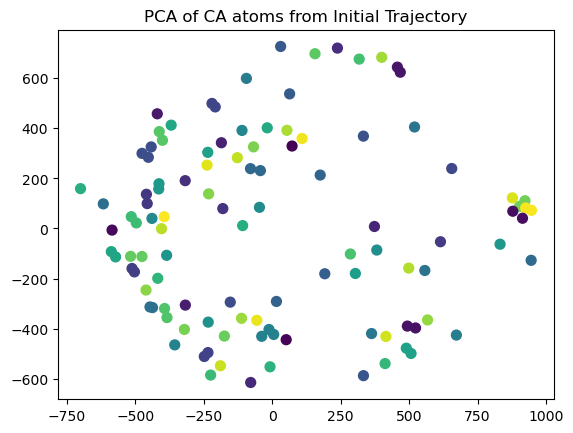

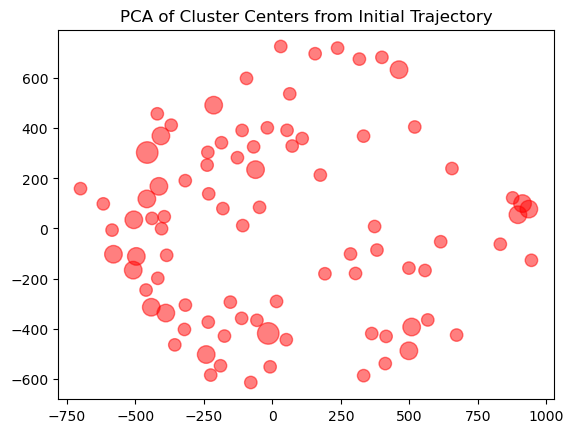

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))


envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
Experiment name R3_k_sequence_BRD4apo1_test already exist

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

Residue predictions complete

Path /home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test3/train_BRD4apo1_test_1/out__train_BRD4apo1_test_1Segment_average_fractions.dat
AVG: ncol = 8, len(names) = 6
Experimental BRD4apo1_test True 1
/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test3/train_BRD4apo1_test_1/train_BRD4apo1_test_1_expt_dfracs.dat
/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test3/train_BRD4apo1_test_1
/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test3/train_BRD4apo1_test_1/out__train_BRD4apo1_test_1Intrinsic_rates.dat
REWIGHTING train_BRD4apo1_test_1 with Exponent: 0
[{'do_reweight': True, 'do_params': False, 'stepfactor': 0.001, 'basegamma': 1, 'predictHDX_dir': ['/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test3/train_BRD4apo1_test_1'], 'kint_file': '/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test3/train_BRD4apo1_test_1/out__train_BRD4apo1_test_1Intrinsic_rates.dat', 'exp_file': '/home/alexi/Documents/ValDX/d

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test3/train_BRD4apo1_test_1/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([1.39309577e-06, 6.07835975e-10, 1.90300433e-08, 7.00891783e-03,
       4.25116673e-05, 1.86930964e-04, 3.68800264e-33, 4.74100853e-02,
       3.25585679e-02, 4.68020789e-02, 2.21841196e-05, 2.17914065e-03,
       9.37088714e-08, 2.66957601e-02, 6.20525766e-02, 7.87941155e-34,
       5.08676802e-05, 3.20674372e-04, 1.75581745e-03, 7.08171242e-29,
       5.19730310e-03, 1.57596011e-04, 1.65701992e-07, 8.60685561e-04,
       1.69866696e-05, 1.75875785e-06, 2.94629748e-31, 8.25397916e-04,
       1.02089996e-34, 2.14598595e-06, 6.20310288e-04, 3.37765516e-04,
       2.35123843e-04, 1.73533685e-06, 2.35300614e-03, 4.61103255e-03,
       1.92436617e-07, 1.01015262e-01, 2.80625175e-07, 8.17707940e-02,
       9.27750052e-04, 5.76272681e-02, 2.72692144e-08, 1.07040339e-0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_1
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_1
    ResStr  ResEnd  peptide                                               path
0        1      26        0  /home/alexi/Documents/ValDX/data/R3_k_sequence...
1        5      26        1  /home/alexi/Documents/ValDX/data/R3_k_sequence...
2       12      26        2  /home/alexi/Documents/ValDX/data/R3_k_sequence...
3       15      26        3  /home/alexi/Documents/ValDX/data/R3_k_sequence...
4       27      40        4  /home/alexi/Documents/ValDX/data/R3_k_sequence...
5       41      63        5  /home/alexi/Documents/ValDX/data/R3_k_sequence...
6       41      65        6  /home/alexi/Documents/ValDX/data/R3_k_sequence...
7      138     148       48  /home/alexi/Documents/ValDX/data/R3_k_sequence...
8      144     151       49  /home/alexi/Documents/ValDX/data/R3_k_sequence...
9      148     155       50  /home/alexi/Documents/ValDX/data/R3_k_sequence...
10     149     155       51  /home/alexi/Documents/ValDX/data/R3_k_sequence...
11     149     156

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(126,)
[0.00000000e+00 0.00000000e+00 9.83310175e-08 1.16835096e+00
 2.62878967e+00 2.62878967e+00 1.46043870e-01 4.77155116e-02
 9.38045375e-02 1.18981581e-01 8.22118547e-02 2.34071056e-02
 1.81905609e-03 2.04494837e-02 1.77545894e-03 2.35685467e-03
 4.66016735e-03 2.32366116e-02 6.91127365e-04 3.99570932e-02
 2.12742591e-10 1.78657493e-34 1.78657493e-34 1.07194496e-34
 0.00000000e+00 0.00000000e+00 5.67204227e-02 3.61795012e-02
 1.00144975e-03 1.11384282e-01 1.44662374e-01 1.33159130e-01
 3.82649613e-01 3.30643730e-01 7.25202883e-01 5.33162224e-01
 1.12473827e+00 1.77271449e+00 4.59753676e+00 4.03307083e+00
 7.48152004e+00 7.63935651e+00 8.12732718e+00 5.98095374e-01
 3.69854382e+00 2.73741390e+00 7.00861509e+00 7.81911518e+00
 1.12443207e+01 1.21897018e+01 1.09857222e+01 1.16146643e+01
 1.13336989e+01 1.06816602e+01 6.90000000e+00 8.06044740e+00
 7.59973188e+00 6.16245072e+00 4.45470374e+00 8.65000010e+00
 3.47061132e+00 5.01105501e+00 1.18895035e+01 1.10241659e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[0.00000000e+00 0.00000000e+00 9.83310175e-08 1.16835096e+00
 2.62878967e+00 2.62878967e+00 1.46043870e-01 4.77155116e-02
 9.38045375e-02 1.18981581e-01 8.22118547e-02 2.34071056e-02
 1.81905609e-03 2.04494837e-02 1.77545894e-03 2.35685467e-03
 4.66016735e-03 2.32366116e-02 6.91127365e-04 3.99570932e-02
 2.12742591e-10 1.78657493e-34 1.78657493e-34 1.07194496e-34
 0.00000000e+00 0.00000000e+00 5.67204227e-02 3.61795012e-02
 1.00144975e-03 1.11384282e-01 1.44662374e-01 1.33159130e-01
 3.82649613e-01 3.30643730e-01 7.25202883e-01 5.33162224e-01
 1.12473827e+00 1.77271449e+00 4.59753676e+00 4.03307083e+00
 7.48152004e+00 7.63935651e+00 8.12732718e+00 5.98095374e-01
 3.69854382e+00 2.73741390e+00 7.00861509e+00 7.81911518e+00
 1.12443207e+01 1.21897018e+01 1.09857222e+01 1.16146643e+01
 1.13336989e+01 1.06816602e+01 1.19813697e+01 1.28366886e+01
 1.09961199e+01 1.13592650e+01 1.42074328e+01 1.25448506e+01
 8.21683930e+00 9.74497246e+00 1.07204689e+01 9.71127248e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/R3_k_sequence_BRD4apo1_test/val_1_R3_k_sequence_BRD4apo1_test_20240229-163334.pdb
Splitting segments for BRD4apo1_test by redundancy mk III
centrality
1    1375
Name: count, dtype: int64
Residue intersection:  [118 119 120 121 122 123 124 125 144 145 146 147 148 389 390 391 392 453]
Intersection peptides:  [ 33  34  35  39  40  41  42  43  44  47  48  49  50  65  66  67  68  69
  70  71  72  73  74  75  76  77  90  96  98  99 100]
0.2980769230769231
Train peptides:  [ 0  1  2  3  4  5  6 45 46 78 79 80 81 82 83 84 85 86 87 88 89 91 92 93
 94 95 97]
0.25961538461538464
Val peptides:  [  7   8   9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24
  25  26  27  28  29  30  31  32  36  37  38  51  52  53  54  55  56  57
  58  59  60  61  62  63  64 101 102 103]
0.4423076923076923
train_segs
   ResStr  ResEnd  peptide              calc_name
0       1      26        0  train_BRD4apo1_test_2
1       5      26        1  train_BRD4apo1_test_2
2      12      

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test3/train_BRD4apo1_test_2/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
0.9999999999999999
Finished reweighting
[(array([5.23700227e-03, 2.92339440e-03, 3.34837436e-03, 5.19643747e-05,
       5.18409310e-03, 5.22371431e-03, 1.22222930e-08, 5.21129895e-04,
       3.59614710e-03, 6.37474520e-04, 1.92573729e-04, 2.72626525e-03,
       9.59199003e-04, 1.55488855e-03, 2.41622611e-03, 1.19154061e-06,
       1.33771994e-03, 1.45921139e-03, 4.60822757e-03, 2.55324563e-06,
       1.08067154e-02, 3.69577354e-04, 1.44849687e-02, 8.37586143e-04,
       5.12638939e-03, 2.90327771e-03, 1.99063897e-10, 6.00815084e-03,
       8.45321971e-06, 1.62352237e-03, 1.69368098e-03, 3.45866779e-03,
       4.99901387e-03, 2.38149343e-03, 1.56804517e-03, 1.38515236e-03,
       2.09609135e-03, 5.99097051e-04, 1.92784773e-03, 8.26758005e-03,
       8.64989417e-05, 3.87316058e-03, 1.07441763e-02

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_2
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_2
    ResStr  ResEnd  peptide                                               path
34      66      72        7  /home/alexi/Documents/ValDX/data/R3_k_sequence...
35      68      74        8  /home/alexi/Documents/ValDX/data/R3_k_sequence...
36      69      78        9  /home/alexi/Documents/ValDX/data/R3_k_sequence...
37      69      88       10  /home/alexi/Documents/ValDX/data/R3_k_sequence...
38      69      91       11  /home/alexi/Documents/ValDX/data/R3_k_sequence...
39      75      91       12  /home/alexi/Documents/ValDX/data/R3_k_sequence...
40      78      88       13  /home/alexi/Documents/ValDX/data/R3_k_sequence...
41      78      91       14  /home/alexi/Documents/ValDX/data/R3_k_sequence...
42      79      88       15  /home/alexi/Documents/ValDX/data/R3_k_sequence...
43      79      91       16  /home/alexi/Documents/ValDX/data/R3_k_sequence...
44      82      88       17  /home/alexi/Documents/ValDX/data/R3_k_sequence...
45      89     102

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar di

LogPf_by_res shape
(106,)
[11.73357094 12.6660331  10.9678684  11.31577595 13.99706766 12.58664321
  8.17899772  9.85738669 10.67598289  9.75546798  6.24553011  8.75803391
  2.90311181  4.81212635 13.68280353  6.33372333  7.23762416 11.58664922
  8.08732585  5.24061888  6.03264275 12.35160726  7.71539938  6.01405553
  6.55433235  6.58696381  8.29495032  5.07168275  9.82829211  6.42466788
  4.16165767  8.08391705 10.77172379  4.39382137  2.11002951  7.75774576
 10.56454887 13.79319242 13.69536791 12.35195191 13.54729269 11.73244697
 11.22256509 15.56886801 14.64230473  8.47281087  6.88926614  8.50971072
 12.29826036 16.46487716 13.13315205 10.32501611 13.7229316  12.0456129
 10.0799496   9.87978788 11.20814005 10.25920257  9.42567417 10.8349228
 12.34901889  6.5896128   6.79751567  8.21971449  2.37441769  3.06656784
  4.07105894  8.48898122  5.35165019  7.80828846  0.65009786  0.60021404
 12.67558258 11.18586763  2.6059983   1.45120445  9.36472261  9.49382938
  4.83072398  7.41924912 12

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[0.00000000e+00 0.00000000e+00 2.10755645e-03 1.90743497e+00
 4.29173164e+00 4.29175235e+00 2.38444164e-01 2.99438242e-02
 6.14674722e-02 3.21165394e-02 3.44424447e-02 5.55838692e-03
 4.30703791e-03 1.30368425e-02 2.03594940e-02 3.56900465e-02
 5.17049964e-02 4.04038126e-02 1.17638314e-02 1.52284901e-02
 1.02910529e-03 1.47931345e-05 1.47931345e-05 8.87588069e-06
 0.00000000e+00 0.00000000e+00 3.76785119e-03 1.59202676e-03
 1.15998853e-02 9.52212809e-03 3.37482727e-02 4.92459325e-02
 1.02830475e-01 1.38376043e-01 6.27796536e-01 3.89701447e-01
 9.60253495e-01 1.49649147e+00 3.98135069e+00 3.73313498e+00
 6.42901169e+00 6.29635562e+00 7.51837071e+00 6.97136825e-01
 3.29727647e+00 2.89771678e+00 6.75770778e+00 7.16066749e+00
 1.07049291e+01 1.16747516e+01 1.05542485e+01 1.07962443e+01
 1.09613666e+01 1.06696246e+01 1.17335709e+01 1.26660331e+01
 1.09678684e+01 1.13157760e+01 1.39970677e+01 1.25866432e+01
 8.17899772e+00 9.85738669e+00 1.06759829e+01 9.75546798e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/R3_k_sequence_BRD4apo1_test/val_2_R3_k_sequence_BRD4apo1_test_20240229-163429.pdb
Splitting segments for BRD4apo1_test by redundancy mk III
centrality
1    1375
Name: count, dtype: int64
Residue intersection:  [89 90 91 136 137]
Intersection peptides:  [11 12 14 16 18 19 46 47]
0.07692307692307693
Train peptides:  [  0   1   2   3   4  20  21  22  23  24  25  26  27  28  29  30  31  32
  33  34  35  36  37  38  39  40  41  42  43  44  45  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103]
0.47115384615384615
Val peptides:  [ 5  6  7  8  9 10 13 15 17 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62
 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85]
0.4519230769230769
train_segs
   ResStr  ResEnd  peptide              calc_name
0       1      26        0  train_BRD4apo1_test_3
1       5      26        1  train_BRD4apo1_test_3
2      12      26        2  train_BRD4apo1_test_3
3      15      26        3  train_BRD4apo1_test_

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test3/train_BRD4apo1_test_3/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([3.11504450e-05, 1.16866276e-07, 5.52456374e-07, 5.34207129e-03,
       6.87216146e-05, 2.65462272e-02, 2.29175205e-24, 7.49317094e-03,
       8.06297235e-03, 1.10988254e-03, 2.37019018e-05, 2.24454484e-02,
       4.00960129e-06, 1.45675049e-01, 1.49494760e-03, 1.96429092e-25,
       8.44061052e-05, 1.45915936e-03, 6.31590444e-03, 1.30340523e-22,
       6.71186576e-02, 6.88444018e-05, 3.42119786e-05, 4.80905131e-03,
       2.46578700e-04, 1.18236278e-04, 1.09921540e-28, 2.32457565e-03,
       1.76447089e-24, 3.45871918e-04, 6.10666029e-05, 9.02221365e-03,
       1.49098022e-03, 1.84869361e-05, 3.57481926e-03, 7.09850622e-03,
       7.04790416e-07, 8.59166407e-02, 1.79039572e-06, 1.63674202e-02,
       1.99424433e-03, 9.90647353e-02, 5.08302938e-07, 8.86034627e-0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_3
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_3
     ResStr  ResEnd  peptide  \
80       41      63        5   
81       41      65        6   
82       66      72        7   
83       68      74        8   
84       69      78        9   
85       69      88       10   
86       78      88       13   
87       79      88       15   
88       82      88       17   
89      138     148       48   
90      144     151       49   
91      148     155       50   
92      149     155       51   
93      149     156       52   
94      150     156       53   
95      157     172       54   
96      158     172       55   
97      161     172       56   
98      162     173       57   
99      165     172       58   
100     365     371       59   
101     365     381       60   
102     369     381       61   
103     372     378       62   
104     372     381       63   
105     372     383       64   
106     382     390       65   
107     382     392       66   
108     383     390       67   
109   

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(132,)
[ 0.66730514  1.28998788  1.83010455  4.72010677  3.93823144  7.49303288
  7.8050174   7.99231875  0.63855247  3.8383923   2.59012998  6.97747528
  8.1593666  11.24395031 12.09177229 10.90283556 11.7877038  11.38799081
 10.67162825 12.04027555 12.81987825 10.90607071 11.32420161 14.28093197
 12.40221351  8.27071219  9.61763209 10.61758097  9.75916662  6.10557561
  8.58982822  2.94080875  4.99598224 13.5401491   6.91464543  7.22119652
 11.51501474  8.25149467  5.39125369  6.1851464   6.89999996  8.03013778
  7.5996136   6.40957571  4.59170209  8.65000106  3.4152974   4.95331296
 11.30350502 10.88544925 11.98882702 16.10061988 12.95212014 10.03340119
 13.08438114 11.96499214  9.95708725  9.40629801 11.11127436  9.85984338
  9.34923542 10.93677813 12.22974245  6.8235935   6.96198214  8.39264371
  2.26302689  3.17145655  4.15661558  8.87517142  5.62576891  8.11237658
  0.79408701  0.80094385 12.77078374 11.31184174  2.77357635  1.39943357
  9.31973332  9.48200332 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar di

LogPf_by_res shape
(257,)
[0.00000000e+00 0.00000000e+00 6.85174931e-07 5.62222725e-01
 1.26500113e+00 1.26500113e+00 7.02778406e-02 2.05250711e-01
 4.02368934e-01 1.41321771e-01 1.31422446e-01 7.99013486e-03
 2.34915301e-02 4.19093371e-02 2.29299762e-02 3.09660704e-02
 6.07243183e-02 7.60761261e-02 9.00588879e-03 7.28592467e-02
 4.09031966e-08 3.08782406e-24 3.08782406e-24 1.85269444e-24
 0.00000000e+00 0.00000000e+00 6.97402440e-02 3.13284814e-02
 4.48016964e-03 1.30590898e-01 1.91983775e-01 2.54216794e-01
 5.21904038e-01 4.89792182e-01 6.94573237e-01 6.67305136e-01
 1.28998788e+00 1.83010455e+00 4.72010677e+00 3.93823144e+00
 7.49303288e+00 7.80501740e+00 7.99231875e+00 6.38552466e-01
 3.83839230e+00 2.59012998e+00 6.97747528e+00 8.15936660e+00
 1.12439503e+01 1.20917723e+01 1.09028356e+01 1.17877038e+01
 1.13879908e+01 1.06716283e+01 1.20402755e+01 1.28198782e+01
 1.09060707e+01 1.13242016e+01 1.42809320e+01 1.24022135e+01
 8.27071219e+00 9.61763209e+00 1.06175810e+01 9.75916662e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/R3_k_sequence_BRD4apo1_test/val_3_R3_k_sequence_BRD4apo1_test_20240229-163544.pdb
Finished running VDX loop
Evaluating HDX
plotting gamma distributions
['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
plotting dfracs compare for train
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0  14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.97437        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.89861        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.94989        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.96986        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.00000        4   
..   ...       ...       ...       ...       ...      ...      ...   
659  0.0  0.405890  0.596124  0.894356  0.994638  1.00000       99   
660  0.0  0.886296  0.954106  0.999959  1.000000  1.00000    

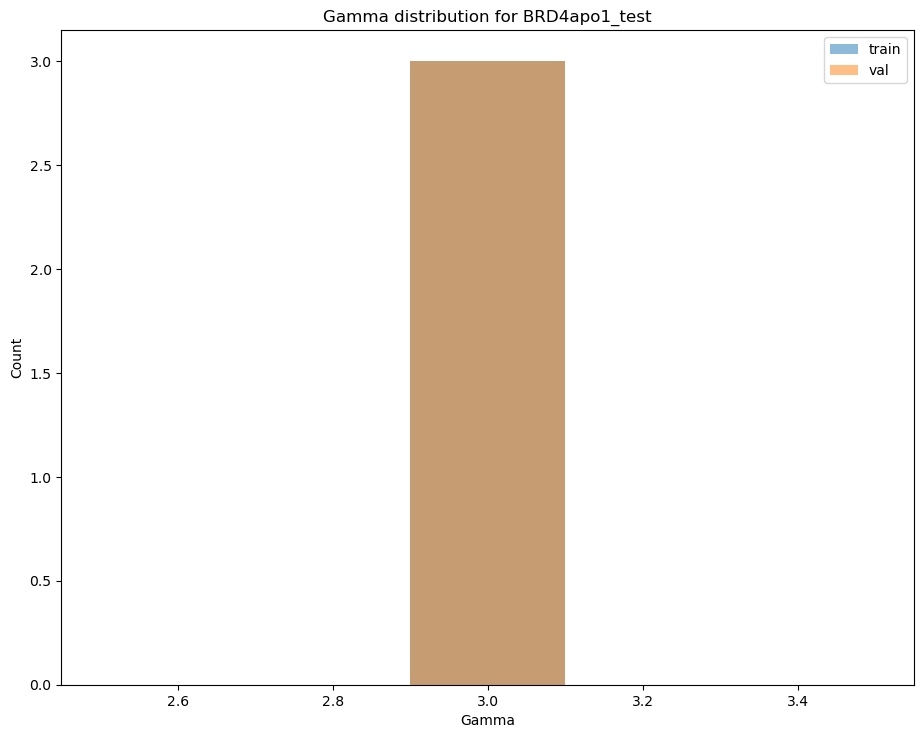

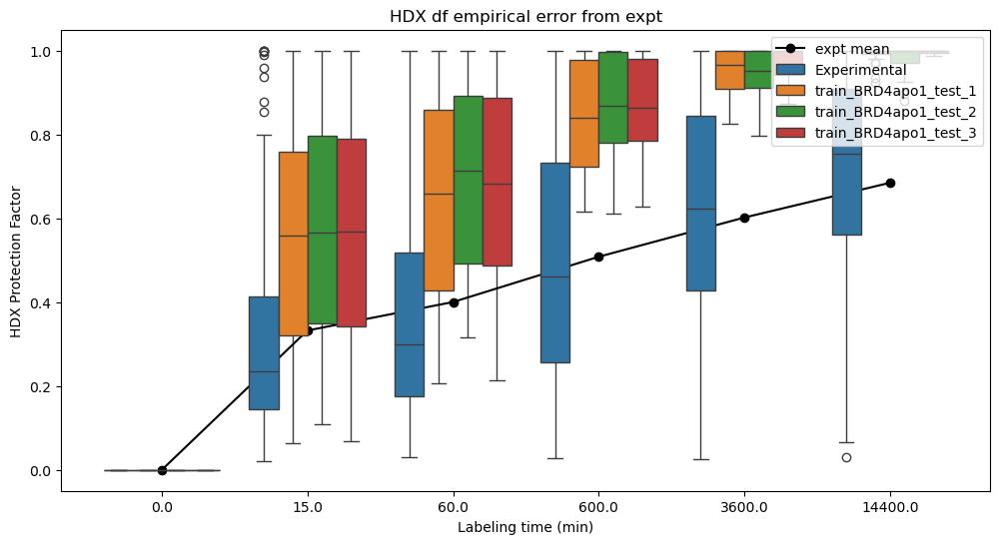

plotting dfracs compare for val
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0  14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.97437        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.89861        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.94989        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.96986        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.00000        4   
..   ...       ...       ...       ...       ...      ...      ...   
659  0.0  0.405890  0.596124  0.894356  0.994638  1.00000       99   
660  0.0  0.886296  0.954106  0.999959  1.000000  1.00000      100   
661  0.0  0.924844  0.957534  0.999955  1.000000  1.00000      101   
662  0.0  0.951369  0.972522  0.999971  1.000000  1.00000      102   
663  0.0  1.000000  1.000000  1.000000  1.000000  1.00000      103   

                calc_name  ResStr  ResEnd path  
0            Experimental     NaN     NaN  NaN  
1        

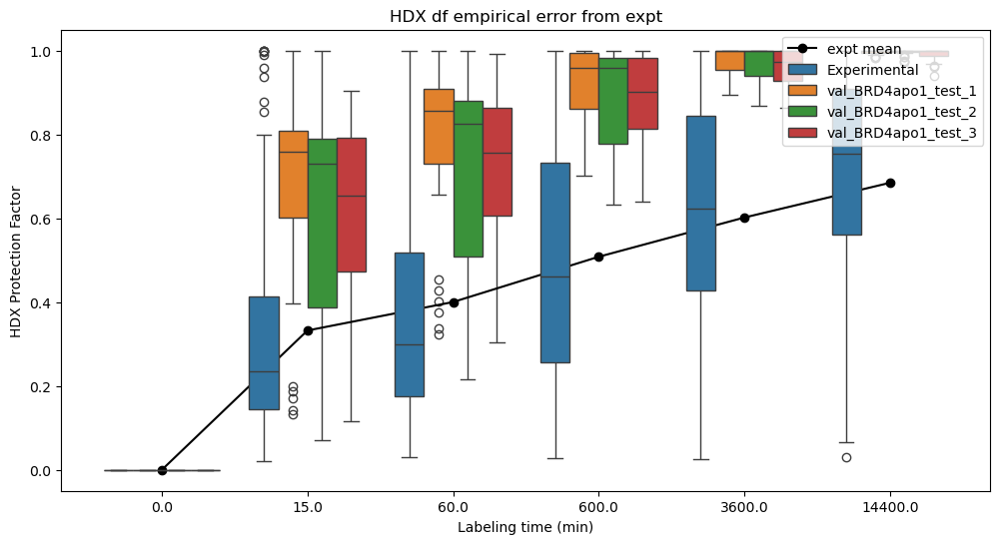

Restoring trainval peptide numbers
train_rep_names ['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
val_rep_names ['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
test_rep_names ['test_BRD4apo1_test_1', 'test_BRD4apo1_test_2', 'test_BRD4apo1_test_3']
train_rep_peptides [7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 78, 79, 80, 101, 102, 103]
val_rep_peptides [0, 1, 2, 3, 4, 5, 6, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 86, 87, 88, 89, 91, 92, 93, 94, 95, 97]
test_rep_peptides [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 8

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


plotting R agreement
plotting paired trainval agreement
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
347  0.0  0.536046  0.660004  0.834757  0.901554  0.961689       81   
348  0.0  0.509235  0.630654  0.825573  0.906655  0.963705       82   
349  0.0  0.537436  0.665334  0.867982  0.939254  0.973577       83   
350  0.0  0.446407  0.598401  0.841578  0.927105  0.968293       84   
351  0.0  0.116714  0.311519  0.703113  0.863322  0.940549       85   

               calc_name  ResStr  ResEnd  \
0           Experimental     NaN     NaN   
1  

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Cluster Centers
[[-346.4448    -463.76428  ]
 [ -68.76576    325.61127  ]
 [ 565.9419    -363.48132  ]
 [-454.72638     53.984337 ]
 [ 916.4123      72.807236 ]
 [ 445.59177    651.95886  ]
 [-182.4349      81.15973  ]
 [-123.98579   -321.98514  ]
 [ 371.593        2.8095691]
 [ 672.6724    -425.5231   ]
 [ 399.84482   -512.596    ]
 [ 212.98984    714.2521   ]
 [-363.018     -291.18536  ]
 [-210.4184     356.15158  ]
 [-103.008965    17.68101  ]
 [ 396.6139     381.04504  ]
 [  48.37358    409.03632  ]]
Getting cluster labels
(88,)
Unique labels
Final Cluster Weights
[0.68647316 7.41791599 1.03860983 1.55434323 0.24468164 0.22689322
 1.01074701 0.79934881 0.28943867 1.06267567 0.49170072 0.22925564
 0.5299424  0.42641442 0.71523647 0.12476736 0.15155577]
(17,)


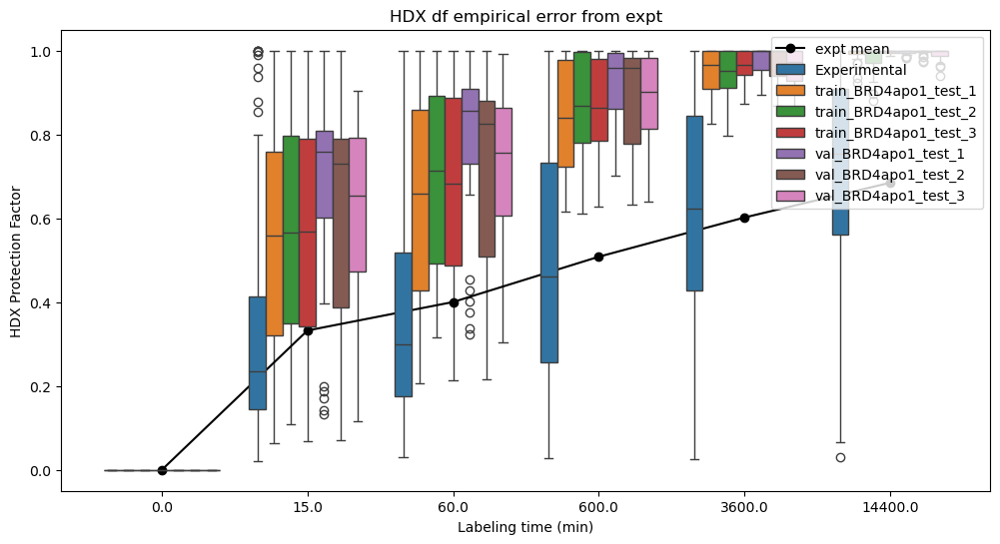

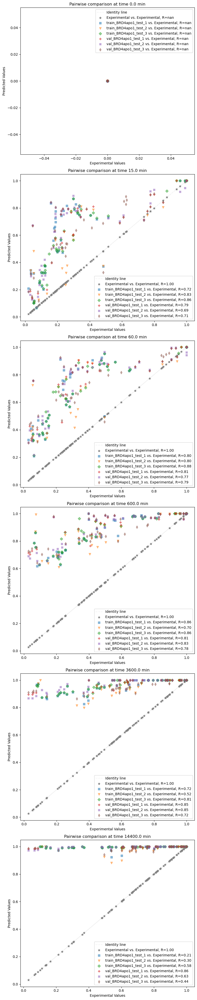

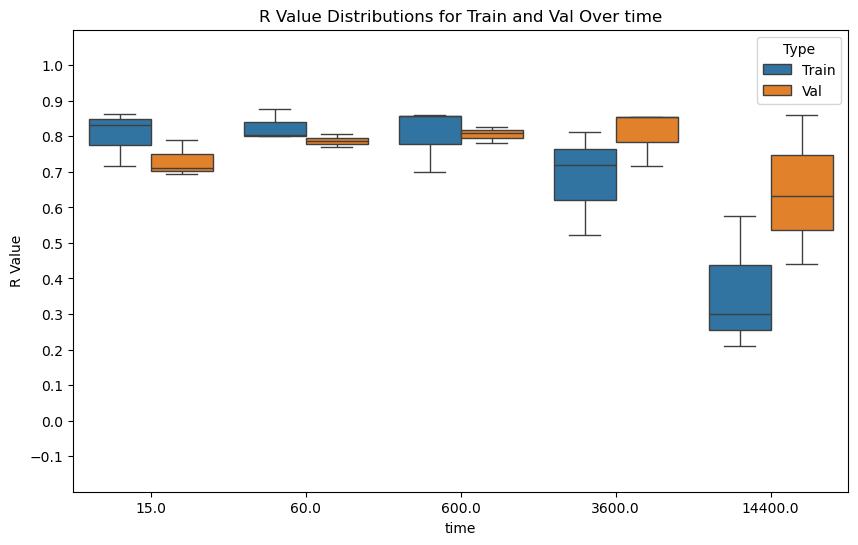

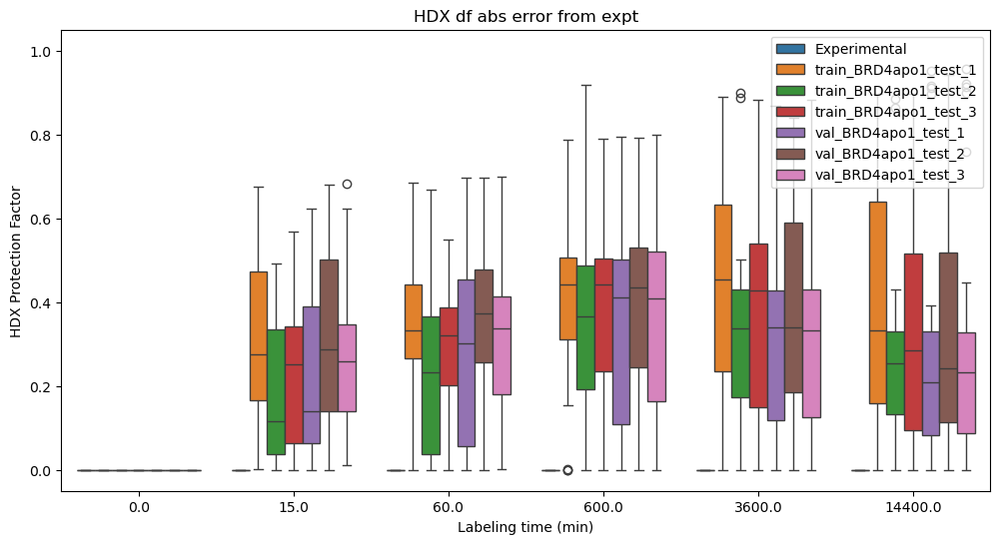

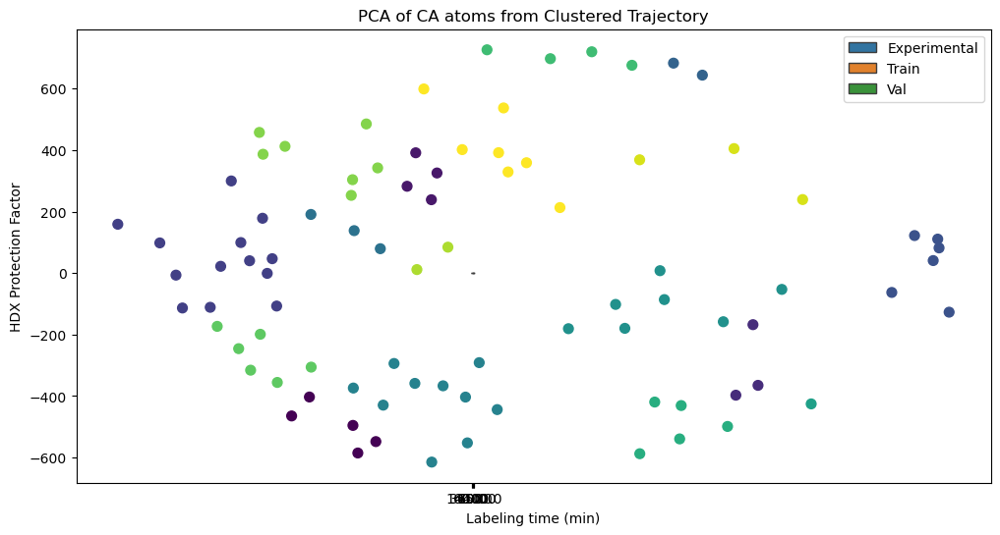

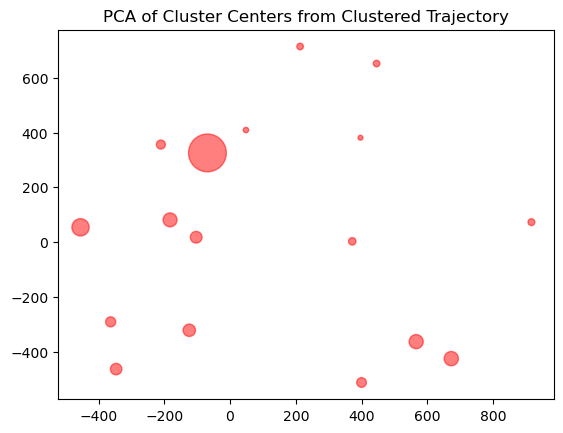

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/XDR.py:241: UserWarning: Reload offsets from trajectory
 ctime or size or n_atoms did not match
  warnings.warn("Reload offsets from trajectory\n "


(3, 4)
Running r split mode
envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
Experiment name r_naive_rando

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))


envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/r_naive_random_BRD4apo1_test2/train_BRD4apo1_test_1/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.5682906455039658, 2.492202619839238)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/r_naive_random_BRD4apo1_test2/train_BRD4apo1_test_1/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(52, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  0.00720  0.02623  0.11360  0.18753  0.27722        0
1  0.0  0.58838  0.68222  0.78634  0.88065  0.95326        1
2  0.0  0.36966  0.45844  0.70917  0.78658  0.81348        2
3  0.0  0.00130  0.00518  0.04929  0.22969  0.46505  

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_1
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_1
    ResStr  ResEnd  peptide                                               path
0        5      26        1  /home/alexi/Documents/ValDX/data/r_naive_rando...
1       12      26        2  /home/alexi/Documents/ValDX/data/r_naive_rando...
2       15      26        3  /home/alexi/Documents/ValDX/data/r_naive_rando...
3       41      65        6  /home/alexi/Documents/ValDX/data/r_naive_rando...
4       68      74        8  /home/alexi/Documents/ValDX/data/r_naive_rando...
5       78      88       13  /home/alexi/Documents/ValDX/data/r_naive_rando...
6       78      91       14  /home/alexi/Documents/ValDX/data/r_naive_rando...
7       82      88       17  /home/alexi/Documents/ValDX/data/r_naive_rando...
8       92      99       20  /home/alexi/Documents/ValDX/data/r_naive_rando...
9       92     102       21  /home/alexi/Documents/ValDX/data/r_naive_rando...
10      92     117       23  /home/alexi/Documents/ValDX/data/r_naive_rando...
11      93     102

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(232,)
[ 0.          0.          0.          0.          0.          0.
  0.0285091   0.49594497  0.14990238  0.3191797   0.29455114  0.38000377
  0.31774769  0.53231927  0.36161389  0.08218498  0.          0.
  0.          0.          0.95370776  1.69212421  2.37205796  6.03014955
  5.30830889 10.01430166 10.78308179 10.36839366  0.57959143  6.76474482
  4.01537098 10.41814143 12.43768204 16.70584514 17.9994422  16.59816472
 17.84129026 17.29579424 16.8708412  16.53696254 17.44522268 22.1012279
 19.25547899 13.06702262 14.88267508 17.31766189  5.14697934  7.82197239
 20.55541914 10.55828761 10.93389558 17.56126571 12.70911068  8.65654637
  9.42813524 18.0910272  11.58272772  8.72608517 10.31157277 10.536554
 12.32471337  8.7249207  15.15571929  9.60539676  6.92142229 11.48327861
 16.61951616  6.18194344  3.62769325 11.87512566 15.72922156 20.78351642
 20.55188749 18.84892806 21.39079388 17.80668771 17.45131505 23.944259
 21.69076974 13.41175873 10.54686432 11.771839

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar di

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.0285091   0.49594497  0.14990238
  0.3191797   0.29455114  0.38000377  0.31774769  0.53231927  0.36161389
  0.08218498  0.          0.          0.          0.          0.
  0.          0.          0.          0.03378812  0.03471954  0.
  0.09071805  0.14745411  0.70706258  1.24183221  1.07848771  0.95370776
  1.69212421  2.37205796  6.03014955  5.30830889 10.01430166 10.78308179
 10.36839366  0.57959143  6.76474482  4.01537098 10.41814143 12.43768204
 16.70584514 17.9994422  16.59816472 17.84129026 17.29579424 16.8708412
 18.70847726 19.83524267 16.53696254 17.44522268 22.1012279  19.25547899
 13.06702262 14.88267508 17.31766189 15.00240924  9.78285365 12.77982484
  5.14697934  7.82197239 20.55541914 10.55828761 10.93389558 17.56126571
 12.70911068  8.65654637  9.42813524 18.0910272  11.58272772  8.72608517
 10.31157277 10.536554   12.32471337  8.7249207  1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing train PDB to results/r_naive_random_BRD4apo1_test/train_1_r_naive_random_BRD4apo1_test_20240229-163628.pdb
Writing val PDB to results/r_naive_random_BRD4apo1_test/val_1_r_naive_random_BRD4apo1_test_20240229-163628.pdb
Randomly splitting segments for BRD4apo1_test with random seed 43 and train fraction 0.5
train_segs
    ResStr  ResEnd  peptide              calc_name
2       12      26        2  train_BRD4apo1_test_2
15      79      88       15  train_BRD4apo1_test_2
72     391     399       72  train_BRD4apo1_test_2
11      69      91       11  train_BRD4apo1_test_2
22      92     106       22  train_BRD4apo1_test_2
Saved train BRD4apo1_test_2 segments to /home/alexi/Documents/ValDX/data/r_naive_random_BRD4apo1_test2/train_BRD4apo1_test_2/train_residue_segs__BRD4apo1_test_.txt
Train Peptide numbers: [  0   1   2   5   6   8   9  10  11  12  13  14  15  18  19  20  22  23
  24  27  31  33  37  38  39  42  44  45  46  55  56  62  63  67  69  70
  71  72  80  81  82  86  88  89  9

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/r_naive_random_BRD4apo1_test2/train_BRD4apo1_test_2/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.5782022851264954, 2.5905878916468197)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/r_naive_random_BRD4apo1_test2/train_BRD4apo1_test_2/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(52, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  1.00000  1.00000  1.00000  1.00000  1.00000        0
1  0.0  0.17226  0.38540  0.70596  0.72845  0.76364        1
2  0.0  0.42456  0.46629  0.64859  0.78899  0.85424        2
3  0.0  0.22879  0.34856  0.55842  0.65462  0.71121 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_2
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_2
     ResStr  ResEnd  peptide  \
52       15      26        3   
53       27      40        4   
54       66      72        7   
55       79      91       16   
56       82      88       17   
57       92     102       21   
58       98     111       25   
59       98     117       26   
60      103     111       28   
61      103     113       29   
62      103     114       30   
63      103     117       32   
64      103     124       34   
65      103     125       35   
66      107     113       36   
67      114     124       40   
68      114     125       41   
69      125     131       43   
70      136     148       47   
71      138     148       48   
72      144     151       49   
73      148     155       50   
74      149     155       51   
75      149     156       52   
76      150     156       53   
77      157     172       54   
78      162     173       57   
79      165     172       58   
80      365     371       59   
81    

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(209,)
[ 0.32548716  0.29968845  0.38896052  0.32328958  0.54319196  0.36792085
  0.08361838  0.          0.          0.          0.          0.
  0.          0.          0.          0.03437743  0.03532509  0.
  0.09230028  0.15002588  0.71939457  1.26349118  1.09729777 19.08969293
 20.23611042 16.8803045  17.80440574 22.54161702 19.646235   13.2966021
  7.95839654 20.96717195 10.74243623 11.17783801 17.91178979 12.93077212
  8.80752645  9.59257271 18.44239832 11.78474376  8.93226146 10.54466118
 10.77356633 12.59291325  8.87709331 15.46346342  9.77292587  7.04790173
 11.77824283 16.96262232  6.28976361  3.69096437 12.08224145 16.00355719
 21.19924751 20.96357871 19.23259335 21.81879222 18.17217514 17.81060437
 24.4167927  22.124      13.70059357 10.78573211 11.99414179 15.55885768
 12.10693751 13.89749137 14.06534962 19.620774    7.99367601 14.57739472
 17.65751687 22.12842532 17.50235006 16.81584792 22.49742932 21.24848707
 18.67498441 13.61419444 17.09055316 10.59

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.02900633  0.50459482  0.15251685
  0.32548716  0.29968845  0.38896052  0.32328958  0.54319196  0.36792085
  0.08361838  0.          0.          0.          0.          0.
  0.          0.          0.          0.03437743  0.03532509  0.
  0.09230028  0.15002588  0.71939457  1.26349118  1.09729777  0.97034152
  1.7216368   2.41342936  6.13532227  5.40089188 10.18896255 10.97115108
 10.54923031  0.58970017  6.92567295  4.08540365 10.59984575 12.65460946
 16.99795482 18.36154471 16.88839633 18.2023599  17.6523711  17.2200064
 19.08969293 20.23611042 16.8803045  17.80440574 22.54161702 19.646235
 13.2966021  15.19716438 17.67462015 15.31805181  9.95515346 13.05763802
  5.23842419  7.95839654 20.96717195 10.74243623 11.17783801 17.91178979
 12.93077212  8.80752645  9.59257271 18.44239832 11.78474376  8.93226146
 10.54466118 10.77356633 12.59291325  8.87709331 15.

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/r_naive_random_BRD4apo1_test/val_2_r_naive_random_BRD4apo1_test_20240229-163706.pdb
Randomly splitting segments for BRD4apo1_test with random seed 44 and train fraction 0.5
train_segs
    ResStr  ResEnd  peptide              calc_name
88     426     448       88  train_BRD4apo1_test_3
39     107     118       39  train_BRD4apo1_test_3
92     430     445       92  train_BRD4apo1_test_3
7       66      72        7  train_BRD4apo1_test_3
98     442     453       98  train_BRD4apo1_test_3
Saved train BRD4apo1_test_3 segments to /home/alexi/Documents/ValDX/data/r_naive_random_BRD4apo1_test2/train_BRD4apo1_test_3/train_residue_segs__BRD4apo1_test_.txt
Train Peptide numbers: [  0   4   5   7   9  11  13  15  17  19  21  24  25  26  27  28  30  32
  33  37  38  39  40  42  43  46  47  48  54  58  60  62  64  66  68  69
  70  73  75  76  78  81  86  88  90  92  93  95  98 100 102 103]
Saved val BRD4apo1_test_3 segments to /home/alexi/Documents/ValDX/data/r_naive_rando

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/r_naive_random_BRD4apo1_test2/train_BRD4apo1_test_3/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.5669920456789637, 2.8417999553859783)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/r_naive_random_BRD4apo1_test2/train_BRD4apo1_test_3/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(52, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  0.15615  0.24599  0.40723  0.54063  0.63172        0
1  0.0  0.10361  0.18022  0.22667  0.33319  0.41533        1
2  0.0  0.23544  0.36009  0.50795  0.58076  0.64358        2
3  0.0  0.00393  0.01521  0.10568  0.19642  0.26730 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_3
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_3
     ResStr  ResEnd  peptide  \
104       5      26        1   
105      12      26        2   
106      15      26        3   
107      41      65        6   
108      68      74        8   
109      69      88       10   
110      75      91       12   
111      78      91       14   
112      79      91       16   
113      89     102       18   
114      92      99       20   
115      92     106       22   
116      92     117       23   
117     103     113       29   
118     103     116       31   
119     103     124       34   
120     103     125       35   
121     107     113       36   
122     114     125       41   
123     125     132       44   
124     126     132       45   
125     144     151       49   
126     148     155       50   
127     149     155       51   
128     149     156       52   
129     150     156       53   
130     158     172       55   
131     161     172       56   
132     162     173       57   
133   

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(223,)
[ 0.          0.          0.          0.          0.          0.
  0.02844395  0.49481169  0.14955984  0.32324168  0.29387807  0.39420309
  0.31702161  0.54137919  0.36078757  0.08199718  0.          0.
  0.          0.          0.95152845  1.68825754  2.36663757  6.01637007
  5.29617888  9.991418   10.75844139 10.34470086  0.57826701  7.02710614
  4.00619546 10.39433496 12.40926072 16.67246199 18.26995603 16.56502762
 18.12332836 17.61156391 17.18758194 16.85446622 17.7606509  22.40601669
 19.5667706  13.04800367 15.20395897 17.63338159 15.31737039  9.77133935
 13.10591395  5.14605846  7.80409841 20.85289978 10.53416088 11.25336235
 17.80731609 12.68006912  8.63676531  9.40659102 18.2815715  11.55626005
  9.05538834 10.63246161 10.85692872 12.64100198  8.7049834  15.40193278
  9.58344748  6.94288257 12.06958384 16.92599073  6.16781709  3.61940361
 11.84798983 15.69327874 21.08047584 20.8493762  19.16114867 21.69720608
 18.12128995 17.76672935 24.24483629 21.9

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar di

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.02844395  0.49481169  0.14955984
  0.32324168  0.29387807  0.39420309  0.31702161  0.54137919  0.36078757
  0.08199718  0.          0.          0.          0.          0.
  0.          0.          0.          0.03371091  0.03464021  0.
  0.09051076  0.14711717  0.70544688  1.2389945   1.07602326  0.95152845
  1.68825754  2.36663757  6.01637007  5.29617888  9.991418   10.75844139
 10.34470086  0.57826701  7.02710614  4.00619546 10.39433496 12.40926072
 16.67246199 18.26995603 16.56502762 18.12332836 17.61156391 17.18758194
 19.02101882 20.14520946 16.85446622 17.7606509  22.40601669 19.5667706
 13.04800367 15.20395897 17.63338159 15.31737039  9.77133935 13.10591395
  5.14605846  7.80409841 20.85289978 10.53416088 11.25336235 17.80731609
 12.68006912  8.63676531  9.40659102 18.2815715  11.55626005  9.05538834
 10.63246161 10.85692872 12.64100198  8.7049834  1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/r_naive_random_BRD4apo1_test/val_3_r_naive_random_BRD4apo1_test_20240229-163745.pdb
Finished running VDX loop
Evaluating HDX
plotting gamma distributions
['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
plotting dfracs compare for train
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
723  0.0  0.014508  0.052213  0.234709  0.475675  0.620007       99   
724  0.0  0.778182  0.819230  0.840570  0.870000  0

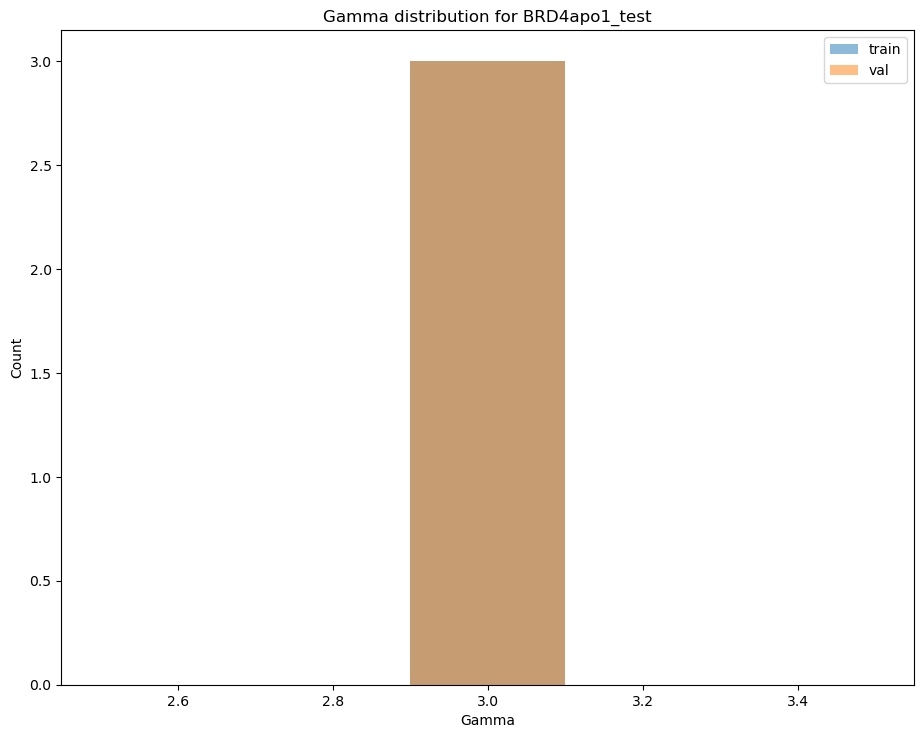

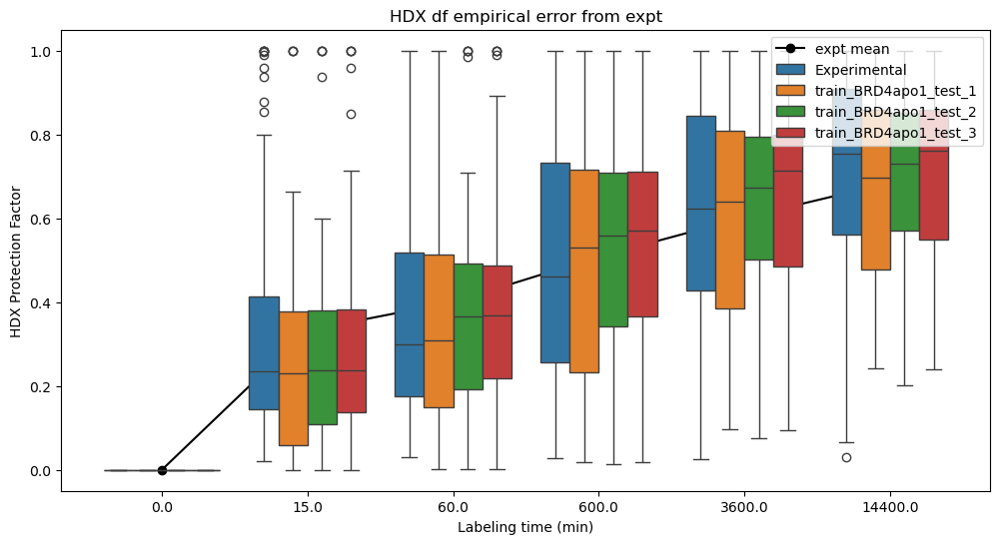

plotting dfracs compare for val
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
723  0.0  0.014508  0.052213  0.234709  0.475675  0.620007       99   
724  0.0  0.778182  0.819230  0.840570  0.870000  0.922628      100   
725  0.0  0.848745  0.892984  0.910024  0.914547  0.929028      101   
726  0.0  0.902129  0.930755  0.941780  0.944707  0.954077      102   
727  0.0  1.000000  1.000000  1.000000  1.000000  1.000000      103   

                calc_name  ResStr  ResEnd path  
0            Experimental     NaN     NaN  NaN

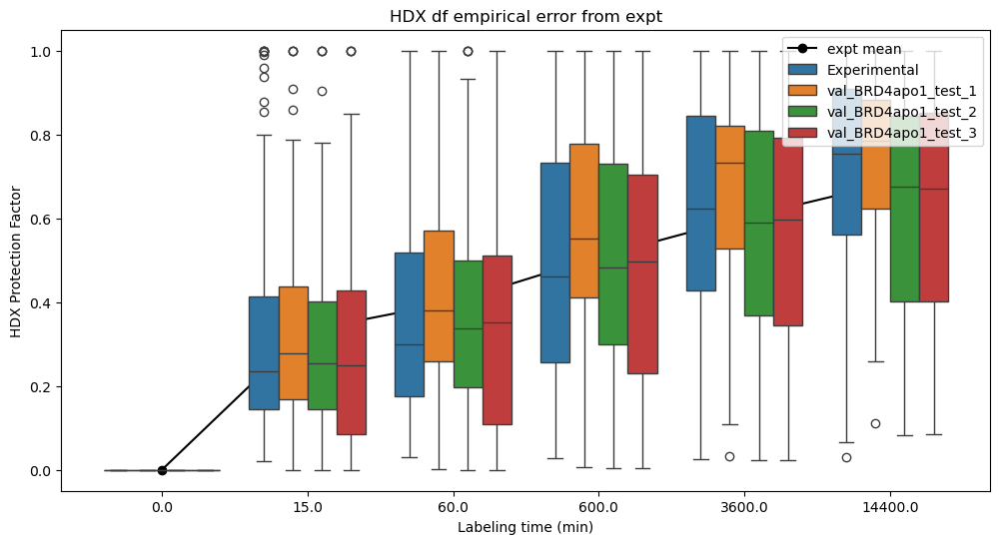

Restoring trainval peptide numbers
train_rep_names ['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
val_rep_names ['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
test_rep_names ['test_BRD4apo1_test_1', 'test_BRD4apo1_test_2', 'test_BRD4apo1_test_3']
train_rep_peptides [30, 65, 64, 53, 45, 93, 91, 47, 10, 0, 18, 31, 88, 95, 77, 4, 80, 33, 12, 26, 98, 55, 22, 76, 44, 72, 15, 42, 40, 9, 85, 11, 103, 78, 28, 79, 5, 62, 56, 39, 35, 16, 66, 34, 7, 43, 68, 69, 27, 19, 84, 25]
val_rep_peptides [1, 2, 3, 6, 8, 13, 14, 17, 20, 21, 23, 24, 29, 32, 36, 37, 38, 41, 46, 48, 49, 50, 51, 52, 54, 57, 58, 59, 60, 61, 63, 67, 70, 71, 73, 74, 75, 81, 82, 83, 86, 87, 89, 90, 92, 94, 96, 97, 99, 100, 101, 102]
test_rep_peptides [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


plotting R agreement
plotting paired trainval agreement
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
411  0.0  0.235455  0.360093  0.507954  0.580755  0.643579       94   
412  0.0  0.151285  0.242806  0.403861  0.540724  0.634599       96   
413  0.0  0.002090  0.008231  0.069009  0.204354  0.301658       97   
414  0.0  0.014508  0.052213  0.234709  0.475675  0.620007       99   
415  0.0  0.848745  0.892984  0.910024  0.914547  0.929028      101   

               calc_name  ResStr  ResEnd  \
0           Experimental     NaN     NaN   
1  

/home/alexi/Documents/ValDX/ValDX/ValidationDX.py:1358: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dump["name"] = [name]*len(dump)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:929: UserWarning: Reader has no dt information, set to 1.0 ps
  pickle.dump(self, f)


envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
Experiment name s_naive_sequential_BRD4apo1_test already 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))


envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/s_naive_sequential_BRD4apo1_test2/train_BRD4apo1_test_1/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.5356057745654667, 4.444618929194828)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/s_naive_sequential_BRD4apo1_test2/train_BRD4apo1_test_1/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(52, 7)
   0.0  15.0  60.0  600.0  3600.0  14400.0  peptide
0  0.0   1.0   1.0    1.0     1.0      1.0        0
1  0.0   1.0   1.0    1.0     1.0      1.0        1
2  0.0   1.0   1.0    1.0     1.0      1.0        2
3  0.0   1.0   1.0    1.0     1.0      1.0        3
4  0.0   1.0   1.0    1.0    

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_1
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_1
    ResStr  ResEnd  peptide                                               path
0      149     156       52  /home/alexi/Documents/ValDX/data/s_naive_seque...
1      150     156       53  /home/alexi/Documents/ValDX/data/s_naive_seque...
2      157     172       54  /home/alexi/Documents/ValDX/data/s_naive_seque...
3      158     172       55  /home/alexi/Documents/ValDX/data/s_naive_seque...
4      161     172       56  /home/alexi/Documents/ValDX/data/s_naive_seque...
5      162     173       57  /home/alexi/Documents/ValDX/data/s_naive_seque...
6      165     172       58  /home/alexi/Documents/ValDX/data/s_naive_seque...
7      365     371       59  /home/alexi/Documents/ValDX/data/s_naive_seque...
8      365     381       60  /home/alexi/Documents/ValDX/data/s_naive_seque...
9      369     381       61  /home/alexi/Documents/ValDX/data/s_naive_seque...
10     372     378       62  /home/alexi/Documents/ValDX/data/s_naive_seque...
11     372     381

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(125,)
[19.9122295  25.61511242 21.21240844 17.03246856 21.27979325 19.37708992
 16.71538759 15.66902872 18.44565797 16.32878143 15.71969755 17.95879443
 20.1499097  11.61437868 12.27783355 13.88120152  3.89022792  4.92274666
  6.11467608 13.77587389  8.5119092  12.35089897  1.84984847  1.93610704
 17.29651325 17.70175908  5.417741    2.97026925 14.55484677 14.77015064
  7.88209183 11.93295734 19.97802352 11.99236587 11.67864193 18.43656567
 12.21450263  5.87177454  5.68914087  9.59600519  5.93669444  9.45378866
 11.87070537  8.3772313  15.06438168  6.20637501  7.52632774 15.61520622
  9.8377177   7.24462246 13.34771093 18.57463586  7.7691468   4.17431389
 11.41156836 14.93785192 22.24506721 18.95559906 15.87306371 21.40625787
 19.92626396 16.20145722 20.01934409 23.55562881 13.14938725 10.95806095
 11.38359179 12.69544711  9.32149584 11.86661502  8.14072064 15.19415538
  6.65936103 15.0973794  17.5924449  23.21007561 19.4063397  18.69808942
 23.72877198 19.48621893 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.02686941  0.46742102  0.14128084
  0.32908483  0.27761023  0.44702733  0.29947264  0.56231995  0.3408159
  0.07745816  0.          0.          0.          0.          0.
  0.          0.          0.          0.03184482  0.03272267  0.
  0.08550046  0.13897339  0.66639633  1.17040902  1.01645918  0.89885587
  1.59480278  2.23563057  5.68332938  5.00300492  9.43833554 10.16289978
  9.77206216  0.5462566   8.01444148  3.7844295   9.81894873 11.72233676
 15.77328175 18.80250458 15.6717945  18.71929481 18.3967915  17.99627936
 19.72822496 20.79018519 17.68160351 18.53762566 22.92584373 20.24376624
 12.37942566 16.12246133 18.41740144 16.19962717  9.28414356 14.14055517
  4.91489858  7.37209668 21.40499673  9.95103449 12.33684891 18.23932131
 11.97815435  8.15867067  8.8858821  18.41834229 10.91655459 10.28428184
 11.7503186  11.96236017 13.6476747   8.2231125  1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/s_naive_sequential_BRD4apo1_test/val_1_s_naive_sequential_BRD4apo1_test_20240229-163827.pdb
Splitting segments for BRD4apo1_test by N-terminal and C-terminal
train_segs
   ResStr  ResEnd  peptide              calc_name
0       1      26        0  train_BRD4apo1_test_2
1       5      26        1  train_BRD4apo1_test_2
2      12      26        2  train_BRD4apo1_test_2
3      15      26        3  train_BRD4apo1_test_2
4      27      40        4  train_BRD4apo1_test_2
Saved train BRD4apo1_test_2 segments to /home/alexi/Documents/ValDX/data/s_naive_sequential_BRD4apo1_test2/train_BRD4apo1_test_2/train_residue_segs__BRD4apo1_test_.txt
Train Peptide numbers: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51]
Saved val BRD4apo1_test_2 segments to /home/alexi/Documents/ValDX/data/s_naive_sequential_BRD4apo1_test2/val_BRD4apo1_test_2/val_residue_segs__BRD4apo1_t

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/s_naive_sequential_BRD4apo1_test2/train_BRD4apo1_test_2/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.5356057745654667, 4.444618929194828)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/s_naive_sequential_BRD4apo1_test2/train_BRD4apo1_test_2/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(52, 7)
   0.0  15.0  60.0  600.0  3600.0  14400.0  peptide
0  0.0   1.0   1.0    1.0     1.0      1.0        0
1  0.0   1.0   1.0    1.0     1.0      1.0        1
2  0.0   1.0   1.0    1.0     1.0      1.0        2
3  0.0   1.0   1.0    1.0     1.0      1.0        3
4  0.0   1.0   1.0    1.0    

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_2
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar di

Recalculating val_BRD4apo1_test_2
     ResStr  ResEnd  peptide  \
52      149     156       52   
53      150     156       53   
54      157     172       54   
55      158     172       55   
56      161     172       56   
57      162     173       57   
58      165     172       58   
59      365     371       59   
60      365     381       60   
61      369     381       61   
62      372     378       62   
63      372     381       63   
64      372     383       64   
65      382     390       65   
66      382     392       66   
67      383     390       67   
68      384     390       68   
69      389     399       69   
70      389     407       70   
71      390     399       71   
72      391     399       72   
73      391     400       73   
74      391     404       74   
75      391     406       75   
76      391     407       76   
77      391     410       77   
78      400     406       78   
79      400     407       79   
80      401     407       80   
81    

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(125,)
[19.9122295  25.61511242 21.21240844 17.03246856 21.27979325 19.37708992
 16.71538759 15.66902872 18.44565797 16.32878143 15.71969755 17.95879443
 20.1499097  11.61437868 12.27783355 13.88120152  3.89022792  4.92274666
  6.11467608 13.77587389  8.5119092  12.35089897  1.84984847  1.93610704
 17.29651325 17.70175908  5.417741    2.97026925 14.55484677 14.77015064
  7.88209183 11.93295734 19.97802352 11.99236587 11.67864193 18.43656567
 12.21450263  5.87177454  5.68914087  9.59600519  5.93669444  9.45378866
 11.87070537  8.3772313  15.06438168  6.20637501  7.52632774 15.61520622
  9.8377177   7.24462246 13.34771093 18.57463586  7.7691468   4.17431389
 11.41156836 14.93785192 22.24506721 18.95559906 15.87306371 21.40625787
 19.92626396 16.20145722 20.01934409 23.55562881 13.14938725 10.95806095
 11.38359179 12.69544711  9.32149584 11.86661502  8.14072064 15.19415538
  6.65936103 15.0973794  17.5924449  23.21007561 19.4063397  18.69808942
 23.72877198 19.48621893 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.02686941  0.46742102  0.14128084
  0.32908483  0.27761023  0.44702733  0.29947264  0.56231995  0.3408159
  0.07745816  0.          0.          0.          0.          0.
  0.          0.          0.          0.03184482  0.03272267  0.
  0.08550046  0.13897339  0.66639633  1.17040902  1.01645918  0.89885587
  1.59480278  2.23563057  5.68332938  5.00300492  9.43833554 10.16289978
  9.77206216  0.5462566   8.01444148  3.7844295   9.81894873 11.72233676
 15.77328175 18.80250458 15.6717945  18.71929481 18.3967915  17.99627936
 19.72822496 20.79018519 17.68160351 18.53762566 22.92584373 20.24376624
 12.37942566 16.12246133 18.41740144 16.19962717  9.28414356 14.14055517
  4.91489858  7.37209668 21.40499673  9.95103449 12.33684891 18.23932131
 11.97815435  8.15867067  8.8858821  18.41834229 10.91655459 10.28428184
 11.7503186  11.96236017 13.6476747   8.2231125  1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/s_naive_sequential_BRD4apo1_test/val_2_s_naive_sequential_BRD4apo1_test_20240229-163905.pdb
Splitting segments for BRD4apo1_test by N-terminal and C-terminal
train_segs
   ResStr  ResEnd  peptide              calc_name
0       1      26        0  train_BRD4apo1_test_3
1       5      26        1  train_BRD4apo1_test_3
2      12      26        2  train_BRD4apo1_test_3
3      15      26        3  train_BRD4apo1_test_3
4      27      40        4  train_BRD4apo1_test_3
Saved train BRD4apo1_test_3 segments to /home/alexi/Documents/ValDX/data/s_naive_sequential_BRD4apo1_test2/train_BRD4apo1_test_3/train_residue_segs__BRD4apo1_test_.txt
Train Peptide numbers: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51]
Saved val BRD4apo1_test_3 segments to /home/alexi/Documents/ValDX/data/s_naive_sequential_BRD4apo1_test2/val_BRD4apo1_test_3/val_residue_segs__BRD4apo1_t

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/s_naive_sequential_BRD4apo1_test2/train_BRD4apo1_test_3/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.5356057745654667, 4.444618929194828)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/s_naive_sequential_BRD4apo1_test2/train_BRD4apo1_test_3/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(52, 7)
   0.0  15.0  60.0  600.0  3600.0  14400.0  peptide
0  0.0   1.0   1.0    1.0     1.0      1.0        0
1  0.0   1.0   1.0    1.0     1.0      1.0        1
2  0.0   1.0   1.0    1.0     1.0      1.0        2
3  0.0   1.0   1.0    1.0     1.0      1.0        3
4  0.0   1.0   1.0    1.0    

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_3
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_3
     ResStr  ResEnd  peptide  \
104     149     156       52   
105     150     156       53   
106     157     172       54   
107     158     172       55   
108     161     172       56   
109     162     173       57   
110     165     172       58   
111     365     371       59   
112     365     381       60   
113     369     381       61   
114     372     378       62   
115     372     381       63   
116     372     383       64   
117     382     390       65   
118     382     392       66   
119     383     390       67   
120     384     390       68   
121     389     399       69   
122     389     407       70   
123     390     399       71   
124     391     399       72   
125     391     400       73   
126     391     404       74   
127     391     406       75   
128     391     407       76   
129     391     410       77   
130     400     406       78   
131     400     407       79   
132     401     407       80   
133   

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar di

LogPf_by_res shape
(125,)
[19.9122295  25.61511242 21.21240844 17.03246856 21.27979325 19.37708992
 16.71538759 15.66902872 18.44565797 16.32878143 15.71969755 17.95879443
 20.1499097  11.61437868 12.27783355 13.88120152  3.89022792  4.92274666
  6.11467608 13.77587389  8.5119092  12.35089897  1.84984847  1.93610704
 17.29651325 17.70175908  5.417741    2.97026925 14.55484677 14.77015064
  7.88209183 11.93295734 19.97802352 11.99236587 11.67864193 18.43656567
 12.21450263  5.87177454  5.68914087  9.59600519  5.93669444  9.45378866
 11.87070537  8.3772313  15.06438168  6.20637501  7.52632774 15.61520622
  9.8377177   7.24462246 13.34771093 18.57463586  7.7691468   4.17431389
 11.41156836 14.93785192 22.24506721 18.95559906 15.87306371 21.40625787
 19.92626396 16.20145722 20.01934409 23.55562881 13.14938725 10.95806095
 11.38359179 12.69544711  9.32149584 11.86661502  8.14072064 15.19415538
  6.65936103 15.0973794  17.5924449  23.21007561 19.4063397  18.69808942
 23.72877198 19.48621893 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.02686941  0.46742102  0.14128084
  0.32908483  0.27761023  0.44702733  0.29947264  0.56231995  0.3408159
  0.07745816  0.          0.          0.          0.          0.
  0.          0.          0.          0.03184482  0.03272267  0.
  0.08550046  0.13897339  0.66639633  1.17040902  1.01645918  0.89885587
  1.59480278  2.23563057  5.68332938  5.00300492  9.43833554 10.16289978
  9.77206216  0.5462566   8.01444148  3.7844295   9.81894873 11.72233676
 15.77328175 18.80250458 15.6717945  18.71929481 18.3967915  17.99627936
 19.72822496 20.79018519 17.68160351 18.53762566 22.92584373 20.24376624
 12.37942566 16.12246133 18.41740144 16.19962717  9.28414356 14.14055517
  4.91489858  7.37209668 21.40499673  9.95103449 12.33684891 18.23932131
 11.97815435  8.15867067  8.8858821  18.41834229 10.91655459 10.28428184
 11.7503186  11.96236017 13.6476747   8.2231125  1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/s_naive_sequential_BRD4apo1_test/val_3_s_naive_sequential_BRD4apo1_test_20240229-163944.pdb
Finished running VDX loop
Evaluating HDX
plotting gamma distributions
['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
plotting dfracs compare for train
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
723  0.0  0.005315  0.020542  0.144709  0.367845  0.565874       99   
724  0.0  0.749202  0.785096  0.836243  0.8

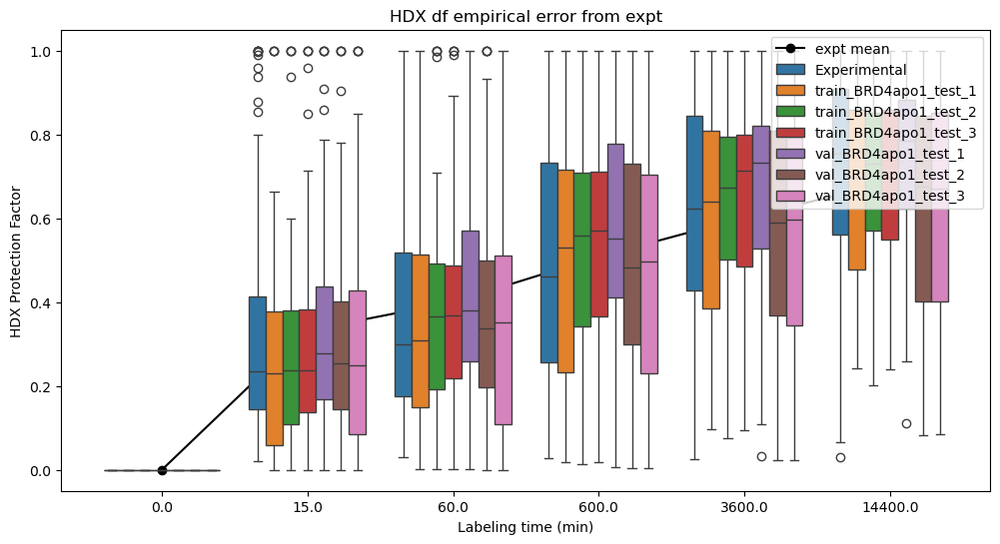

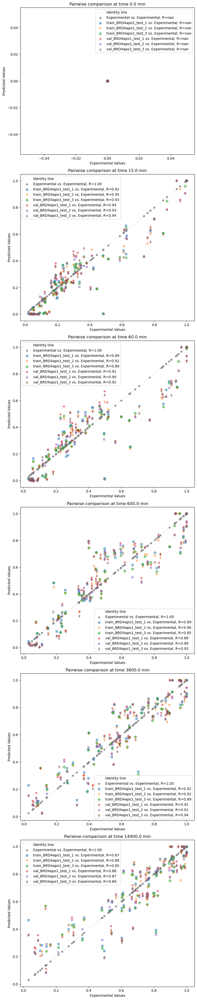

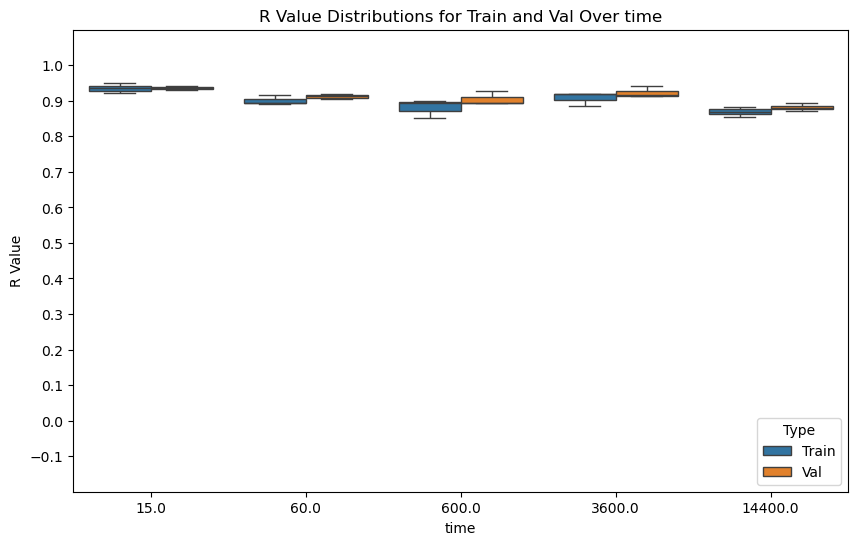

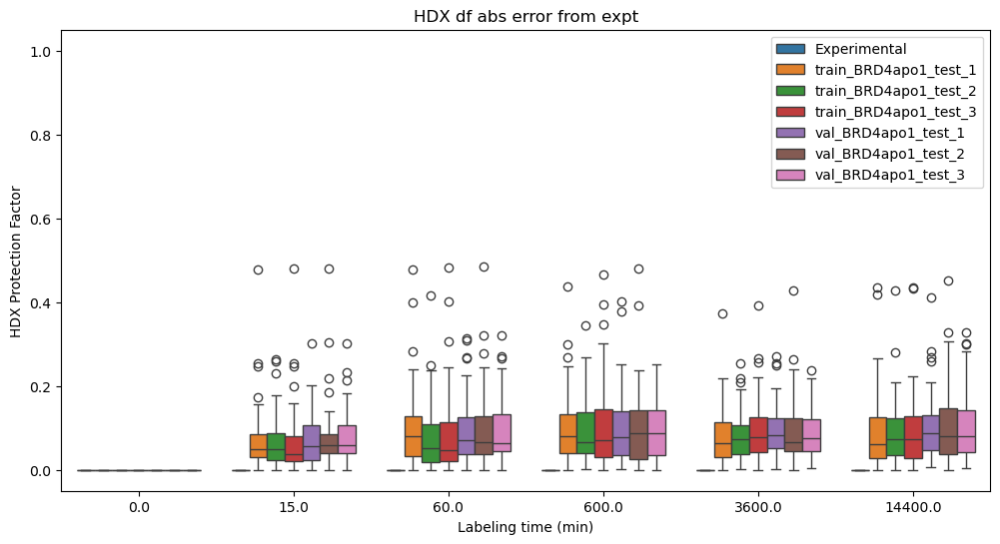

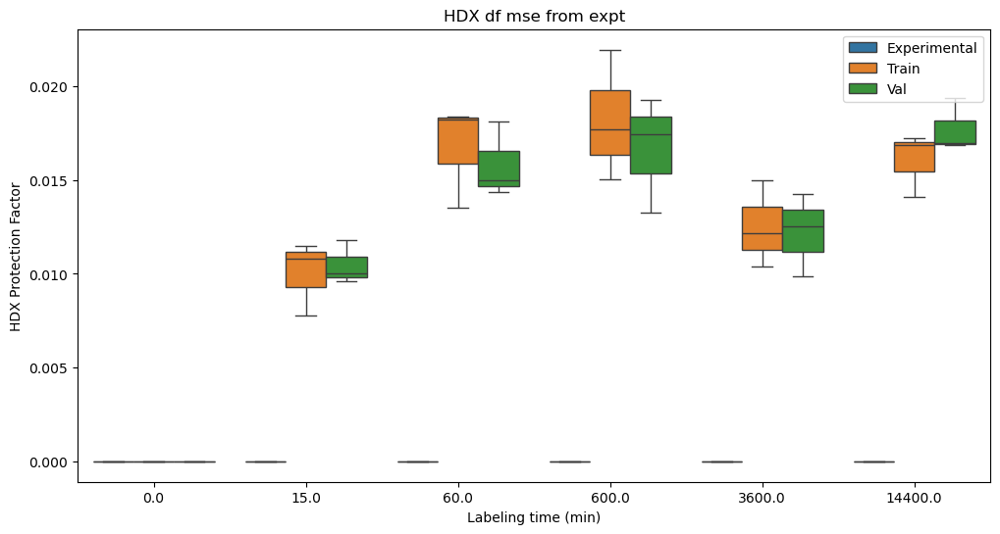

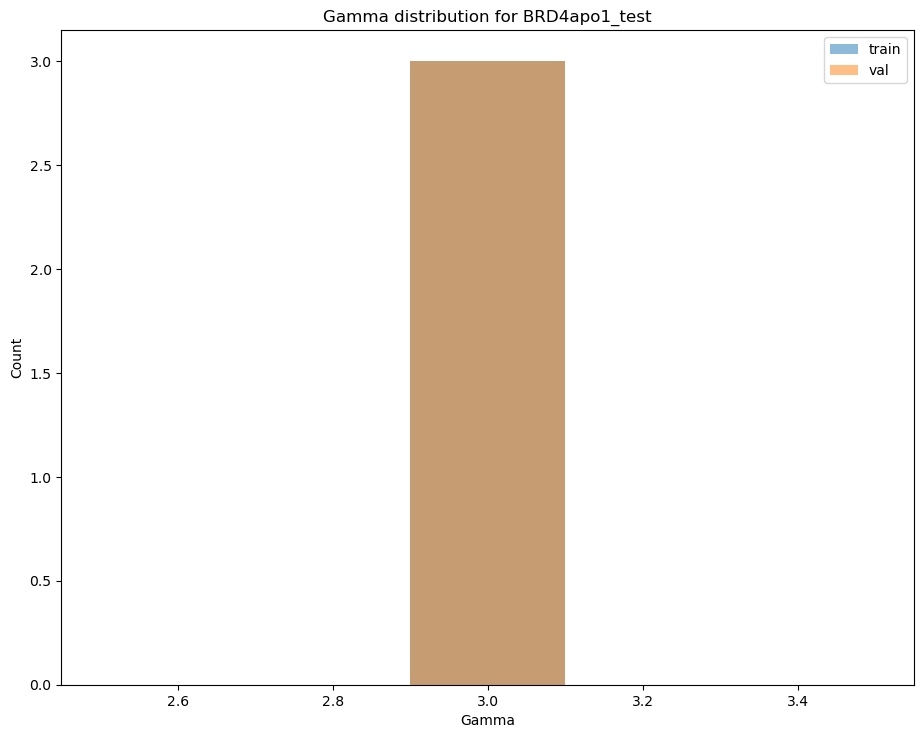

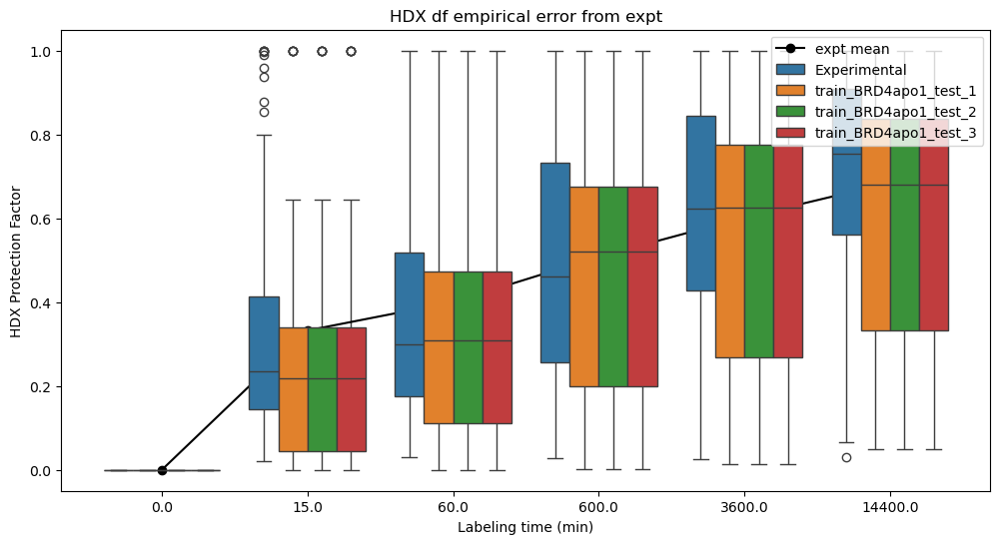

plotting dfracs compare for val
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
723  0.0  0.005315  0.020542  0.144709  0.367845  0.565874       99   
724  0.0  0.749202  0.785096  0.836243  0.851584  0.889991      100   
725  0.0  0.817232  0.856148  0.909120  0.911685  0.919031      101   
726  0.0  0.881738  0.906919  0.941195  0.942855  0.947609      102   
727  0.0  1.000000  1.000000  1.000000  1.000000  1.000000      103   

                calc_name  ResStr  ResEnd path  
0            Experimental     NaN     NaN  NaN

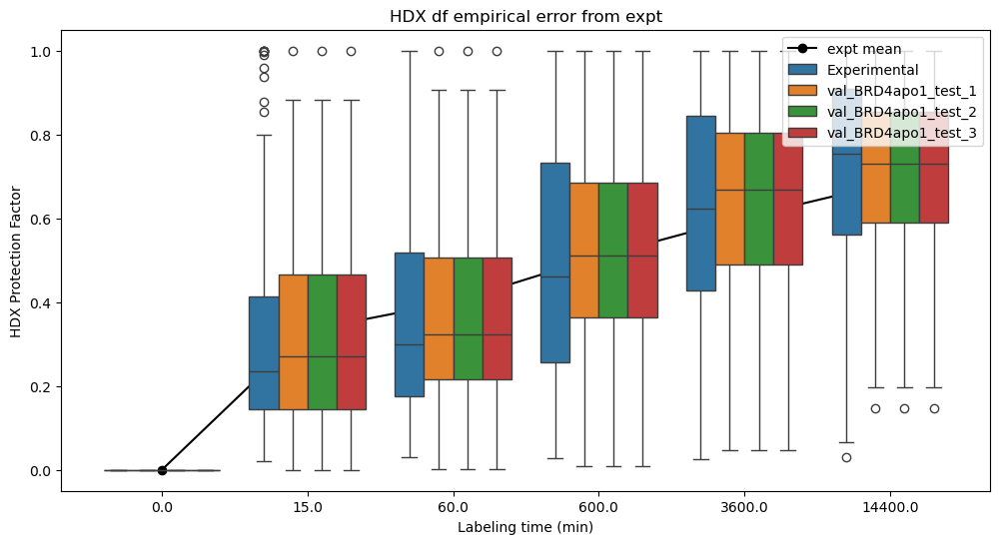

Restoring trainval peptide numbers
train_rep_names ['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
val_rep_names ['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
test_rep_names ['test_BRD4apo1_test_1', 'test_BRD4apo1_test_2', 'test_BRD4apo1_test_3']
train_rep_peptides [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51]
val_rep_peptides [52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103]
test_rep_peptides [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


plotting R agreement
plotting paired trainval agreement
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
411  0.0  0.005315  0.020542  0.144709  0.367845  0.565874       99   
412  0.0  0.749202  0.785096  0.836243  0.851584  0.889991      100   
413  0.0  0.817232  0.856148  0.909120  0.911685  0.919031      101   
414  0.0  0.881738  0.906919  0.941195  0.942855  0.947609      102   
415  0.0  1.000000  1.000000  1.000000  1.000000  1.000000      103   

               calc_name  ResStr  ResEnd  \
0           Experimental     NaN     NaN   
1  

/home/alexi/Documents/ValDX/ValDX/ValidationDX.py:1358: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dump["name"] = [name]*len(dump)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:929: UserWarning: Reader has no dt information, set to 1.0 ps
  pickle.dump(self, f)


envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
Experiment name R3_k_sequence_BRD4apo1_test already exist

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test4/train_BRD4apo1_test_1/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.5891546719143245, 2.1133410249960725)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test4/train_BRD4apo1_test_1/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(45, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  0.00251  0.00984  0.07853  0.19680  0.28067        0
1  0.0  0.00354  0.01390  0.11422  0.30915  0.38564        1
2  0.0  0.16587  0.24140  0.40260  0.56500  0.65477        2
3  0.0  0.21116  0.33956  0.56156  0.65839  0.72139   

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_1
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_1
    ResStr  ResEnd  peptide                                               path
0        1      26        0  /home/alexi/Documents/ValDX/data/R3_k_sequence...
1        5      26        1  /home/alexi/Documents/ValDX/data/R3_k_sequence...
2       12      26        2  /home/alexi/Documents/ValDX/data/R3_k_sequence...
3       15      26        3  /home/alexi/Documents/ValDX/data/R3_k_sequence...
4       27      40        4  /home/alexi/Documents/ValDX/data/R3_k_sequence...
5       41      63        5  /home/alexi/Documents/ValDX/data/R3_k_sequence...
6       41      65        6  /home/alexi/Documents/ValDX/data/R3_k_sequence...
7      138     148       48  /home/alexi/Documents/ValDX/data/R3_k_sequence...
8      144     151       49  /home/alexi/Documents/ValDX/data/R3_k_sequence...
9      148     155       50  /home/alexi/Documents/ValDX/data/R3_k_sequence...
10     149     155       51  /home/alexi/Documents/ValDX/data/R3_k_sequence...
11     149     156

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(126,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.02955577  0.51415292  0.15540584
  0.32455486  0.30536519  0.37400753  0.32941337  0.53825818  0.37489006
  0.08520229  0.          0.          0.          0.          0.
  0.          0.          0.          0.03502861  0.03599423  0.
  0.09404865  0.15286769  0.73302144  1.2874244   1.11808293  0.98872186
  1.75424828  2.45914487  6.25153838  5.50319631 10.38196328 11.17896813
 10.74905528  0.60087035  6.64530755  4.16278992 10.80062948 12.8943148
 17.31283468 18.24769207 17.20120091 18.06895566 17.46042659 17.01987198
 10.27328523 11.6452808  11.68526827 10.77397938  7.62922472 13.18688038
  5.96500282  8.07315921 18.50319937 16.73214367 19.1746329  25.4004222
 20.55754383 15.95970112 20.63166565 18.53873348 15.61091897 14.45994702
 17.51417864 15.18566062 14.51568163 16.93868943 19.38881838 10.17342676
 10.72970628 12.54063364  4.27916588  5.41491397  6

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.02955577  0.51415292  0.15540584
  0.32455486  0.30536519  0.37400753  0.32941337  0.53825818  0.37489006
  0.08520229  0.          0.          0.          0.          0.
  0.          0.          0.          0.03502861  0.03599423  0.
  0.09404865  0.15286769  0.73302144  1.2874244   1.11808293  0.98872186
  1.75424828  2.45914487  6.25153838  5.50319631 10.38196328 11.17896813
 10.74905528  0.60087035  6.64530755  4.16278992 10.80062948 12.8943148
 17.31283468 18.24769207 17.20120091 18.06895566 17.46042659 17.01987198
 18.92497437 20.09310746 16.67373541 17.6153411  22.44228528 19.49205853
 13.53240943 14.95871301 17.48309708 15.09085129 10.12766662 12.77865945
  5.32159242  8.10914558 20.85407558 10.94592093 10.87931073 17.82714044
 13.17570858  8.97435982  9.77427654 18.44823141 12.00797198  8.58410044
 10.23414017 10.46738128 12.32119052  9.04524442 1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/R3_k_sequence_BRD4apo1_test/val_1_R3_k_sequence_BRD4apo1_test_20240229-164022.pdb
Splitting segments for BRD4apo1_test by redundancy mk III
centrality
1    1375
Name: count, dtype: int64
Residue intersection:  [118 119 120 121 122 123 124 125 144 145 146 147 148 389 390 391 392 453]
Intersection peptides:  [ 33  34  35  39  40  41  42  43  44  47  48  49  50  65  66  67  68  69
  70  71  72  73  74  75  76  77  90  96  98  99 100]
0.2980769230769231
Train peptides:  [ 0  1  2  3  4  5  6 45 46 78 79 80 81 82 83 84 85 86 87 88 89 91 92 93
 94 95 97]
0.25961538461538464
Val peptides:  [  7   8   9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24
  25  26  27  28  29  30  31  32  36  37  38  51  52  53  54  55  56  57
  58  59  60  61  62  63  64 101 102 103]
0.4423076923076923
train_segs
   ResStr  ResEnd  peptide              calc_name
0       1      26        0  train_BRD4apo1_test_2
1       5      26        1  train_BRD4apo1_test_2
2      12      

/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_segs["calc_name"] = val_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:748: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test4/train_BRD4apo1_test_2/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.4154787364973567, 6.433601133891299)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test4/train_BRD4apo1_test_2/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(27, 7)
   0.0  15.0  60.0  600.0  3600.0  14400.0  peptide
0  0.0   1.0   1.0    1.0     1.0      1.0        0
1  0.0   1.0   1.0    1.0     1.0      1.0        1
2  0.0   1.0   1.0    1.0     1.0      1.0        2
3  0.0   1.0   1.0    1.0     1.0      1.0        3
4  0.0   1.0   1.0    1.0     1.0      

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_2
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_2
    ResStr  ResEnd  peptide                                               path
34      66      72        7  /home/alexi/Documents/ValDX/data/R3_k_sequence...
35      68      74        8  /home/alexi/Documents/ValDX/data/R3_k_sequence...
36      69      78        9  /home/alexi/Documents/ValDX/data/R3_k_sequence...
37      69      88       10  /home/alexi/Documents/ValDX/data/R3_k_sequence...
38      69      91       11  /home/alexi/Documents/ValDX/data/R3_k_sequence...
39      75      91       12  /home/alexi/Documents/ValDX/data/R3_k_sequence...
40      78      88       13  /home/alexi/Documents/ValDX/data/R3_k_sequence...
41      78      91       14  /home/alexi/Documents/ValDX/data/R3_k_sequence...
42      79      88       15  /home/alexi/Documents/ValDX/data/R3_k_sequence...
43      79      91       16  /home/alexi/Documents/ValDX/data/R3_k_sequence...
44      82      88       17  /home/alexi/Documents/ValDX/data/R3_k_sequence...
45      89     102

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(106,)
[18.28936077 19.11314183 16.70176084 17.36579213 20.76980939 18.68927513
  9.69403832 15.49230707 17.27253212 15.50132975  7.29297404 13.9549079
  3.90367453  5.71866391 19.49895983  7.71919093 12.46463949 16.55357778
  9.29166315  6.32882307  6.89293365 16.23615461  8.4681617  10.91269326
 12.0096577  12.17414204 13.48146991  6.37881172 14.72564628  7.02253
  5.54410164 16.34604132 16.62141115  4.51963457  2.65221576  8.68193458
 11.49967389 19.66572234 19.49637784 18.39204471 20.25040927 17.63006014
 17.37024628 22.11725412 20.46972239 14.41691638 12.32238479 10.03289978
 18.3812601  22.855922   19.44066777 16.19821554 19.49293934 18.0169792
 15.9522503  15.14057148 17.2944512  15.65235317 15.17987618 16.95975786
 18.61646897 11.80866336 12.50996227 13.70288656  3.01771762  3.8186604
  4.78352665 13.30791573  6.64310218 12.20253784  1.4349597   1.54213781
 15.52533042 16.71739586  4.52647287  2.30408964 13.91217857 14.07919353
  6.11427604 11.87833323 18.298

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 2.08430733e-02 3.62586631e-01 1.09594011e-01
 2.95542664e-01 2.15347091e-01 4.73393667e-01 2.32306147e-01
 5.22562335e-01 2.64376838e-01 6.00856450e-02 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 2.47025818e-02
 2.53835472e-02 0.00000000e+00 6.63242006e-02 1.07804078e-01
 5.16935254e-01 9.07906684e-01 7.88485105e-01 6.97258171e-01
 1.23711632e+00 1.73421761e+00 4.40865768e+00 3.88091813e+00
 7.32148142e+00 7.88353853e+00 7.58035898e+00 4.23740771e-01
 8.55170244e+00 2.93564794e+00 7.61672970e+00 9.09322098e+00
 1.22758755e+01 1.72044514e+01 1.21971500e+01 1.72337155e+01
 1.72565446e+01 1.69458604e+01 1.82893608e+01 1.91131418e+01
 1.67017608e+01 1.73657921e+01 2.07698094e+01 1.86892751e+01
 9.69403832e+00 1.54923071e+01 1.72725321e+01 1.55013297e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/R3_k_sequence_BRD4apo1_test/val_2_R3_k_sequence_BRD4apo1_test_20240229-164050.pdb
Splitting segments for BRD4apo1_test by redundancy mk III
centrality
1    1375
Name: count, dtype: int64
Residue intersection:  [89 90 91 136 137]
Intersection peptides:  [11 12 14 16 18 19 46 47]
0.07692307692307693
Train peptides:  [  0   1   2   3   4  20  21  22  23  24  25  26  27  28  29  30  31  32
  33  34  35  36  37  38  39  40  41  42  43  44  45  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103]
0.47115384615384615
Val peptides:  [ 5  6  7  8  9 10 13 15 17 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62
 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85]
0.4519230769230769
train_segs
   ResStr  ResEnd  peptide              calc_name
0       1      26        0  train_BRD4apo1_test_3
1       5      26        1  train_BRD4apo1_test_3
2      12      26        2  train_BRD4apo1_test_3
3      15      26        3  train_BRD4apo1_test_

/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_segs["calc_name"] = val_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:748: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test4/train_BRD4apo1_test_3/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.4663673534916584, 5.335167040166848)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/R3_k_sequence_BRD4apo1_test4/train_BRD4apo1_test_3/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(49, 7)
   0.0  15.0  60.0  600.0  3600.0  14400.0  peptide
0  0.0   1.0   1.0    1.0     1.0      1.0        0
1  0.0   1.0   1.0    1.0     1.0      1.0        1
2  0.0   1.0   1.0    1.0     1.0      1.0        2
3  0.0   1.0   1.0    1.0     1.0      1.0        3
4  0.0   1.0   1.0    1.0     1.0      

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_3
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_3
     ResStr  ResEnd  peptide  \
80       41      63        5   
81       41      65        6   
82       66      72        7   
83       68      74        8   
84       69      78        9   
85       69      88       10   
86       78      88       13   
87       79      88       15   
88       82      88       17   
89      138     148       48   
90      144     151       49   
91      148     155       50   
92      149     155       51   
93      149     156       52   
94      150     156       53   
95      157     172       54   
96      158     172       55   
97      161     172       56   
98      162     173       57   
99      165     172       58   
100     365     371       59   
101     365     381       60   
102     369     381       61   
103     372     378       62   
104     372     381       63   
105     372     383       64   
106     382     390       65   
107     382     392       66   
108     383     390       67   
109   

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(132,)
[ 0.78265966  1.38864065  1.94662784  4.94863836  4.35626028  8.21823023
  8.84912915  8.5088156   0.47564134  8.12404147  3.29521162  8.54964108
 10.20697578 13.75400803 17.65700118 13.66564016 17.63058008 17.483725
 17.13498756 18.64304242 19.56772173 16.86099025 17.60635335 21.42730105
 19.09193903 10.82382458 15.50340031 17.50167067 15.54564615  8.12867342
 13.77769761  4.32424614  6.41909662 20.05835323  8.66465195 12.1624561
 17.06161303 10.42972352  7.10398922  7.73719313 11.73212206 12.81817632
 12.80044185 11.27649619  6.03919737 14.03848697  4.72182045  6.39061027
 17.58830043 16.84487235 18.77831579 23.76892465 19.93536366 16.29576978
 19.99403755 18.33729903 16.01967826 15.10858349 17.52627444 15.68304916
 15.1527023  17.12343573 19.01021544 11.4864986  12.15577231 13.52692626
  3.38733335  4.28637711  5.34398226 13.28149872  7.43132209 12.04073207
  1.61071627  1.70558201 16.09500054 16.87854028  4.87628541  2.58629887
 13.95977281 14.14724408  6.

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 2.33959721e-02 4.06996923e-01 1.23017291e-01
 3.06301547e-01 2.41723208e-01 4.51373676e-01 2.60759440e-01
 5.32004354e-01 2.96758210e-01 6.74450478e-02 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 2.77282004e-02
 2.84925718e-02 0.00000000e+00 7.44477134e-02 1.21008124e-01
 5.80250456e-01 1.01910880e+00 8.85060244e-01 7.82659663e-01
 1.38864065e+00 1.94662784e+00 4.94863836e+00 4.35626028e+00
 8.21823023e+00 8.84912915e+00 8.50881560e+00 4.75641337e-01
 8.12404147e+00 3.29521162e+00 8.54964108e+00 1.02069758e+01
 1.37540080e+01 1.76570012e+01 1.36656402e+01 1.76305801e+01
 1.74837250e+01 1.71349876e+01 1.86430424e+01 1.95677217e+01
 1.68609903e+01 1.76063534e+01 2.14273010e+01 1.90919390e+01
 1.08238246e+01 1.55034003e+01 1.75016707e+01 1.55456462e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/R3_k_sequence_BRD4apo1_test/val_3_R3_k_sequence_BRD4apo1_test_20240229-164128.pdb
Finished running VDX loop
Evaluating HDX
plotting gamma distributions
['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
plotting dfracs compare for train
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
659  0.0  0.007690  0.029604  0.203087  0.485999  0.630321       99   
660  0.0  0.754009  0.787819  0.840433  0.870705  0.9

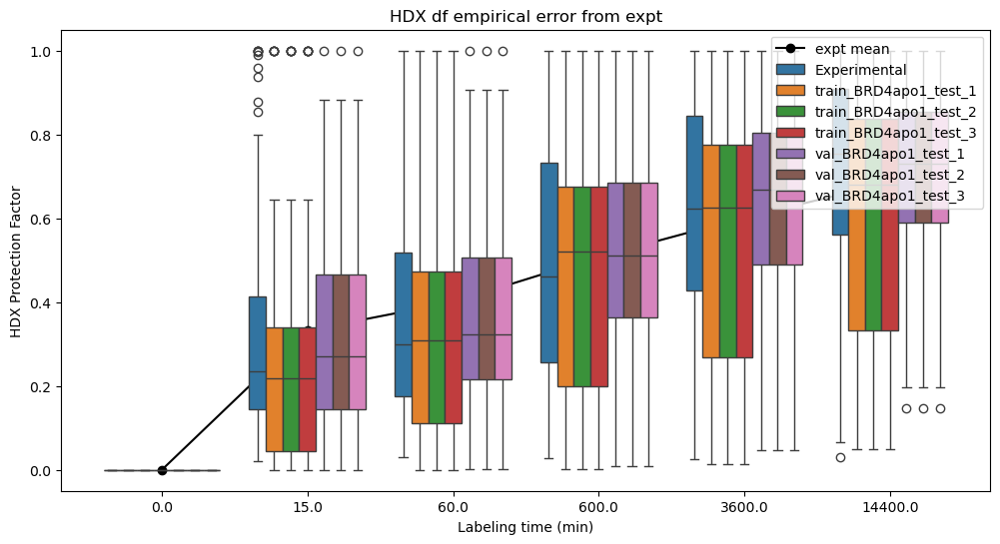

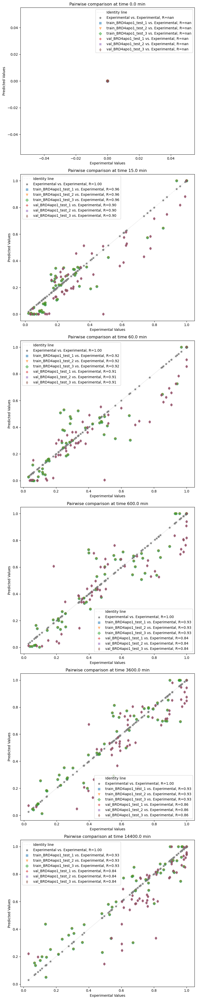

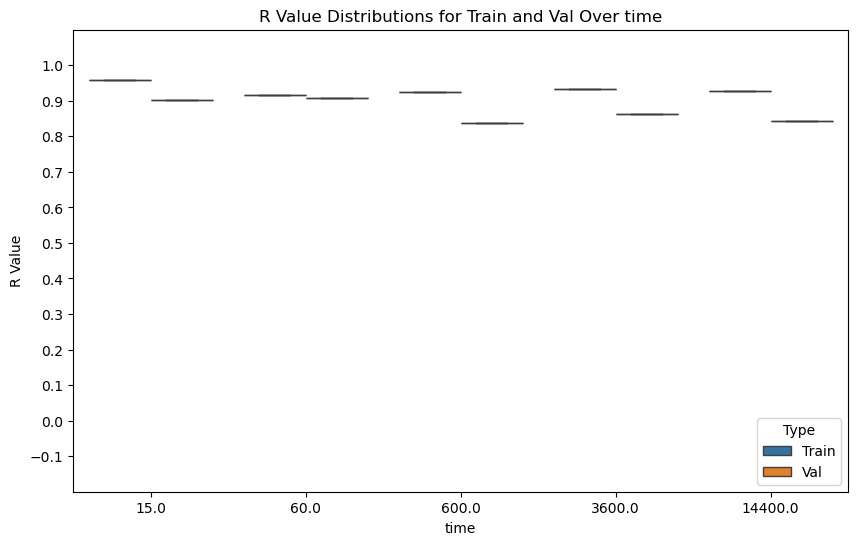

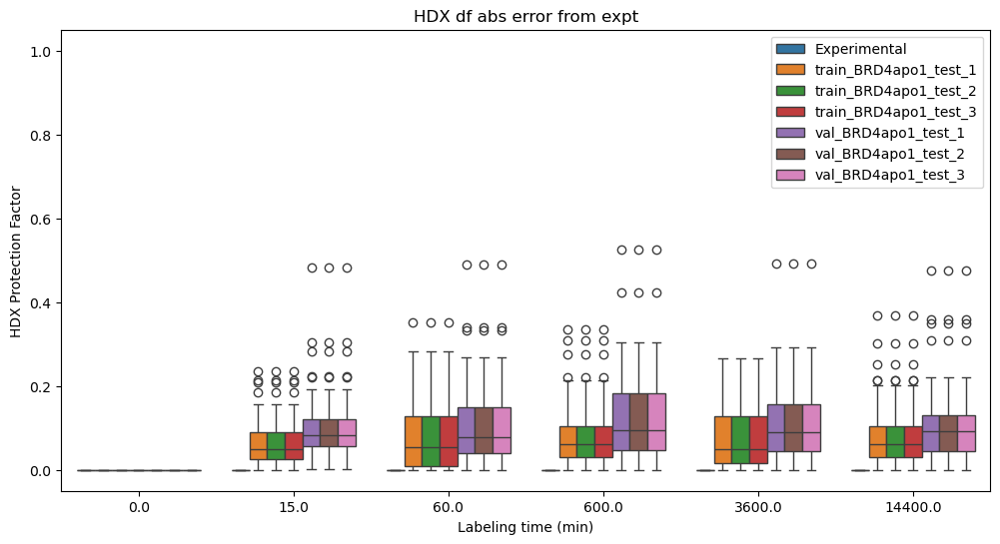

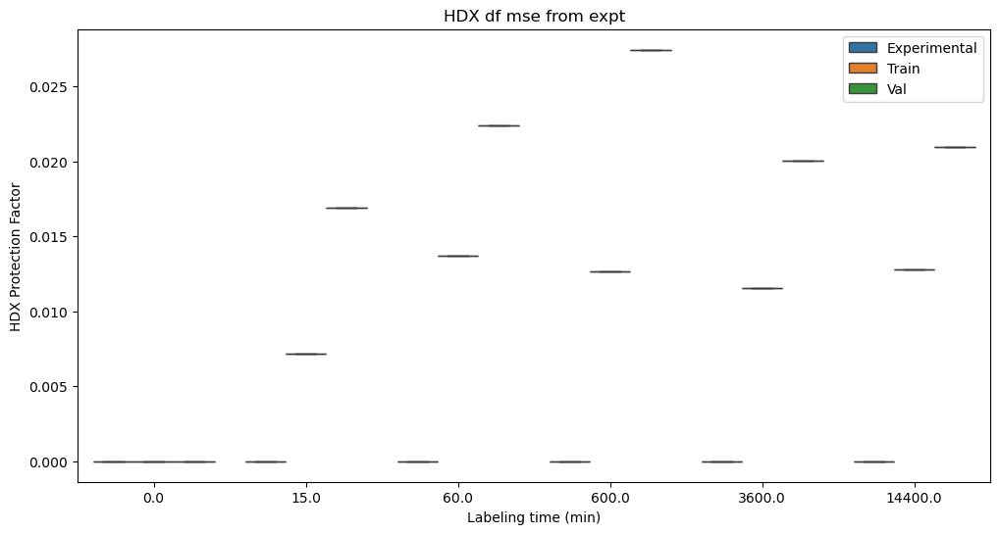

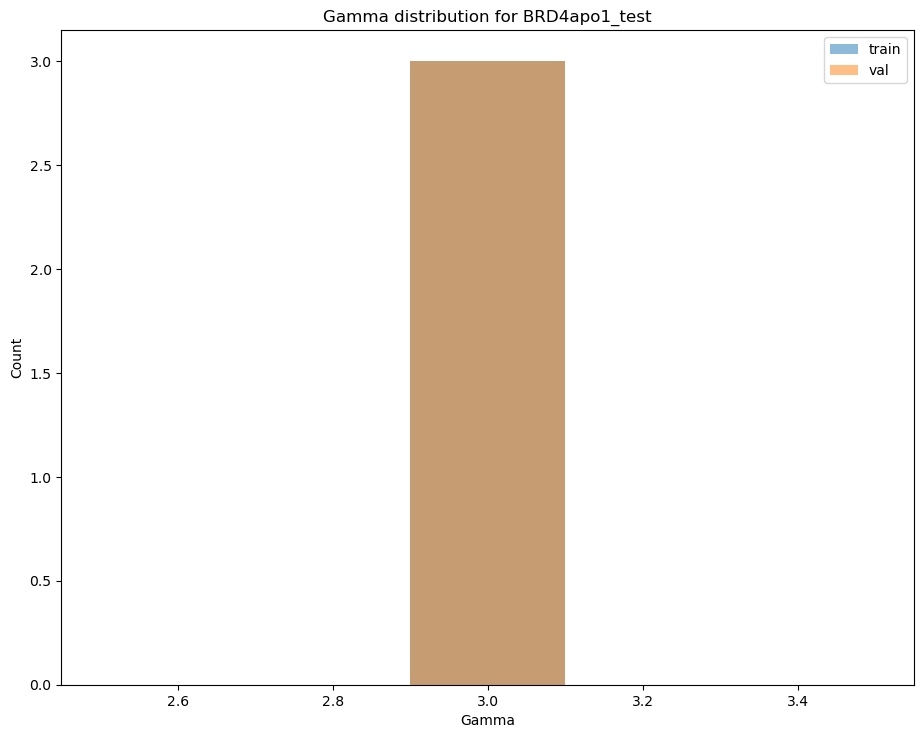

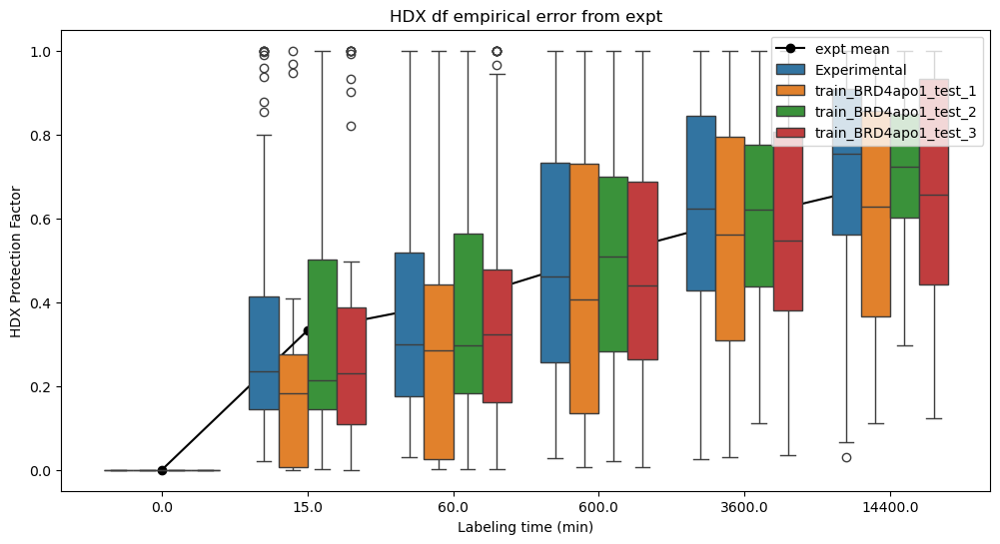

plotting dfracs compare for val
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
659  0.0  0.007690  0.029604  0.203087  0.485999  0.630321       99   
660  0.0  0.754009  0.787819  0.840433  0.870705  0.925868      100   
661  0.0  0.822378  0.858729  0.909987  0.915768  0.932999      101   
662  0.0  0.885068  0.908590  0.941756  0.945497  0.956647      102   
663  0.0  1.000000  1.000000  1.000000  1.000000  1.000000      103   

                calc_name  ResStr  ResEnd path  
0            Experimental     NaN     NaN  NaN

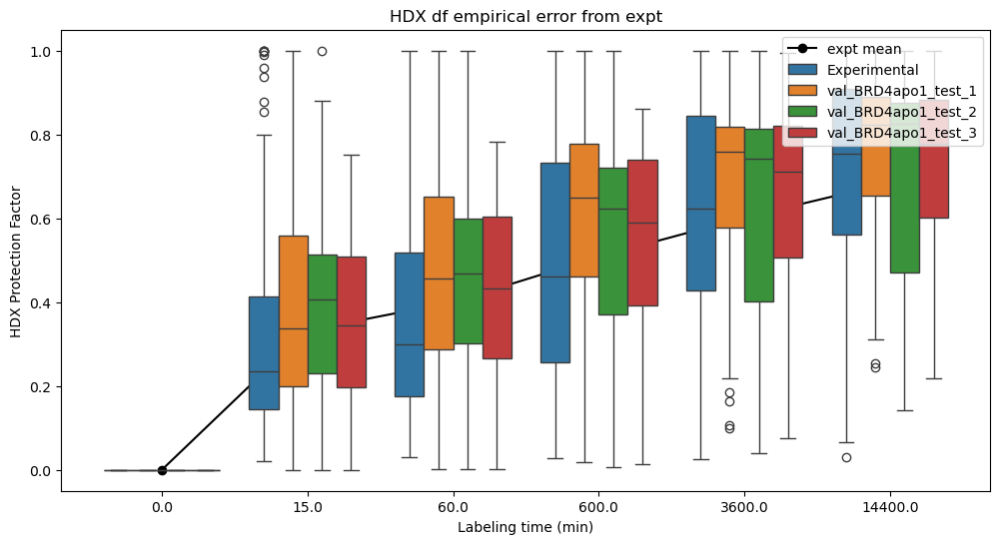

Restoring trainval peptide numbers
train_rep_names ['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
val_rep_names ['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
test_rep_names ['test_BRD4apo1_test_1', 'test_BRD4apo1_test_2', 'test_BRD4apo1_test_3']
train_rep_peptides [7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 78, 79, 80, 101, 102, 103]
val_rep_peptides [0, 1, 2, 3, 4, 5, 6, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 86, 87, 88, 89, 91, 92, 93, 94, 95, 97]
test_rep_peptides [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 8

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


plotting R agreement
plotting paired trainval agreement
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
347  0.0  0.202485  0.296060  0.483031  0.605658  0.696033       81   
348  0.0  0.191829  0.280485  0.457675  0.574177  0.660966       82   
349  0.0  0.202486  0.296067  0.483097  0.606051  0.697586       83   
350  0.0  0.212478  0.266321  0.406947  0.527570  0.637104       84   
351  0.0  0.000625  0.002494  0.024222  0.124676  0.319574       85   

               calc_name  ResStr  ResEnd  \
0           Experimental     NaN     NaN   
1  

/home/alexi/Documents/ValDX/ValDX/ValidationDX.py:1358: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dump["name"] = [name]*len(dump)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:929: UserWarning: Reader has no dt information, set to 1.0 ps
  pickle.dump(self, f)


envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
Experiment name xR_no_loops_BRD4apo1_test already exists.

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/xR_no_loops_BRD4apo1_test0/train_BRD4apo1_test_1/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.5891546719143245, 2.1133410249960725)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/xR_no_loops_BRD4apo1_test0/train_BRD4apo1_test_1/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(45, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  0.00251  0.00984  0.07853  0.19680  0.28067        0
1  0.0  0.00354  0.01390  0.11422  0.30915  0.38564        1
2  0.0  0.16587  0.24140  0.40260  0.56500  0.65477        2
3  0.0  0.21116  0.33956  0.56156  0.65839  0.72139       

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_1
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_1
    ResStr  ResEnd  peptide                                               path
0        1      26        0  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
1        5      26        1  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
2       12      26        2  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
3       15      26        3  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
4       27      40        4  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
5       41      63        5  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
6       41      65        6  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
7      138     148       48  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
8      144     151       49  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
9      148     155       50  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
10     149     155       51  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
11     149     156

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar di

LogPf_by_res shape
(126,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.02955577  0.51415292  0.15540584
  0.32455486  0.30536519  0.37400753  0.32941337  0.53825818  0.37489006
  0.08520229  0.          0.          0.          0.          0.
  0.          0.          0.          0.03502861  0.03599423  0.
  0.09404865  0.15286769  0.73302144  1.2874244   1.11808293  0.98872186
  1.75424828  2.45914487  6.25153838  5.50319631 10.38196328 11.17896813
 10.74905528  0.60087035  6.64530755  4.16278992 10.80062948 12.8943148
 17.31283468 18.24769207 17.20120091 18.06895566 17.46042659 17.01987198
 10.27328523 11.6452808  11.68526827 10.77397938  7.62922472 13.18688038
  5.96500282  8.07315921 18.50319937 16.73214367 19.1746329  25.4004222
 20.55754383 15.95970112 20.63166565 18.53873348 15.61091897 14.45994702
 17.51417864 15.18566062 14.51568163 16.93868943 19.38881838 10.17342676
 10.72970628 12.54063364  4.27916588  5.41491397  6

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.02955577  0.51415292  0.15540584
  0.32455486  0.30536519  0.37400753  0.32941337  0.53825818  0.37489006
  0.08520229  0.          0.          0.          0.          0.
  0.          0.          0.          0.03502861  0.03599423  0.
  0.09404865  0.15286769  0.73302144  1.2874244   1.11808293  0.98872186
  1.75424828  2.45914487  6.25153838  5.50319631 10.38196328 11.17896813
 10.74905528  0.60087035  6.64530755  4.16278992 10.80062948 12.8943148
 17.31283468 18.24769207 17.20120091 18.06895566 17.46042659 17.01987198
 18.92497437 20.09310746 16.67373541 17.6153411  22.44228528 19.49205853
 13.53240943 14.95871301 17.48309708 15.09085129 10.12766662 12.77865945
  5.32159242  8.10914558 20.85407558 10.94592093 10.87931073 17.82714044
 13.17570858  8.97435982  9.77427654 18.44823141 12.00797198  8.58410044
 10.23414017 10.46738128 12.32119052  9.04524442 1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/xR_no_loops_BRD4apo1_test/val_1_xR_no_loops_BRD4apo1_test_20240229-164206.pdb
Splitting segments for BRD4apo1_test by spatial split across Xture (alpha vs beta) and redundancy
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384

mkdssp: error while loading shared libraries: libboost_thread.so.1.73.0: cannot open shared object file: No such file or directory
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_inde

Saved train BRD4apo1_test HDX data to /home/alexi/Documents/ValDX/data/xR_no_loops_BRD4apo1_test0/train_BRD4apo1_test_2/train_BRD4apo1_test_2_expt_dfracs.dat
    ResStr  ResEnd  0.0     15.0     60.0    600.0   3600.0  14400.0  peptide  \
0       66      72  0.0  0.01990  0.03054  0.08149  0.14101  0.21407        7   
1       68      74  0.0  0.03625  0.09039  0.25719  0.36670  0.53602        8   
2       69      78  0.0  0.17451  0.24278  0.47578  0.62732  0.80091        9   
3       69      88  0.0  0.18359  0.23963  0.44791  0.57006  0.68663       10   
4       69      91  0.0  0.17894  0.25063  0.49769  0.64752  0.76749       11   
5       75      91  0.0  0.23889  0.33563  0.60965  0.73874  0.81860       12   
6       78      88  0.0  0.18862  0.24845  0.39858  0.54321  0.66430       13   
7       78      91  0.0  0.18665  0.28612  0.55148  0.67617  0.74918       14   
8       79      88  0.0  0.22451  0.29133  0.44498  0.58436  0.69089       15   
9       79      91  0.0  0.18912

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/xR_no_loops_BRD4apo1_test0/train_BRD4apo1_test_2/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.4154787364973567, 6.433601133891299)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/xR_no_loops_BRD4apo1_test0/train_BRD4apo1_test_2/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(27, 7)
   0.0  15.0  60.0  600.0  3600.0  14400.0  peptide
0  0.0   1.0   1.0    1.0     1.0      1.0        0
1  0.0   1.0   1.0    1.0     1.0      1.0        1
2  0.0   1.0   1.0    1.0     1.0      1.0        2
3  0.0   1.0   1.0    1.0     1.0      1.0        3
4  0.0   1.0   1.0    1.0     1.0      1.0 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_2
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_2
    ResStr  ResEnd  peptide                                               path
34      66      72        7  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
35      68      74        8  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
36      69      78        9  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
37      69      88       10  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
38      69      91       11  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
39      75      91       12  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
40      78      88       13  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
41      78      91       14  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
42      79      88       15  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
43      79      91       16  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
44      82      88       17  /home/alexi/Documents/ValDX/data/xR_no_loops_B...
45      89     102

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(106,)
[18.28936077 19.11314183 16.70176084 17.36579213 20.76980939 18.68927513
  9.69403832 15.49230707 17.27253212 15.50132975  7.29297404 13.9549079
  3.90367453  5.71866391 19.49895983  7.71919093 12.46463949 16.55357778
  9.29166315  6.32882307  6.89293365 16.23615461  8.4681617  10.91269326
 12.0096577  12.17414204 13.48146991  6.37881172 14.72564628  7.02253
  5.54410164 16.34604132 16.62141115  4.51963457  2.65221576  8.68193458
 11.49967389 19.66572234 19.49637784 18.39204471 20.25040927 17.63006014
 17.37024628 22.11725412 20.46972239 14.41691638 12.32238479 10.03289978
 18.3812601  22.855922   19.44066777 16.19821554 19.49293934 18.0169792
 15.9522503  15.14057148 17.2944512  15.65235317 15.17987618 16.95975786
 18.61646897 11.80866336 12.50996227 13.70288656  3.01771762  3.8186604
  4.78352665 13.30791573  6.64310218 12.20253784  1.4349597   1.54213781
 15.52533042 16.71739586  4.52647287  2.30408964 13.91217857 14.07919353
  6.11427604 11.87833323 18.298

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 2.08430733e-02 3.62586631e-01 1.09594011e-01
 2.95542664e-01 2.15347091e-01 4.73393667e-01 2.32306147e-01
 5.22562335e-01 2.64376838e-01 6.00856450e-02 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 2.47025818e-02
 2.53835472e-02 0.00000000e+00 6.63242006e-02 1.07804078e-01
 5.16935254e-01 9.07906684e-01 7.88485105e-01 6.97258171e-01
 1.23711632e+00 1.73421761e+00 4.40865768e+00 3.88091813e+00
 7.32148142e+00 7.88353853e+00 7.58035898e+00 4.23740771e-01
 8.55170244e+00 2.93564794e+00 7.61672970e+00 9.09322098e+00
 1.22758755e+01 1.72044514e+01 1.21971500e+01 1.72337155e+01
 1.72565446e+01 1.69458604e+01 1.82893608e+01 1.91131418e+01
 1.67017608e+01 1.73657921e+01 2.07698094e+01 1.86892751e+01
 9.69403832e+00 1.54923071e+01 1.72725321e+01 1.55013297e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/xR_no_loops_BRD4apo1_test/val_2_xR_no_loops_BRD4apo1_test_20240229-164234.pdb
Splitting segments for BRD4apo1_test by spatial split across Xture (alpha vs beta) and redundancy
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384

mkdssp: error while loading shared libraries: libboost_thread.so.1.73.0: cannot open shared object file: No such file or directory
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_inde

Saved train BRD4apo1_test_3 segments to /home/alexi/Documents/ValDX/data/xR_no_loops_BRD4apo1_test0/train_BRD4apo1_test_3/train_residue_segs__BRD4apo1_test_.txt
Train Peptide numbers: [  0   1   2   3   4  20  21  22  23  24  25  26  27  28  29  30  31  32
  33  34  35  36  37  38  39  40  41  42  43  44  45  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103]
Saved val BRD4apo1_test_3 segments to /home/alexi/Documents/ValDX/data/xR_no_loops_BRD4apo1_test0/val_BRD4apo1_test_3/val_residue_segs__BRD4apo1_test_.txt
Val Peptide numbers: [ 5  6  7  8  9 10 13 15 17 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62
 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85]
train_HDX_data
    0.0     15.0     60.0    600.0   3600.0  14400.0  peptide  \
0   0.0  1.00000  1.00000  0.95687  0.96195  0.97437        0   
1   0.0  1.00000  1.00000  0.93472  0.89664  0.89861        1   
2   0.0  1.00000  1.00000  0.99807  0.95428  0.94989        2   
3   0.0  0.93736  0.9

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/xR_no_loops_BRD4apo1_test0/train_BRD4apo1_test_3/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.4663673534916584, 5.335167040166848)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/xR_no_loops_BRD4apo1_test0/train_BRD4apo1_test_3/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(49, 7)
   0.0  15.0  60.0  600.0  3600.0  14400.0  peptide
0  0.0   1.0   1.0    1.0     1.0      1.0        0
1  0.0   1.0   1.0    1.0     1.0      1.0        1
2  0.0   1.0   1.0    1.0     1.0      1.0        2
3  0.0   1.0   1.0    1.0     1.0      1.0        3
4  0.0   1.0   1.0    1.0     1.0      1.0 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_3
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar di

Recalculating val_BRD4apo1_test_3
     ResStr  ResEnd  peptide  \
80       41      63        5   
81       41      65        6   
82       66      72        7   
83       68      74        8   
84       69      78        9   
85       69      88       10   
86       78      88       13   
87       79      88       15   
88       82      88       17   
89      138     148       48   
90      144     151       49   
91      148     155       50   
92      149     155       51   
93      149     156       52   
94      150     156       53   
95      157     172       54   
96      158     172       55   
97      161     172       56   
98      162     173       57   
99      165     172       58   
100     365     371       59   
101     365     381       60   
102     369     381       61   
103     372     378       62   
104     372     381       63   
105     372     383       64   
106     382     390       65   
107     382     392       66   
108     383     390       67   
109   

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(132,)
[ 0.78265966  1.38864065  1.94662784  4.94863836  4.35626028  8.21823023
  8.84912915  8.5088156   0.47564134  8.12404147  3.29521162  8.54964108
 10.20697578 13.75400803 17.65700118 13.66564016 17.63058008 17.483725
 17.13498756 18.64304242 19.56772173 16.86099025 17.60635335 21.42730105
 19.09193903 10.82382458 15.50340031 17.50167067 15.54564615  8.12867342
 13.77769761  4.32424614  6.41909662 20.05835323  8.66465195 12.1624561
 17.06161303 10.42972352  7.10398922  7.73719313 11.73212206 12.81817632
 12.80044185 11.27649619  6.03919737 14.03848697  4.72182045  6.39061027
 17.58830043 16.84487235 18.77831579 23.76892465 19.93536366 16.29576978
 19.99403755 18.33729903 16.01967826 15.10858349 17.52627444 15.68304916
 15.1527023  17.12343573 19.01021544 11.4864986  12.15577231 13.52692626
  3.38733335  4.28637711  5.34398226 13.28149872  7.43132209 12.04073207
  1.61071627  1.70558201 16.09500054 16.87854028  4.87628541  2.58629887
 13.95977281 14.14724408  6.

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 2.33959721e-02 4.06996923e-01 1.23017291e-01
 3.06301547e-01 2.41723208e-01 4.51373676e-01 2.60759440e-01
 5.32004354e-01 2.96758210e-01 6.74450478e-02 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 2.77282004e-02
 2.84925718e-02 0.00000000e+00 7.44477134e-02 1.21008124e-01
 5.80250456e-01 1.01910880e+00 8.85060244e-01 7.82659663e-01
 1.38864065e+00 1.94662784e+00 4.94863836e+00 4.35626028e+00
 8.21823023e+00 8.84912915e+00 8.50881560e+00 4.75641337e-01
 8.12404147e+00 3.29521162e+00 8.54964108e+00 1.02069758e+01
 1.37540080e+01 1.76570012e+01 1.36656402e+01 1.76305801e+01
 1.74837250e+01 1.71349876e+01 1.86430424e+01 1.95677217e+01
 1.68609903e+01 1.76063534e+01 2.14273010e+01 1.90919390e+01
 1.08238246e+01 1.55034003e+01 1.75016707e+01 1.55456462e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing train PDB to results/xR_no_loops_BRD4apo1_test/train_3_xR_no_loops_BRD4apo1_test_20240229-164314.pdb
Writing val PDB to results/xR_no_loops_BRD4apo1_test/val_3_xR_no_loops_BRD4apo1_test_20240229-164314.pdb
Finished running VDX loop
Evaluating HDX
plotting gamma distributions
['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
plotting dfracs compare for train
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
659  0.0  0.007690 

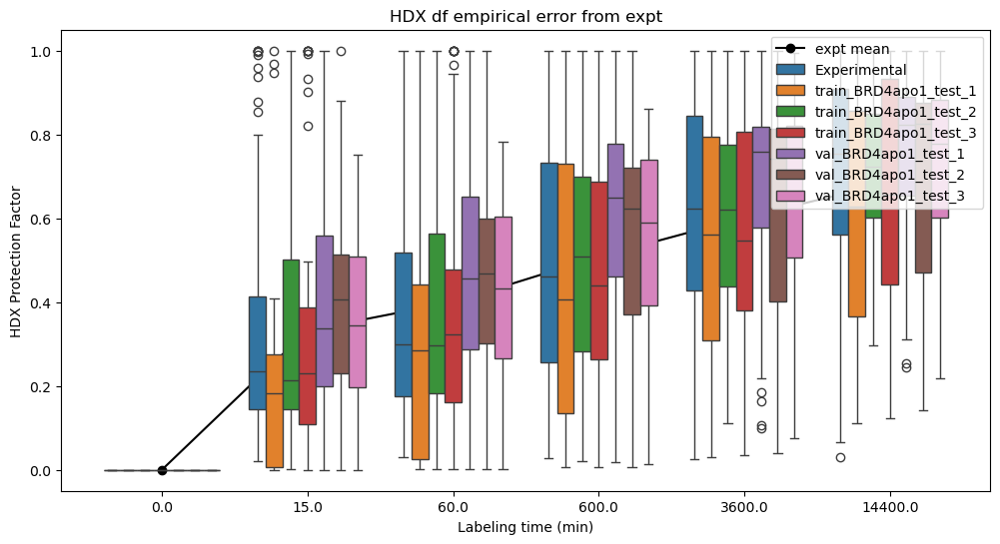

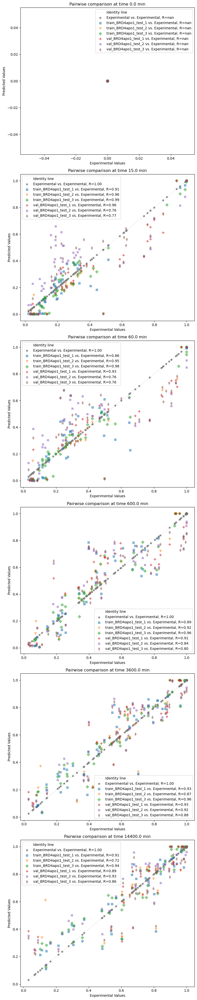

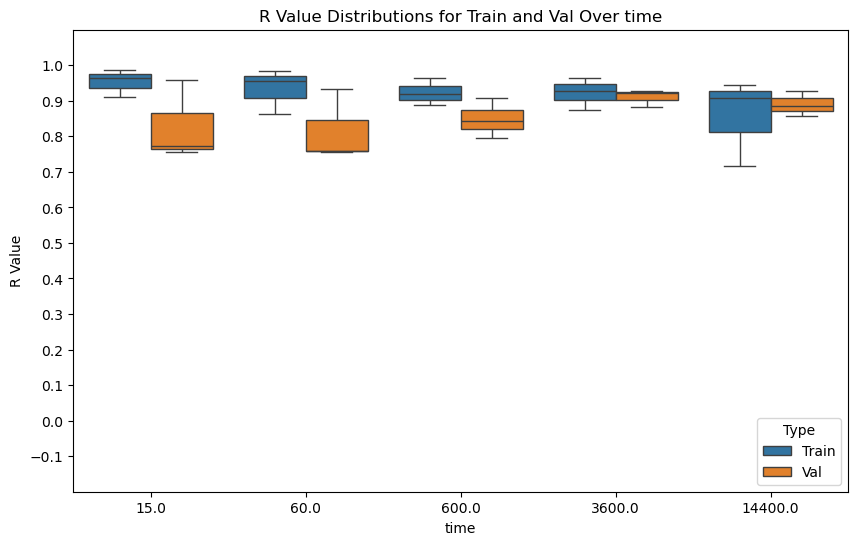

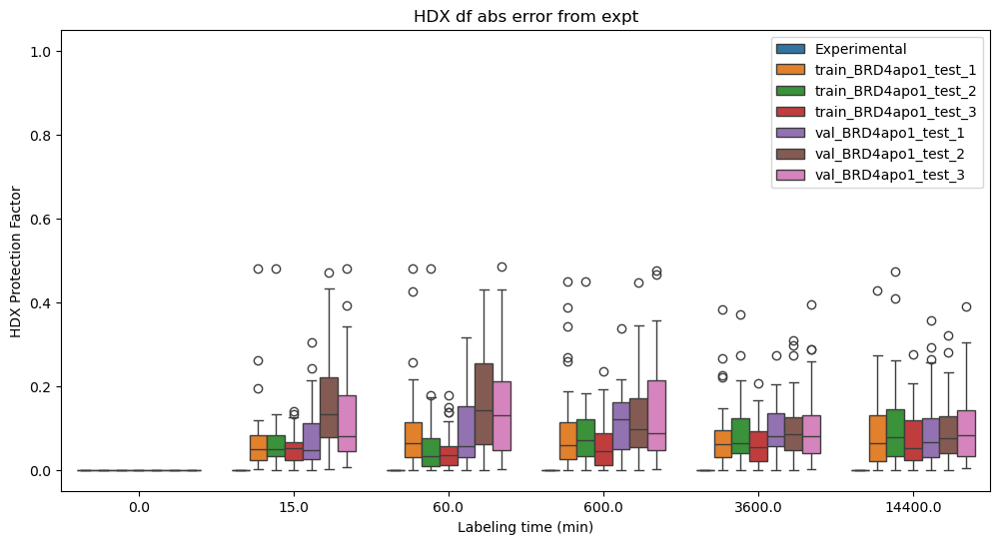

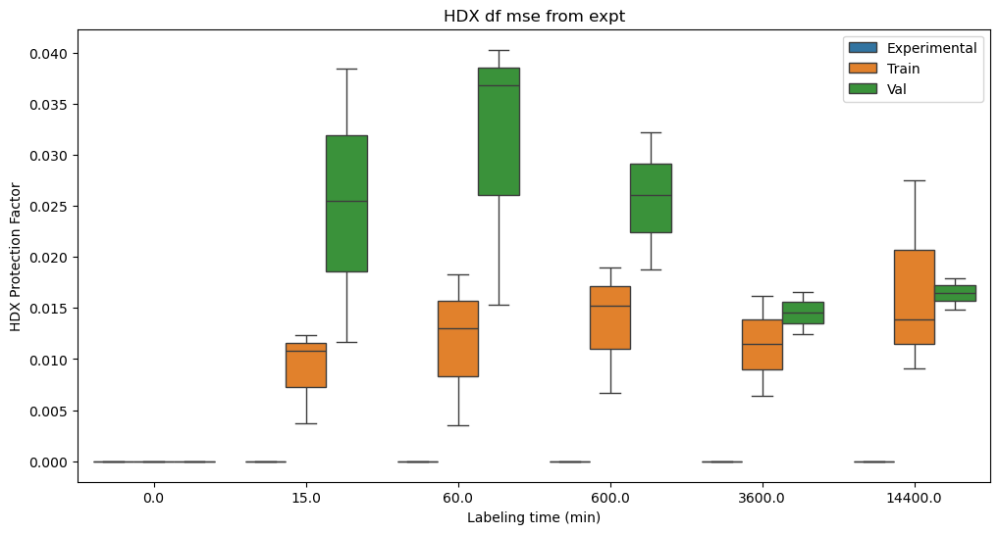

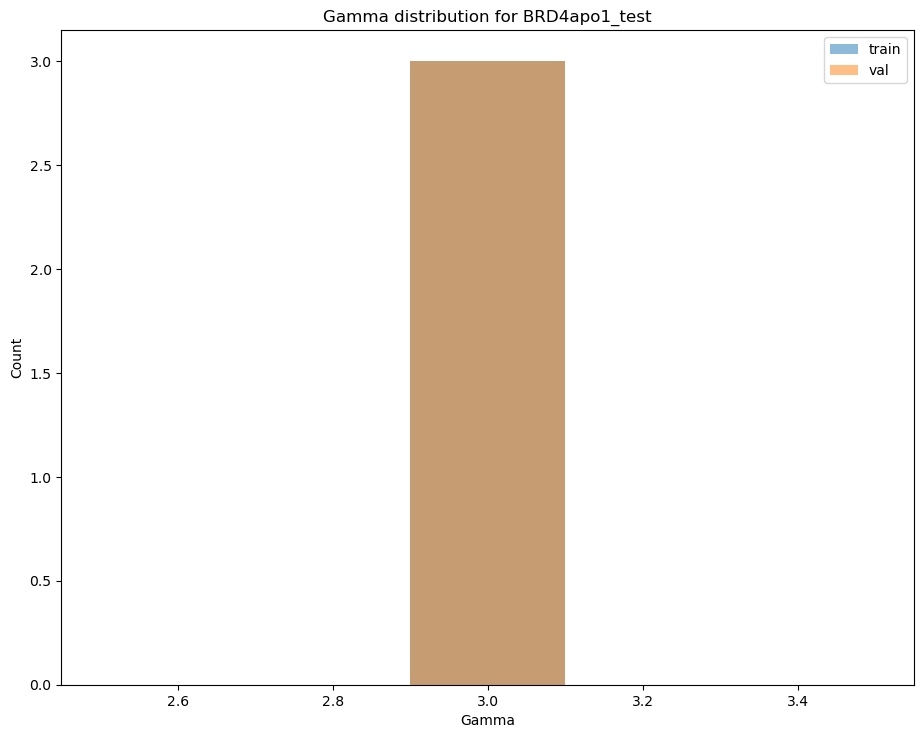

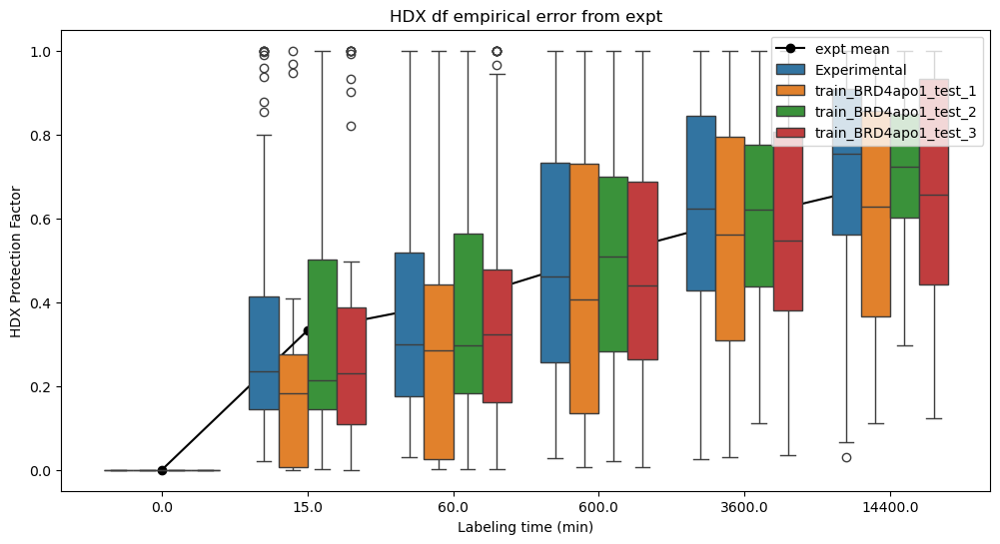

plotting dfracs compare for val
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
659  0.0  0.007690  0.029604  0.203087  0.485999  0.630321       99   
660  0.0  0.754009  0.787819  0.840433  0.870705  0.925868      100   
661  0.0  0.822378  0.858729  0.909987  0.915768  0.932999      101   
662  0.0  0.885068  0.908590  0.941756  0.945497  0.956647      102   
663  0.0  1.000000  1.000000  1.000000  1.000000  1.000000      103   

                calc_name  ResStr  ResEnd path  
0            Experimental     NaN     NaN  NaN

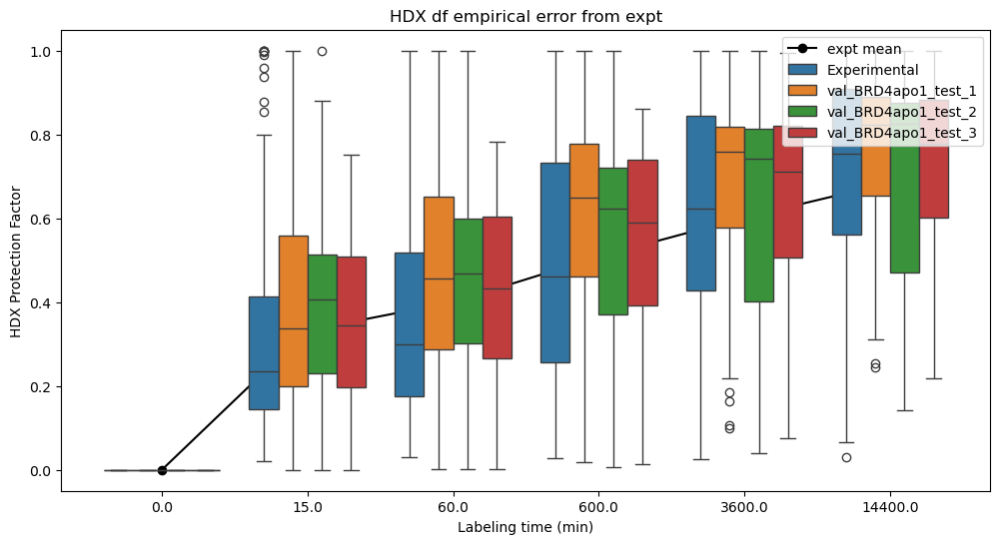

Restoring trainval peptide numbers
train_rep_names ['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
val_rep_names ['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
test_rep_names ['test_BRD4apo1_test_1', 'test_BRD4apo1_test_2', 'test_BRD4apo1_test_3']
train_rep_peptides [7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 78, 79, 80, 101, 102, 103]
val_rep_peptides [0, 1, 2, 3, 4, 5, 6, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 86, 87, 88, 89, 91, 92, 93, 94, 95, 97]
test_rep_peptides [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 8

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


plotting R agreement
plotting paired trainval agreement
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
347  0.0  0.202485  0.296060  0.483031  0.605658  0.696033       81   
348  0.0  0.191829  0.280485  0.457675  0.574177  0.660966       82   
349  0.0  0.202486  0.296067  0.483097  0.606051  0.697586       83   
350  0.0  0.212478  0.266321  0.406947  0.527570  0.637104       84   
351  0.0  0.000625  0.002494  0.024222  0.124676  0.319574       85   

               calc_name  ResStr  ResEnd  \
0           Experimental     NaN     NaN   
1  

/home/alexi/Documents/ValDX/ValDX/ValidationDX.py:1358: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dump["name"] = [name]*len(dump)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:929: UserWarning: Reader has no dt information, set to 1.0 ps
  pickle.dump(self, f)


envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
Experiment name Sp_res_neighbours_BRD4apo1_test already e

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/Sp_res_neighbours_BRD4apo1_test0/train_BRD4apo1_test_1/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.5678323216384624, 3.446389471940604)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/Sp_res_neighbours_BRD4apo1_test0/train_BRD4apo1_test_1/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(50, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  0.00416  0.01615  0.11709  0.25501  0.34792        0
1  0.0  0.18369  0.39024  0.68747  0.72384  0.74908        1
2  0.0  0.18686  0.38108  0.65348  0.70867  0.73223        2
3  0.0  0.22516  0.44590  0.76256  0.81289  0.8

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_1
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_1
    ResStr  ResEnd  peptide                                               path
0        1      26        0  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
1        5      26        1  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
2       12      26        2  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
3       15      26        3  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
4       27      40        4  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
5      162     173       57  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
6      165     172       58  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
7      407     424       81  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
8      446     453       99  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
9      453     467      100  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
10     454     467      101  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
11     454     477

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(89,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.0284861   0.495545    0.14978148
  0.33181719  0.29431359  0.42024884  0.31749143  0.55954658  0.36132225
  0.08211869  0.          0.          0.          0.          0.
  0.          0.          0.          0.03376087  0.03469154  0.
  0.09064489  0.14733519  0.70649234  1.24083067  1.07761791 11.12665878
 11.75091615 13.47230502  4.12429675  5.21894049  6.46551826 13.49342946
  9.00698908 11.98271607  1.96115091  2.03553137 23.7072784  12.67490985
 10.35173494 10.82441808 12.19365685  9.88235541 11.33650406  8.63053484
 16.10836353  7.06004418 14.74010959 18.65095431 23.34093382 19.30833317
 18.77385524 23.89083933 19.39301861 15.40107975 20.77714477 20.54934163
 15.57709356 13.87528484 18.62731792 15.0431761  12.47110517 17.12338042
 18.69655724 11.44824857  6.85408767  9.0951198   2.16252994  3.81993303
  1.14324331  1.96159883  1.78652572  1.2425527   

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.0284861   0.495545    0.14978148
  0.33181719  0.29431359  0.42024884  0.31749143  0.55954658  0.36132225
  0.08211869  0.          0.          0.          0.          0.
  0.          0.          0.          0.03376087  0.03469154  0.
  0.09064489  0.14733519  0.70649234  1.24083067  1.07761791  0.9529386
  1.69075952  2.3701449   6.02528626  5.30402776 10.00622517 10.77438528
 10.36003159  0.57912399  7.50698351  4.0121326  10.40973925 12.42765111
 16.70526686 18.82365299 16.59767329 18.6956712  18.23804206 17.81343175
 19.64958576 20.77544244 17.47982235 18.38734999 23.03960016 20.19614633
 13.08565905 15.82686907 18.25989207 15.93022664  9.80413876 13.72571477
  5.17200326  7.815664   21.46586316 10.54977239 11.85209932 18.31729674
 12.69886084  8.6495649   9.42053149 18.70050565 11.5733863   9.65896441
 11.23027841 11.45507818 13.24179541  8.71788409 1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing train PDB to results/Sp_res_neighbours_BRD4apo1_test/train_1_Sp_res_neighbours_BRD4apo1_test_20240229-164358.pdb
Writing val PDB to results/Sp_res_neighbours_BRD4apo1_test/val_1_Sp_res_neighbours_BRD4apo1_test_20240229-164358.pdb
Splitting segments for BRD4apo1_test by spatial split: random point in space
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_segs["calc_name

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/Sp_res_neighbours_BRD4apo1_test0/train_BRD4apo1_test_2/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.16745963453670398, 11.994716415572231)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/Sp_res_neighbours_BRD4apo1_test0/train_BRD4apo1_test_2/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(44, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  0.50280  0.51392  0.60688  0.80231  0.97143        0
1  0.0  0.54800  0.55811  0.64262  0.82028  0.97402        1
2  0.0  0.66640  0.67070  0.70469  0.83628  0.97624        2
3  0.0  0.50511  0.51987  0.64730  0.85390  0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_2
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_2
    ResStr  ResEnd  peptide                                               path
13      27      40        4  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
14      66      72        7  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
15      68      74        8  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
16      69      78        9  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
17      69      88       10  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
18      69      91       11  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
19      75      91       12  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
20      78      88       13  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
21      78      91       14  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
22      79      88       15  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
23      79      91       16  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
24      82      88

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(75,)
[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 9.95643086e-03 1.02308955e-02 0.00000000e+00 2.67321175e-02
 4.34506748e-02 2.08351911e-01 3.65933821e-01 3.17800686e-01
 1.67732069e+01 1.71052337e+01 1.61333212e+01 1.64009605e+01
 1.77729572e+01 1.69343932e+01 4.19406129e+00 1.56458481e+01
 1.63633718e+01 1.54894143e+01 3.22630696e+00 1.50261959e+01
 1.86024221e+00 2.30492029e+00 1.69738810e+01 3.11123718e+00
 1.41386825e+01 1.42447564e+01 3.74502562e+00 2.55084630e+00
 2.77821233e+00 1.26800664e+01 3.41311152e+00 1.36399541e+01
 1.39553010e+01 1.40215968e+01 1.45485182e+01 2.57099434e+00
 1.33668633e+01 2.83044643e+00 3.22095980e+00 1.73984394e+01
 1.66530985e+01 1.69424520e+01 1.56493164e+01 1.66217671e+01
 1.58747354e+01 5.62495613e+00 1.70561846e+01 1.41200831e+01
 1.45100552e+01 1.43677655e+01 1.16117618e+01 2.16850896e+00
 1.49482350e+01 1.69547530e+00 2.29469162e+00 1.44105586e+01
 1.59559305e+01 1.66501766e+01 1.86137696e+01 1.72372437e+01

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 8.40084733e-03 1.46141353e-01 4.41721113e-02
 2.45906118e-01 8.67961270e-02 5.89518345e-01 9.36315123e-02
 4.82548900e-01 1.06557676e-01 2.42176537e-02 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 9.95643086e-03
 1.02308955e-02 0.00000000e+00 2.67321175e-02 4.34506748e-02
 2.08351911e-01 3.65933821e-01 3.17800686e-01 2.81031466e-01
 4.98622500e-01 6.98980287e-01 1.77691934e+00 1.56421274e+00
 2.95093947e+00 3.17747785e+00 3.05528065e+00 1.70789666e-01
 1.07983584e+01 1.18321947e+00 3.06993995e+00 3.66504306e+00
 5.07460606e+00 1.51809329e+01 5.04287560e+00 1.54881165e+01
 1.63569280e+01 1.62317060e+01 1.67732069e+01 1.71052337e+01
 1.61333212e+01 1.64009605e+01 1.77729572e+01 1.69343932e+01
 4.19406129e+00 1.56458481e+01 1.63633718e+01 1.54894143e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing train PDB to results/Sp_res_neighbours_BRD4apo1_test/train_2_Sp_res_neighbours_BRD4apo1_test_20240229-164432.pdb
Writing val PDB to results/Sp_res_neighbours_BRD4apo1_test/val_2_Sp_res_neighbours_BRD4apo1_test_20240229-164432.pdb
Splitting segments for BRD4apo1_test by spatial split: random point in space
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 

/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_segs["calc_name"] = val_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:748: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/Sp_res_neighbours_BRD4apo1_test0/train_BRD4apo1_test_3/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.5978625253877627, 0.0616381126971277)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/Sp_res_neighbours_BRD4apo1_test0/train_BRD4apo1_test_3/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(21, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  1.00000  1.00000  1.00000  1.00000   1.0000        0
1  0.0  1.00000  1.00000  1.00000  1.00000   1.0000        1
2  0.0  1.00000  1.00000  1.00000  1.00000   1.0000        2
3  0.0  1.00000  1.00000  1.00000  1.00000   1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_3
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_3
    ResStr  ResEnd  peptide                                               path
35      66      72        7  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
36      68      74        8  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
37      69      78        9  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
38      69      88       10  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
39      69      91       11  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
40      75      91       12  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
41      78      88       13  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
42      78      91       14  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
43      79      88       15  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
44      79      91       16  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
45      82      88       17  /home/alexi/Documents/ValDX/data/Sp_res_neighb...
46      89     102

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(110,)
[17.1217516  18.30714999 14.83723877 15.79276162 20.69104925 17.69721741
 13.66886839 13.09686791 15.65856301 13.26642294 10.21380263 10.88459261
  5.33669345  8.22900078 19.14291884 11.10770438  9.02072448 16.41287181
 13.37044885  9.1070031   9.91874279 17.36145588 12.18545282  6.66350067
  8.36601814  8.60270661 10.48391561  9.1789354  13.92058459 10.10522838
  7.01297393  7.66680054 15.00220509  6.5036304   3.81646586 12.49306613
 16.54771585 19.38288552 19.13920342 17.26951098 19.9436467  16.17303605
 15.79917102 22.62998532 20.25923227 13.51541677 12.51860192 11.83285246
 14.54360465 19.51453221  8.26547983 12.42073226 18.21335692 20.26380806
 15.48043534 16.1017167  20.64535906 19.35394983 16.69294201 18.45404198
 13.83730377 16.58108298 14.64209214 13.68563999 14.85402065  8.37765204
  9.76992605  9.83859427  9.37030877  7.74198657 11.33431086  6.05316705
  8.19248252 17.10374171 14.93197402 17.41056386 23.69290817 18.77845085
 14.11265087 18.85366821 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.02999261  0.52175223  0.15770278
  0.30126213  0.30987857  0.2911997   0.33428218  0.48596774  0.38043103
  0.0864616   0.          0.          0.          0.          0.
  0.          0.          0.          0.03554634  0.03652623  0.
  0.09543871  0.15512712  0.74385568  1.30645286  1.13460848  1.00333542
  1.78017651  2.49549165  6.34393768  5.58453493 10.53541129 11.34419607
 10.90792901  0.60975137  5.11478099  4.224317   10.96026548 13.084896
 17.54063297 16.69034957 17.42734924 16.44352787 15.63555744 15.18849132
 17.1217516  18.30714999 14.83723877 15.79276162 20.69104925 17.69721741
 13.66886839 13.09686791 15.65856301 13.26642294 10.21380263 10.88459261
  5.33669345  8.22900078 19.14291884 11.10770438  9.02072448 16.41287181
 13.37044885  9.1070031   9.91874279 17.36145588 12.18545282  6.66350067
  8.36601814  8.60270661 10.48391561  9.1789354  13

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing train PDB to results/Sp_res_neighbours_BRD4apo1_test/train_3_Sp_res_neighbours_BRD4apo1_test_20240229-164455.pdb
Writing val PDB to results/Sp_res_neighbours_BRD4apo1_test/val_3_Sp_res_neighbours_BRD4apo1_test_20240229-164455.pdb
Finished running VDX loop
Evaluating HDX
plotting gamma distributions
['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
plotting dfracs compare for train
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ..

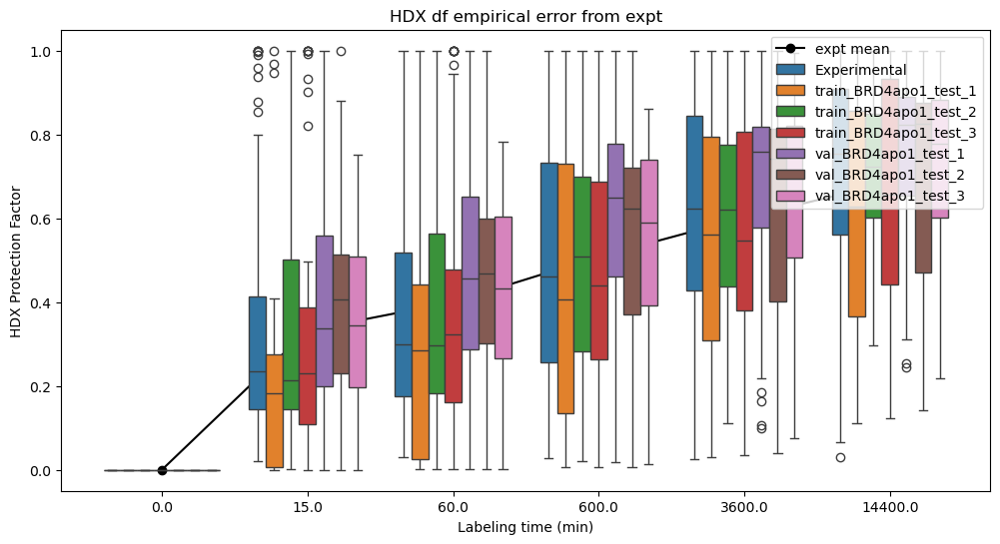

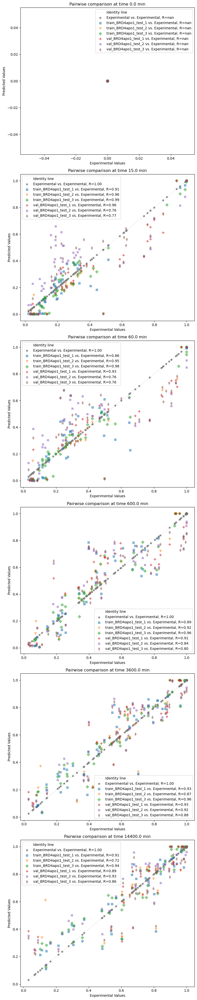

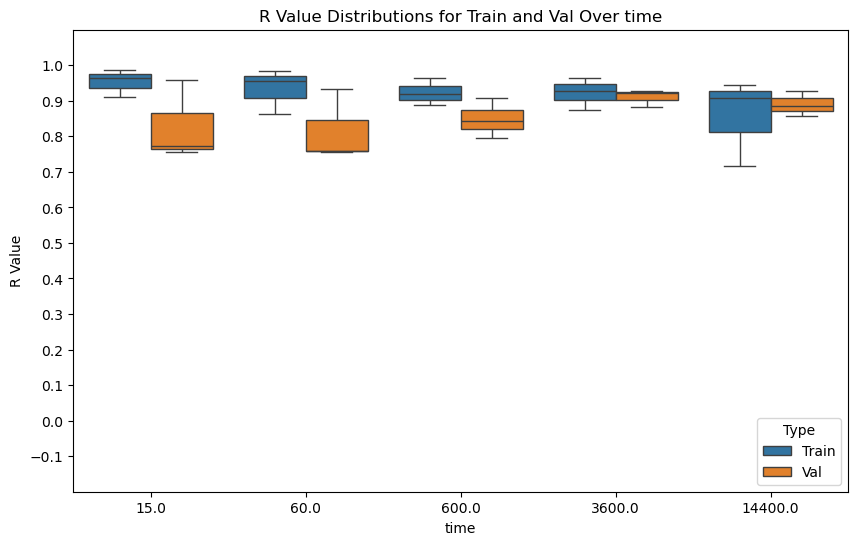

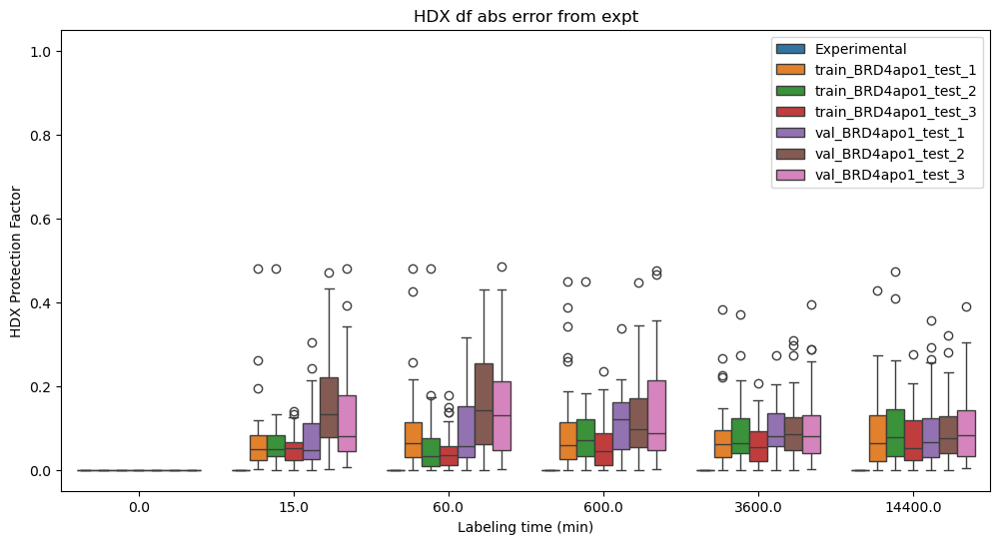

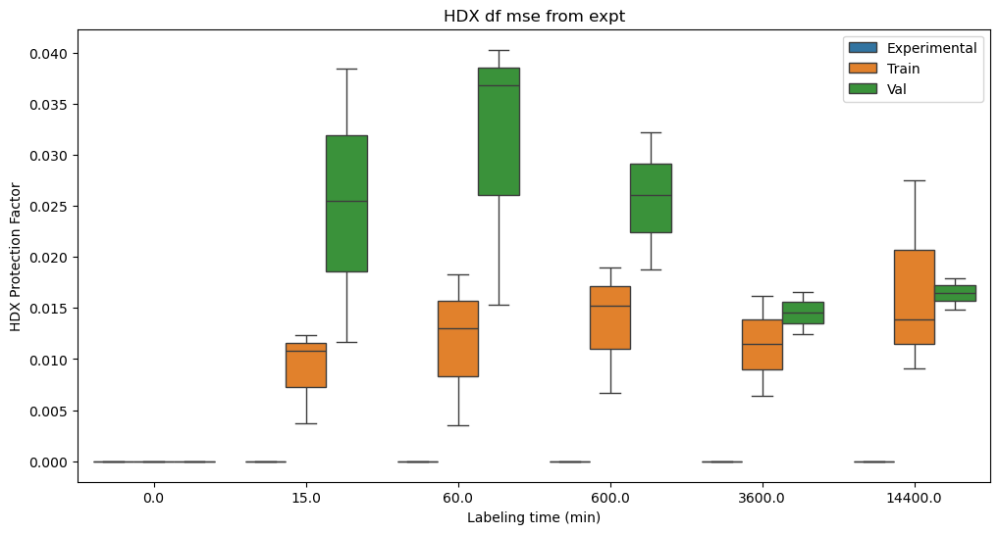

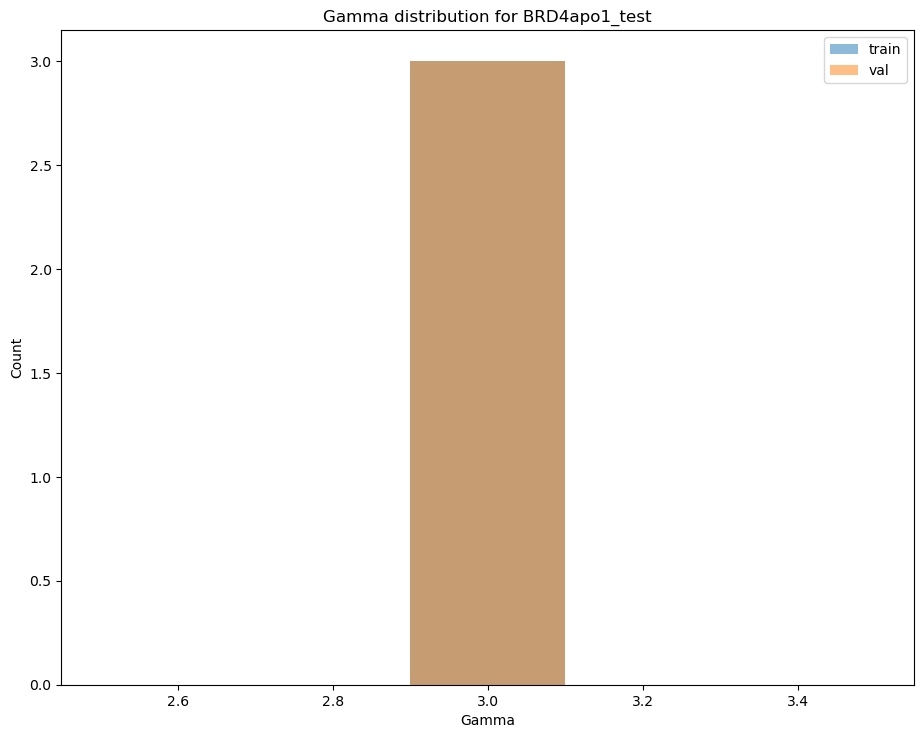

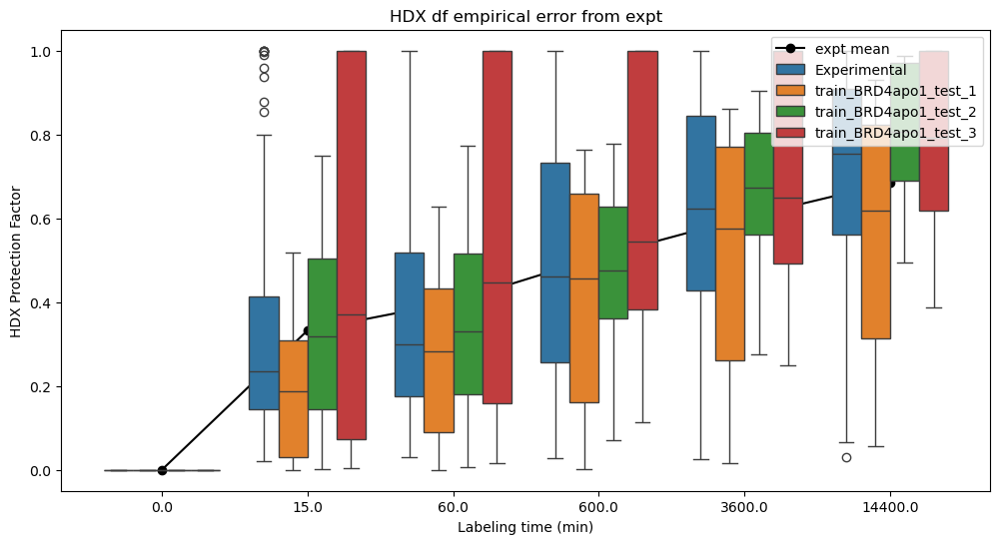

plotting dfracs compare for val
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
605  0.0  0.099827  0.208902  0.461410  0.632555  0.724261       99   
606  0.0  0.833759  0.838636  0.875868  0.943530  0.985403      100   
607  0.0  0.908245  0.909748  0.915456  0.941188  0.984076      101   
608  0.0  0.940629  0.941602  0.945295  0.961945  0.989696      102   
609  0.0  1.000000  1.000000  1.000000  1.000000  1.000000      103   

                calc_name  ResStr  ResEnd path  
0            Experimental     NaN     NaN  NaN

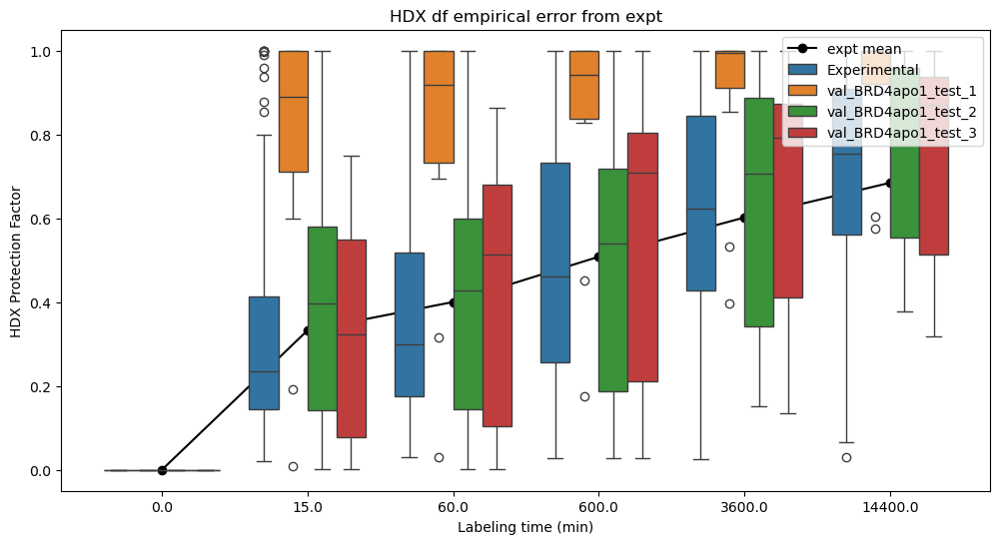

Restoring trainval peptide numbers
train_rep_names ['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
val_rep_names ['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
test_rep_names ['test_BRD4apo1_test_1', 'test_BRD4apo1_test_2', 'test_BRD4apo1_test_3']
train_rep_peptides [8, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 61, 62, 63, 64, 65, 67, 68, 89, 91, 93]
val_rep_peptides [0, 1, 2, 3, 4, 57, 58, 81, 99, 100, 101, 102, 103]
test_rep_peptides [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100,

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


plotting R agreement
plotting paired trainval agreement
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
293  0.0  0.740214  0.862990  0.999812  1.000000  1.000000       58   
294  0.0  0.633684  0.704948  0.862100  0.917425  0.966113       65   
295  0.0  0.680262  0.758379  0.887173  0.932439  0.972275       66   
296  0.0  0.706105  0.768043  0.858253  0.907104  0.961877       67   
297  0.0  0.664120  0.734906  0.838004  0.893833  0.956431       68   

               calc_name  ResStr  ResEnd  \
0           Experimental     NaN     NaN   
1  

/home/alexi/Documents/ValDX/ValDX/ValidationDX.py:1358: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dump["name"] = [name]*len(dump)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:929: UserWarning: Reader has no dt information, set to 1.0 ps
  pickle.dump(self, f)


Saving experiment to:  logs/Sp_res_neighbours_BRD4apo1_test0_1709225099.pkl
Analysis Dump {'Sp_res_neighbours_BRD4apo1_test': {'train_dfs': [    0.0     15.0     60.0    600.0   3600.0  14400.0  peptide  \
0   0.0  0.00416  0.01615  0.11709  0.25501  0.34792        8   
1   0.0  0.18369  0.39024  0.68747  0.72384  0.74908       15   
2   0.0  0.18686  0.38108  0.65348  0.70867  0.73223       16   
3   0.0  0.22516  0.44590  0.76256  0.81289  0.84682       17   
4   0.0  0.30412  0.46292  0.71042  0.83943  0.88338       18   
5   0.0  0.31461  0.45395  0.70784  0.84803  0.90567       19   
6   0.0  0.32895  0.52405  0.75380  0.86135  0.92554       20   
7   0.0  0.33145  0.46457  0.64847  0.78596  0.84450       21   
8   0.0  0.33773  0.45295  0.66074  0.81008  0.88209       22   
9   0.0  0.21360  0.31374  0.44066  0.54484  0.60535       23   
10  0.0  0.33304  0.42458  0.60453  0.75920  0.82507       24   
11  0.0  0.25660  0.27430  0.36767  0.46574  0.51439       25   
12  0.0  0.218

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/SR_stratified_space_BRD4apo1_test0/train_BRD4apo1_test_1/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.3185921339809072, 8.993674611657028)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/SR_stratified_space_BRD4apo1_test0/train_BRD4apo1_test_1/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(16, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  0.30348  0.36392  0.52428  0.70216  0.80704        0
1  0.0  0.37006  0.44141  0.61048  0.74805  0.81328        1
2  0.0  0.28580  0.28607  0.28930  0.30688  0.36562        2
3  0.0  0.00034  0.00137  0.01353  0.07490 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_1
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_1
    ResStr  ResEnd  peptide                                               path
0       66      72        7  /home/alexi/Documents/ValDX/data/SR_stratified...
1       68      74        8  /home/alexi/Documents/ValDX/data/SR_stratified...
2       82      88       17  /home/alexi/Documents/ValDX/data/SR_stratified...
3       89     102       18  /home/alexi/Documents/ValDX/data/SR_stratified...
4       89     106       19  /home/alexi/Documents/ValDX/data/SR_stratified...
5       92      99       20  /home/alexi/Documents/ValDX/data/SR_stratified...
6       92     102       21  /home/alexi/Documents/ValDX/data/SR_stratified...
7       92     106       22  /home/alexi/Documents/ValDX/data/SR_stratified...
8       92     117       23  /home/alexi/Documents/ValDX/data/SR_stratified...
9       93     102       24  /home/alexi/Documents/ValDX/data/SR_stratified...
10      98     111       25  /home/alexi/Documents/ValDX/data/SR_stratified...
11      98     117

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(111,)
[18.08475782 18.71643916 16.86737457 17.37655863 19.98678396 18.39141507
  7.55734633 15.93995658 17.30504617 13.49443209 15.96391496  7.12491526
  4.85298782  5.28555194 15.10001391  6.49344833 12.35914462 13.14554872
 13.27167652 14.27414509  4.89131948 14.50128821  5.38492737  4.67725897
 19.53454296 16.681875    3.46568885  2.03373844  6.65737093  8.81803405
 19.01627508 18.88642048 18.16349661 19.58850415 17.57920127 17.3799741
 21.02001444 19.75667505 15.11533914 13.50923699  8.94927646 16.01042979
  6.67097858 14.99297367  7.75007271 13.04713792  4.40455246 15.70049623
  9.85819495 19.75911342 17.21012455 12.98337043 19.96243633 19.27426338
 17.8562515  18.64215042 18.33558678 12.8614983  13.65307277 14.49868525
  2.31400794  2.92817672  3.72279948 13.76981745  5.14873559 12.9222056
  1.1003376   1.23727881 14.23317062 14.36123891  4.68847159 12.67360313
 17.84165392  7.13336864 13.10291359 16.54211717  7.26550131  3.492683
  3.38404778  5.70795148  3.5

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 1.59826210e-02 2.78034081e-01 8.40374890e-02
 2.81380532e-01 1.65129725e-01 5.35197581e-01 1.78134052e-01
 5.18144219e-01 2.02726093e-01 4.60741120e-02 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.89421204e-02
 1.94642896e-02 0.00000000e+00 5.08578821e-02 8.26649553e-02
 3.96389733e-01 6.96189486e-01 6.04616146e-01 5.34662665e-01
 9.48629840e-01 1.32981074e+00 3.38059095e+00 2.97591641e+00
 5.61416550e+00 6.04515500e+00 5.81267471e+00 3.24927522e-01
 9.73247700e+00 2.25107631e+00 5.84056404e+00 6.97274835e+00
 9.46798734e+00 1.67540251e+01 9.40762010e+00 1.69040363e+01
 1.72927868e+01 1.70545519e+01 1.80847578e+01 1.87164392e+01
 1.68673746e+01 1.73765586e+01 1.99867840e+01 1.83914151e+01
 7.55734633e+00 1.59399566e+01 1.73050462e+01 1.58777446e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing val PDB to results/SR_stratified_space_BRD4apo1_test/val_1_SR_stratified_space_BRD4apo1_test_20240229-164523.pdb
Splitting segments for BRD4apo1_test by spatial split: PCA1D and redundancy aware
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384

/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_segs["calc_name"] = val_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:748: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/SR_stratified_space_BRD4apo1_test0/train_BRD4apo1_test_2/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.6483711825714612, 2.2031945197257694)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/SR_stratified_space_BRD4apo1_test0/train_BRD4apo1_test_2/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(24, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  0.13337  0.18135  0.30228  0.44315  0.56404        0
1  0.0  0.15095  0.24030  0.46044  0.58774  0.65622        1
2  0.0  0.16229  0.25496  0.45273  0.58908  0.65860        2
3  0.0  0.23143  0.36260  0.63131  0.76989

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_2
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_2
    ResStr  ResEnd  peptide                                               path
48     400     406       78  /home/alexi/Documents/ValDX/data/SR_stratified...
49     468     477      103  /home/alexi/Documents/ValDX/data/SR_stratified...
Residues for recalculation: [400 401 402 403 404 405 406 468 469 470 471 472 473 474 475 476 477]
[400 401 402 403 404 405 406 468 469 470 471 472 473 474 475 476 477]
dict_keys([2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 36, 38, 39, 40, 41, 42, 43, 44, 49, 50, 51, 52, 54, 55, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 83, 84, 85, 87, 88, 89, 90, 91, 92, 93, 94, 96, 97, 98, 99, 100, 101, 102, 103, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 143, 144, 14

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(13,)
[23.84825538 20.3553322  16.68044524 22.7899984  20.94431527 16.43529489
 21.05699232  2.55656255  1.93376391  1.26873742  1.87710963  1.7068337
  1.02119328]
LogPf_by_res [23.84825538 20.3553322  16.68044524 22.7899984  20.94431527 16.43529489
 21.05699232  2.55656255  1.93376391  1.26873742  1.87710963  1.7068337
  1.02119328]
Pf_by_res [2.27596570e+10 6.92163116e+08 1.75479070e+07 7.89897148e+09
 1.24738509e+09 1.37327616e+07 1.39616121e+09 1.28914274e+01
 6.91549061e+00 3.55635953e+00 6.53459015e+00 5.51148283e+00
 2.77650594e+00]
kints [ 818.07699266 3826.43355208 2151.76171416  373.93332921  680.4468002
 3915.56263922 2305.65421727  252.80995882 2151.76171492 5926.44387567
  729.11188632  252.80995882  620.57485765]
kobs_by_res [3.59441706e-08 5.52822516e-06 1.22622129e-04 4.73394960e-08
 5.45498584e-07 2.85125654e-04 1.65142406e-06 1.96107033e+01
 3.11150985e+02 1.66643553e+03 1.11577294e+02 4.58696809e+01
 2.23509285e+02]
times [[    0.]
 [   15.]
 [   

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.03252645  0.56583094  0.17102584
  0.35552338  0.33605775  0.4064017   0.36252303  0.58881414  0.41257063
  0.09376605  0.          0.          0.          0.          0.
  0.          0.          0.          0.03854937  0.03961204  0.
  0.10350157  0.16823257  0.80669813  1.41682469  1.23046254  1.08809926
  1.93056948  2.70631592  6.8798866   6.05632794 11.42546453 12.30257712
 11.82945331  0.66126442  7.2173982   4.581196   11.88621128 14.19033496
 19.05131177 19.97428158 18.92845759 19.77372948 19.09283062 18.60799543
 20.70458153 21.99012481 18.22706834 19.26331574 24.57542079 21.32866387
 14.88882561 16.33966737 19.11777975 16.48717369 11.14186878 13.9404945
  5.85273137  8.92420371 22.83131807 12.04610612 11.85397988 19.52024412
 14.5000119   9.87638148 10.7566986  20.22249115 13.21490496  9.32642296
 11.14396261 11.400647   13.44078441  9.95439076 1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing train PDB to results/SR_stratified_space_BRD4apo1_test/train_2_SR_stratified_space_BRD4apo1_test_20240229-164547.pdb
Writing val PDB to results/SR_stratified_space_BRD4apo1_test/val_2_SR_stratified_space_BRD4apo1_test_20240229-164547.pdb
Splitting segments for BRD4apo1_test by spatial split: PCA1D and redundancy aware
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162


/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_segs["calc_name"] = val_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:748: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the

/home/alexi/Documents/ValDX/data/SR_stratified_space_BRD4apo1_test0/train_BRD4apo1_test_3
BRD4apo1_test
/home/alexi/Documents/ValDX/data/SR_stratified_space_BRD4apo1_test0/train_BRD4apo1_test_3/out__train_BRD4apo1_test_3
envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/SR_stratified_space_BRD4apo1_test0/train_BRD4apo1_test_3/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
1.0
Finished reweighting
[(array([0.04038077, 0.436348  , 0.0610947 , 0.09143195, 0.01439304,
       0.01334666, 0.05945571, 0.04702052, 0.0170258 , 0.06251033,
       0.02892357, 0.01348563, 0.03117308, 0.0250832 , 0.04207273,
       0.00733926, 0.00891505]), 0.6547191549641043, 0.707739178564585)]
RW_do_reweighting is False
Path /home/alexi/Documents/ValDX/data/SR_stratified_space_BRD4apo1_test0/train_BRD4apo1_test_3/reweighting_gamma_3x10^0final_segment_fractions.dat
RW: ncol = 6, len(names) = 6
(16, 7)
   0.0     15.0     60.0    600.0   3600.0  14400.0  peptide
0  0.0  0.31124  0.45803  0.59654  0.73457  0.80990        0
1  0.0  0.06571  0.16460  0.26975  0.46978  0.61980        1
2  0.0  0.30467  0.40308  0.47839  0.62127  0.72843        2
3  0.0  0.35017  0.43305  0.54384  0.70446 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_3
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_3
    ResStr  ResEnd  peptide                                               path
50       1      26        0  /home/alexi/Documents/ValDX/data/SR_stratified...
51       5      26        1  /home/alexi/Documents/ValDX/data/SR_stratified...
52      12      26        2  /home/alexi/Documents/ValDX/data/SR_stratified...
53      15      26        3  /home/alexi/Documents/ValDX/data/SR_stratified...
54      27      40        4  /home/alexi/Documents/ValDX/data/SR_stratified...
55      75      91       12  /home/alexi/Documents/ValDX/data/SR_stratified...
56      78      88       13  /home/alexi/Documents/ValDX/data/SR_stratified...
57      78      91       14  /home/alexi/Documents/ValDX/data/SR_stratified...
58      79      88       15  /home/alexi/Documents/ValDX/data/SR_stratified...
59      79      91       16  /home/alexi/Documents/ValDX/data/SR_stratified...
60      82      88       17  /home/alexi/Documents/ValDX/data/SR_stratified...
61      89     102

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(122,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.0328449   0.57137079  0.17270029
  0.33854614  0.33934797  0.34604478  0.36607237  0.5507012   0.41660996
  0.09468408  0.          0.          0.          0.          0.
  0.          0.          0.          0.03892679  0.03999987  0.
  0.10451491  0.16987968  0.81459623  1.43069631  1.24250956 15.15739632
 11.20466823 12.5599549   5.86374675  9.01157742 21.58411201 12.16404527
 10.49929859 18.48943101 14.64197637  9.97307763 10.86201362 19.43038435
 13.34428741  7.92653721  9.78232979 10.04152729 12.10163896 10.05185067
 15.75051614 11.06623397  7.74707897  9.49972383 17.04961704  7.1221246
  4.17941114 13.6811547  18.12140095 22.83113222 17.59286153 17.94757606
 23.24896866 21.83474663 18.92067739 20.8383571  15.78256783 18.79818058
 16.66389144 15.0829123  16.95595412 13.04154069  6.62882226  8.97158629
 19.2445214  16.98134104 19.69564437 26.5863392  2

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.0328449   0.57137079  0.17270029
  0.33854614  0.33934797  0.34604478  0.36607237  0.5507012   0.41660996
  0.09468408  0.          0.          0.          0.          0.
  0.          0.          0.          0.03892679  0.03999987  0.
  0.10451491  0.16987968  0.81459623  1.43069631  1.24250956  1.09875245
  1.949471    2.7328125   6.94724513  6.1156233  11.5373272  12.42302729
 11.94527129  0.66773862  6.10182849  4.62604886 12.00258496 14.3292675
 19.21737836 18.83918451 19.09332136 18.58900567 17.76273572 17.27315368
 19.39026671 20.68839629 16.88849707 17.93488999 23.29900398 20.02045922
 14.98831019 14.98261722 17.78792911 15.15739632 11.20466823 12.5599549
  5.86374675  9.01157742 21.58411201 12.16404527 10.49929859 18.48943101
 14.64197637  9.97307763 10.86201362 19.43038435 13.34428741  7.92653721
  9.78232979 10.04152729 12.10163896 10.05185067 15

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Writing train PDB to results/SR_stratified_space_BRD4apo1_test/train_3_SR_stratified_space_BRD4apo1_test_20240229-164610.pdb
Writing val PDB to results/SR_stratified_space_BRD4apo1_test/val_3_SR_stratified_space_BRD4apo1_test_20240229-164610.pdb
Finished running VDX loop
Evaluating HDX
plotting gamma distributions
['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
plotting dfracs compare for train
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...

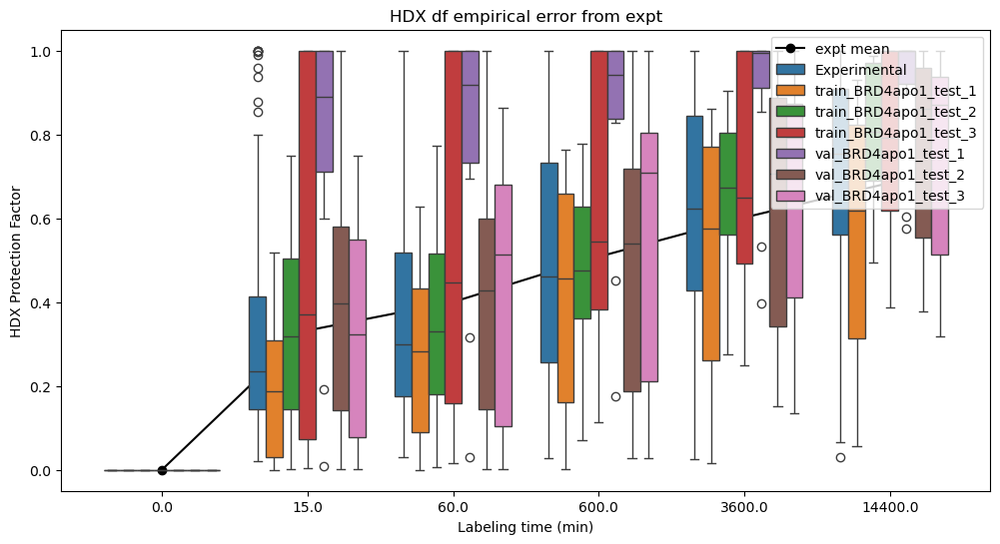

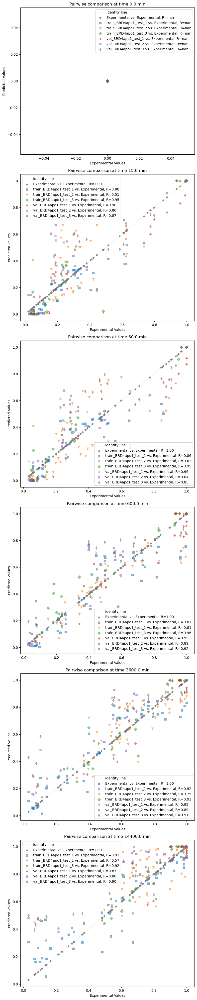

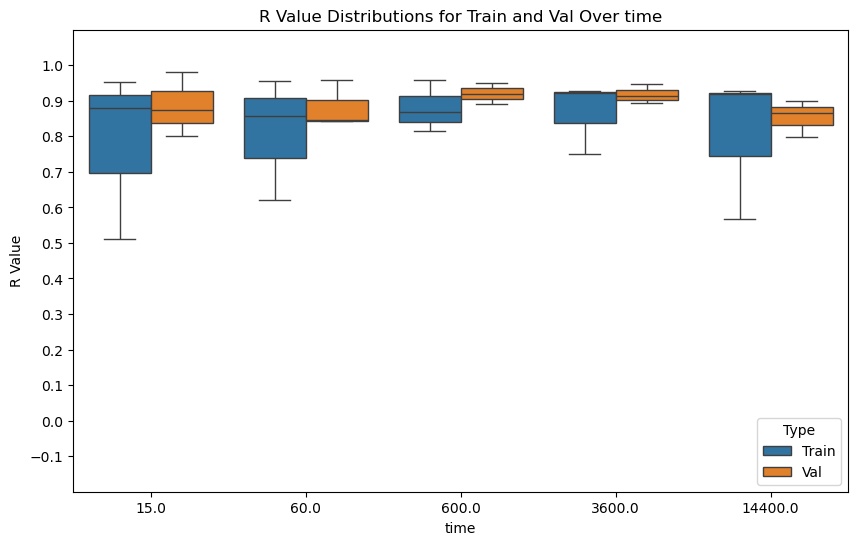

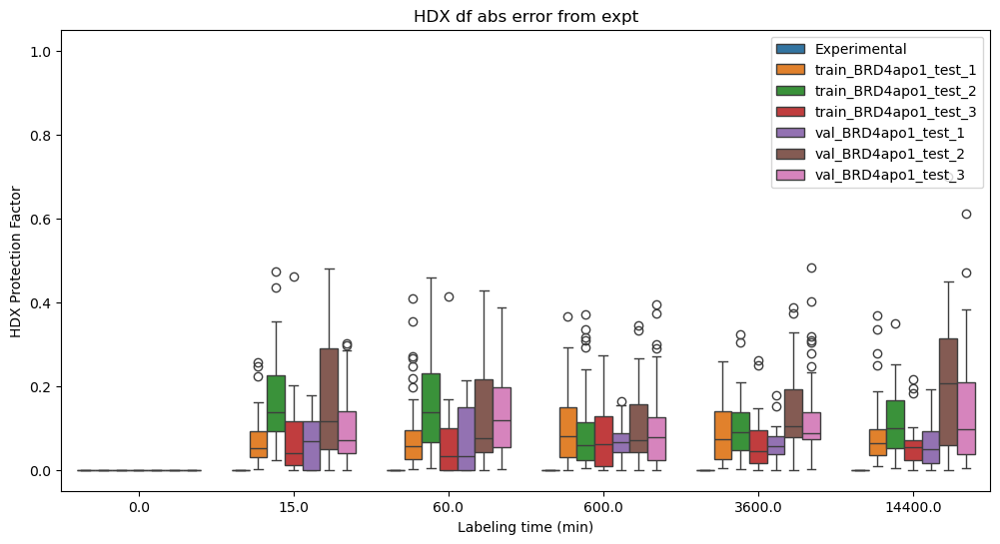

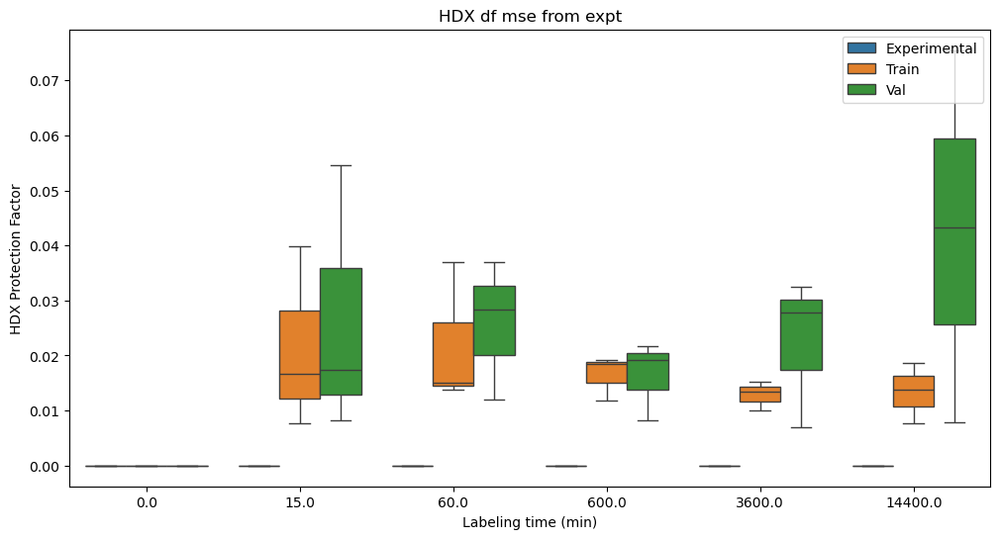

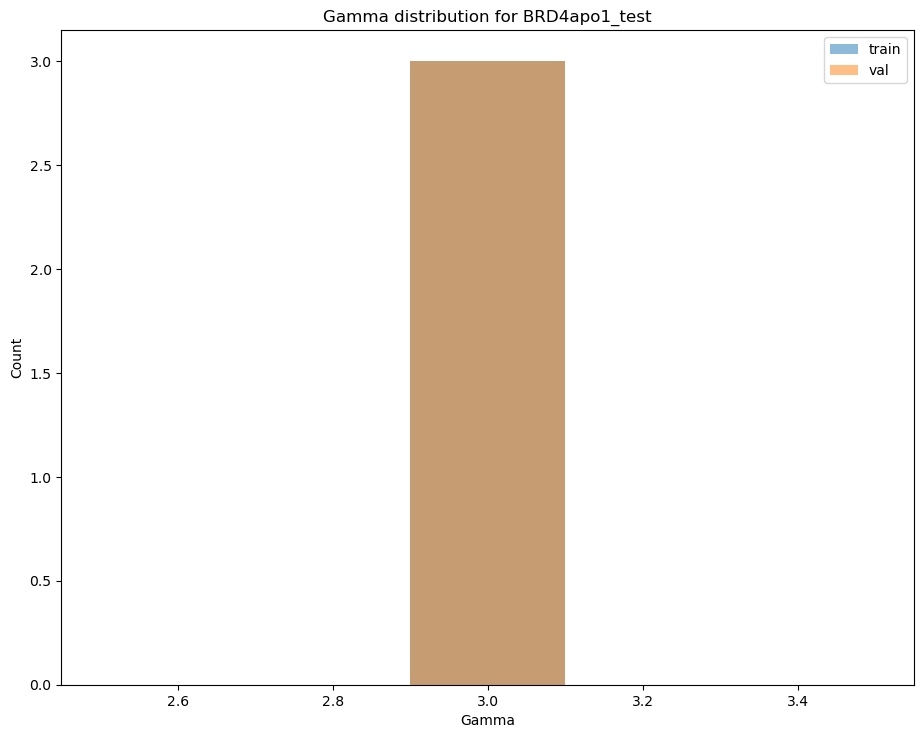

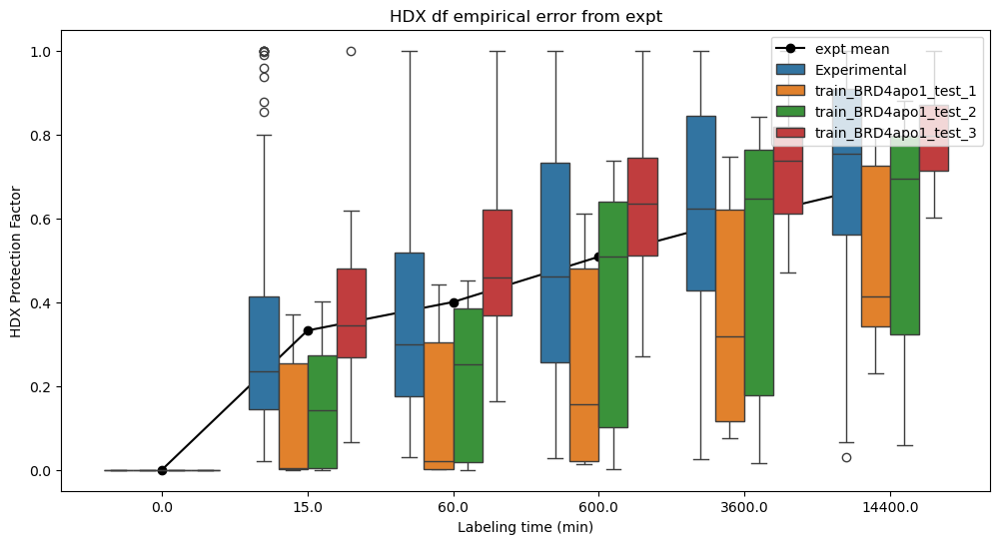

plotting dfracs compare for val
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
551  0.0  0.026287  0.083760  0.251987  0.457552  0.593911       99   
552  0.0  0.804497  0.832839  0.840253  0.868431  0.918761      100   
553  0.0  0.877457  0.907847  0.909839  0.913488  0.925442      101   
554  0.0  0.920707  0.940372  0.941660  0.944021  0.951757      102   
555  0.0  1.000000  1.000000  1.000000  1.000000  1.000000      103   

                calc_name  ResStr  ResEnd path  
0            Experimental     NaN     NaN  NaN

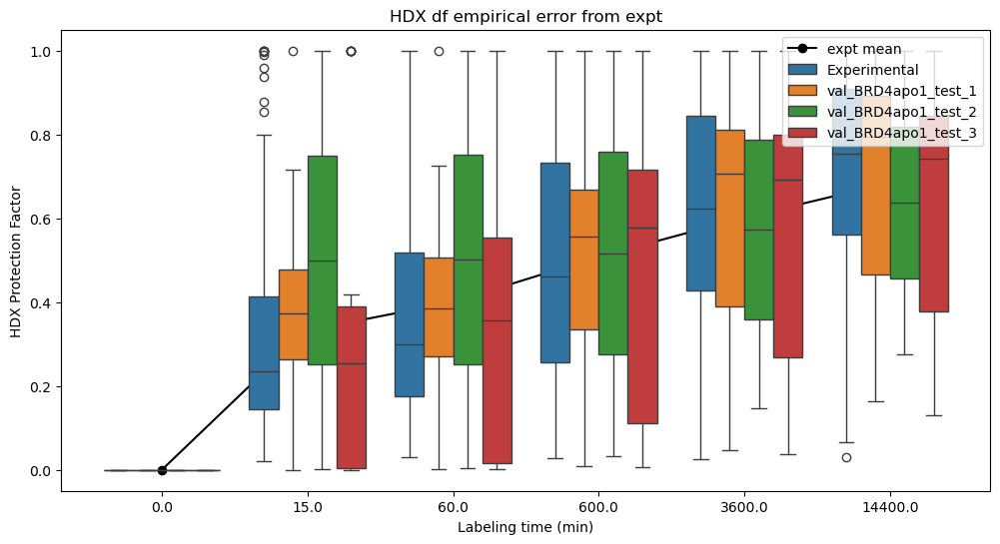

Restoring trainval peptide numbers
train_rep_names ['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
val_rep_names ['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
test_rep_names ['test_BRD4apo1_test_1', 'test_BRD4apo1_test_2', 'test_BRD4apo1_test_3']
train_rep_peptides [47, 48, 49, 50, 51, 52, 53, 78, 79, 80, 81, 82, 83, 84, 85, 99]
val_rep_peptides [7, 8, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 56, 57, 58, 61, 62, 63, 64, 65, 66, 67, 68, 89, 91, 92, 93, 94, 103]
test_rep_peptides [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99,

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


plotting R agreement
plotting paired trainval agreement
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
239  0.0  0.261820  0.347517  0.461175  0.513392  0.549543       82   
240  0.0  0.276366  0.366823  0.486795  0.541911  0.580060       83   
241  0.0  0.205892  0.283619  0.385068  0.450293  0.496073       84   
242  0.0  0.000576  0.002291  0.021403  0.091383  0.167846       85   
243  0.0  0.026287  0.083760  0.251987  0.457552  0.593911       99   

               calc_name  ResStr  ResEnd  \
0           Experimental     NaN     NaN   
1  

/home/alexi/Documents/ValDX/ValDX/ValidationDX.py:1358: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dump["name"] = [name]*len(dump)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:929: UserWarning: Reader has no dt information, set to 1.0 ps
  pickle.dump(self, f)


{'r_naive_random_BRD4apo1_test': {'train_dfs': [    0.0     15.0     60.0    600.0   3600.0  14400.0  peptide  \
0   0.0  0.00720  0.02623  0.11360  0.18753  0.27722       30   
1   0.0  0.58838  0.68222  0.78634  0.88065  0.95326       65   
2   0.0  0.36966  0.45844  0.70917  0.78658  0.81348       64   
3   0.0  0.00130  0.00518  0.04929  0.22969  0.46505       53   
4   0.0  0.00059  0.00236  0.02277  0.11405  0.28293       45   
5   0.0  0.34995  0.49979  0.70816  0.76318  0.79578       93   
6   0.0  0.36503  0.54759  0.74059  0.78949  0.81847       91   
7   0.0  0.34579  0.51322  0.71651  0.76660  0.82430       47   
8   0.0  0.23445  0.36586  0.57649  0.66503  0.73021       10   
9   0.0  1.00000  1.00000  1.00000  1.00000  1.00000        0   
10  0.0  0.37979  0.54980  0.79064  0.86456  0.91087       18   
11  0.0  0.06251  0.10856  0.21300  0.31977  0.39768       31   
12  0.0  0.16847  0.26239  0.43092  0.56156  0.65113       88   
13  0.0  0.18798  0.27181  0.41912  0.5134

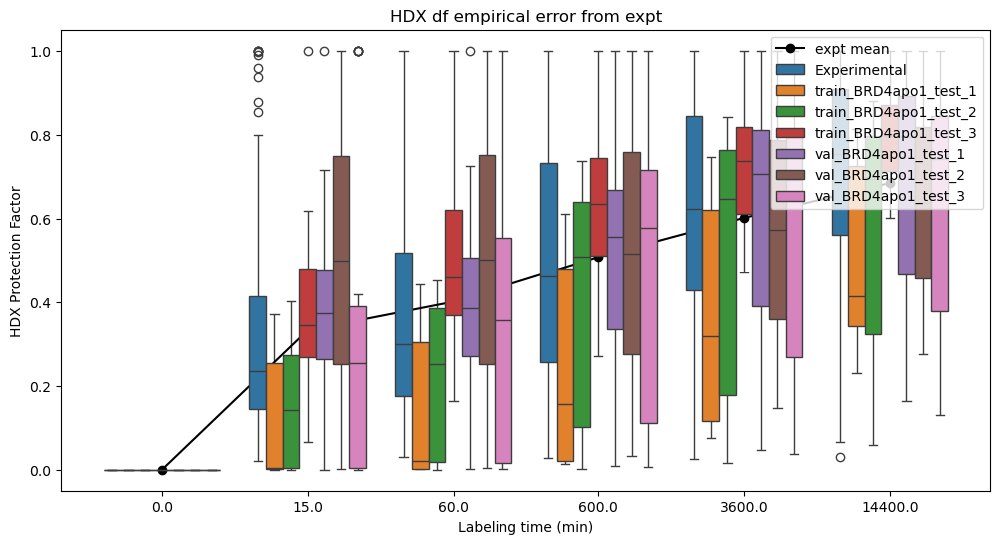

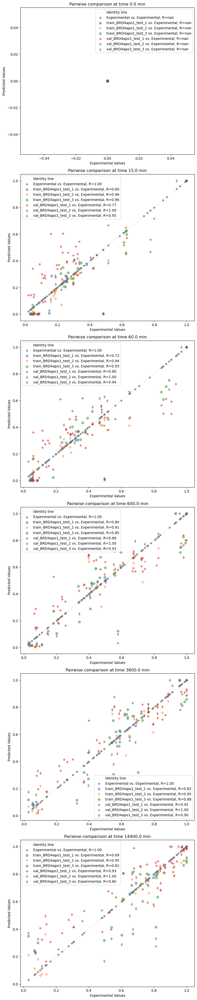

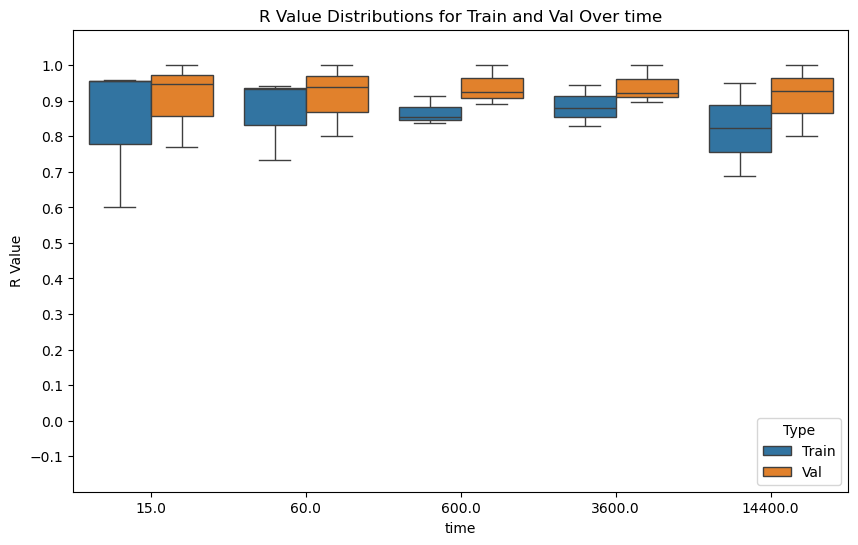

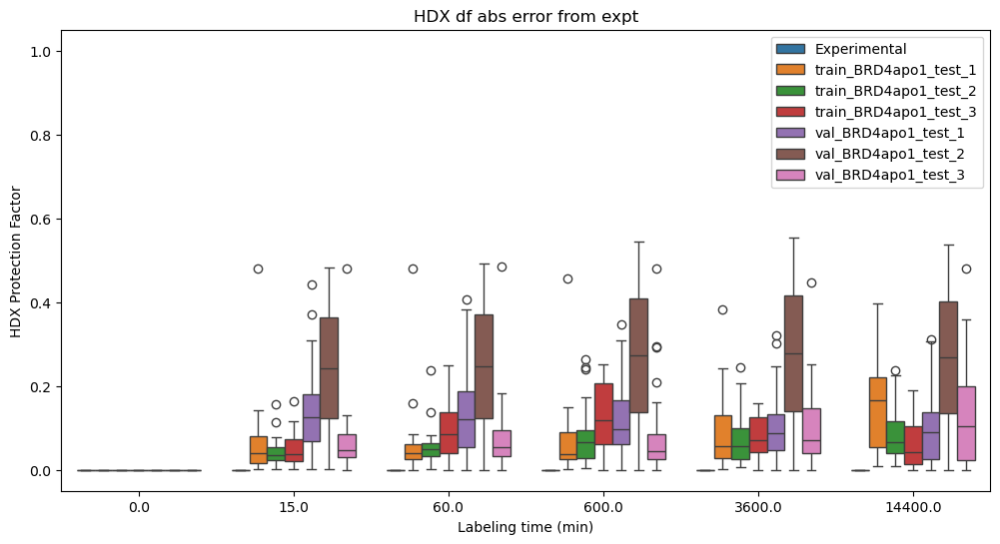

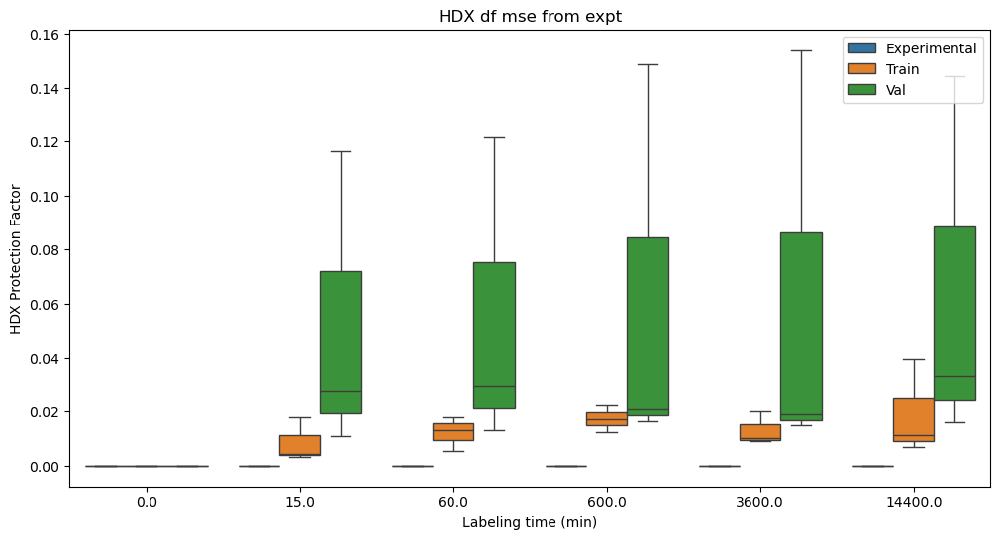

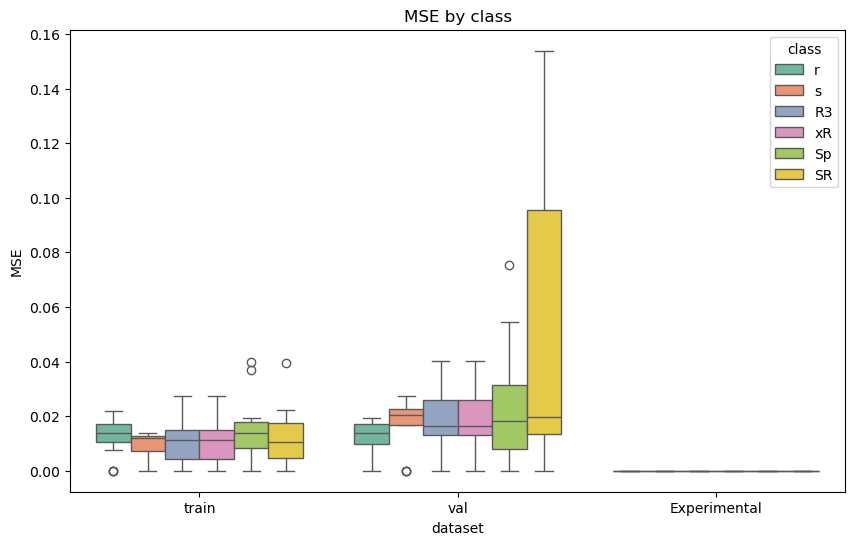

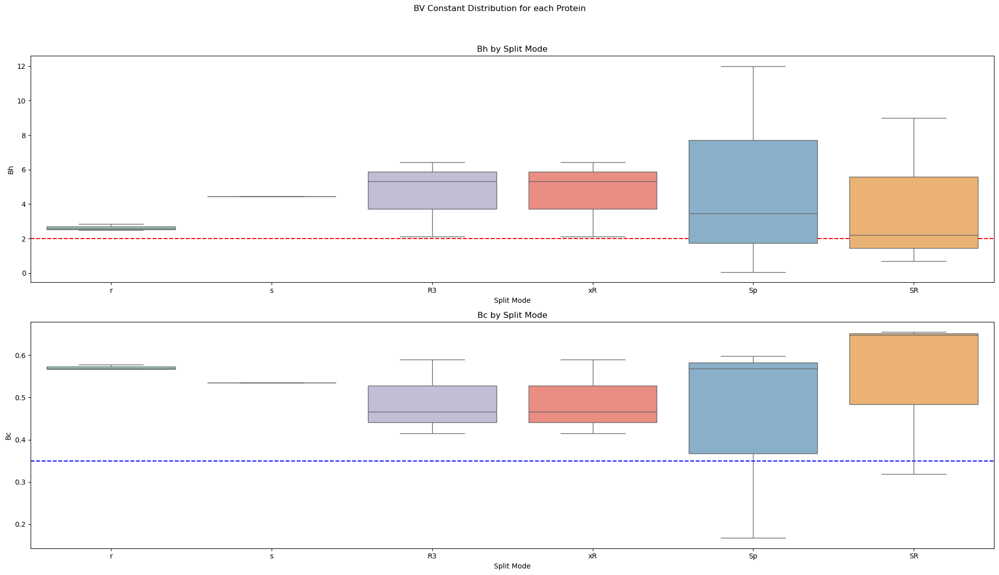

In [ ]:
combined_analysis_dump, names, save_paths = VDX.run_refine_ensemble(system=test_name,
                                                                    times=[0.0, 15.0, 60.0, 600.0, 3600.0, 14400.0],
                                                                    expt_name=expt_name,
                                                                    n_reps=3,
                                                                    split_mode=['R3'],
                                                                    hdx_path=hdx_path,
                                                                    segs_path=segs_path,
                                                                    traj_paths=traj_paths,
                                                                    top_path=top_path)
                                                                    

In [ ]:
# # BPTI data
# BPTI_dir = "/Users/alexi/Library/CloudStorage/OneDrive-Nexus365/Rotation_Projects/Rotation_3/Project/ValDX/raw_data/HDXer_tutorial/BPTI"
# # BPTI_dir = "/home/alexi/Documents/ValDX/raw_data/HDXer_tutorial/BPTI"


In [ ]:
# expt_dir = os.path.join(BPTI_dir, "BPTI_expt_data")

# os.listdir(expt_dir)

# segs_name = "BPTI_residue_segs.txt"
# segs_path = os.path.join(expt_dir, segs_name)

# hdx_name = "BPTI_expt_dfracs.dat"
# hdx_path = os.path.join(expt_dir, hdx_name)
# print(hdx_path)

# rates_name = "BPTI_Intrinsic_rates.dat"
# rates_path = os.path.join(expt_dir, rates_name)


In [ ]:
# sim_name = 'BPTI_MD'

# sim_dir = os.path.join(BPTI_dir, "BPTI_simulations")

# os.listdir(sim_dir)

# md_reps = 1
# rep_dirs = ["Run_"+str(i+1) for i in range(md_reps)]

# top_name = "bpti_5pti_eq6_protonly.gro"

# top_path = os.path.join(sim_dir, rep_dirs[0], top_name)

# traj_name = "bpti_5pti_reimg_protonly.xtc"

# traj_paths = [os.path.join(sim_dir, rep_dir, traj_name) for rep_dir in rep_dirs]

# print(top_path)
# print(traj_paths)




In [ ]:
def run_split_test(split_mode, name, system):

    # settings.split_mode = 'R'
    settings.split_mode = split_mode
    settings.name = "_".join([name, split_mode])
    settings.times = [0.0, 15.0, 60.0, 600.0, 3600.0, 14400.0]
    VDX = ValDXer(settings)

    VDX.load_HDX_data(HDX_path=hdx_path, SEG_path=segs_path, calc_name=expt_name)
    # VDX.load_intrinsic_rates(path=rates_path, calc_name=expt_name)

    VDX.load_structures(top_path=top_path, traj_paths=traj_paths, calc_name=test_name)

    run_outputs = VDX.run_VDX(calc_name=test_name, expt_name=expt_name)
    analysis_dump, df, name = VDX.dump_analysis()
    save_path = VDX.save_experiment()

    return run_outputs, analysis_dump, df, name, save_path

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
Preparing HDX data for Experimental
Path /home/alexi/Docu

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/AvsB_S/train_BRD4apo1_test_1/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
0.9999999999999999
Finished reweighting
[(array([0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.009

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_1
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_1
    ResStr  ResEnd  peptide                                               path
0        1      26        0  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
1        5      26        1  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
2       12      26        2  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
3       15      26        3  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
4       27      40        4  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
5      365     371       59  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
6      372     378       62  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
7      390     399       71  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
8      391     399       72  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
9      391     400       73  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
10     391     404       74  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
11     391     406

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(112,)
[4.14572615e-02 0.00000000e+00 1.18449319e-02 4.73797275e-02
 1.12526853e-01 1.53984114e-01 3.55347956e-02 4.14572615e-02
 7.02168866e-02 1.00681921e-01 1.18449319e-01 1.12526853e-01
 2.41968399e-01 2.54666035e-01 2.05580898e-01 1.89518910e-01
 1.88666205e-01 1.71751512e-01 7.69920571e-02 7.69920571e-02
 1.77673978e-02 2.96123297e-02 2.96123297e-02 1.77673978e-02
 0.00000000e+00 0.00000000e+00 2.36898637e-02 2.36898637e-02
 1.18449319e-01 7.69920571e-02 1.71751512e-01 3.25735626e-01
 5.86324127e-01 7.81765503e-01 9.53517015e-01 1.93579064e+01
 1.86372568e+01 6.10260509e+00 3.50183631e+00 1.50407075e+01
 1.54908149e+01 9.73568129e+00 1.08349040e+01 2.04497173e+01
 1.43856698e+01 1.02130451e+01 1.83226064e+01 1.36927412e+01
 1.70791673e+01 1.21698148e+01 8.31656878e+00 1.17566851e+01
 1.85975514e+01 9.55123214e+00 5.31245194e+00 1.34084629e+01
 1.78325449e+01 2.24674798e+01 1.98405095e+01 1.61627511e+01
 2.23997746e+01 2.05637637e+01 1.66667811e+01 2.09013442e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[4.14572615e-02 0.00000000e+00 1.18449319e-02 4.73797275e-02
 1.12526853e-01 1.53984114e-01 3.55347956e-02 4.14572615e-02
 7.02168866e-02 1.00681921e-01 1.18449319e-01 1.12526853e-01
 2.41968399e-01 2.54666035e-01 2.05580898e-01 1.89518910e-01
 1.88666205e-01 1.71751512e-01 7.69920571e-02 7.69920571e-02
 1.77673978e-02 2.96123297e-02 2.96123297e-02 1.77673978e-02
 0.00000000e+00 0.00000000e+00 2.36898637e-02 2.36898637e-02
 1.18449319e-01 7.69920571e-02 1.71751512e-01 3.25735626e-01
 5.86324127e-01 7.81765503e-01 9.53517015e-01 8.17300299e-01
 1.49838388e+00 2.22684719e+00 5.80401661e+00 5.47235852e+00
 9.04360548e+00 9.53517015e+00 1.06722836e+01 1.14303593e+00
 6.45075968e+00 4.50107411e+00 1.14955064e+01 1.40226939e+01
 1.84526984e+01 1.88396128e+01 1.79721260e+01 1.81694750e+01
 1.83690869e+01 1.76913677e+01 1.98826801e+01 2.10739484e+01
 1.78808866e+01 1.92015965e+01 2.33295553e+01 2.03327875e+01
 1.54067526e+01 1.58731706e+01 1.76558329e+01 1.62936657e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory: <Universe with 4155 atoms>
BRD4apo1_test Traj: no frames 110
Topology <Universe with 4155 atoms>
Writing train PDB to results/AvsB_S/train_1_AvsB_S_20240229-164744.pdb
Writing val PDB to results/AvsB_S/val_1_AvsB_S_20240229-164744.pdb
Splitting segments for BRD4apo1_test by spatial split: PCA1D
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 14

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_segs["calc_name

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/AvsB_S/train_BRD4apo1_test_2/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
0.9999999999999999
Finished reweighting
[(array([0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.009

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_2
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_2
    ResStr  ResEnd  peptide                                               path
29       1      26        0  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
30       5      26        1  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
31      12      26        2  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
32      15      26        3  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
33      27      40        4  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
34     365     371       59  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
35     372     378       62  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
36     390     399       71  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
37     391     399       72  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
38     391     400       73  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
39     391     404       74  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
40     391     406

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(112,)
[4.14572615e-02 0.00000000e+00 1.18449319e-02 4.73797275e-02
 1.12526853e-01 1.53984114e-01 3.55347956e-02 4.14572615e-02
 7.02168866e-02 1.00681921e-01 1.18449319e-01 1.12526853e-01
 2.41968399e-01 2.54666035e-01 2.05580898e-01 1.89518910e-01
 1.88666205e-01 1.71751512e-01 7.69920571e-02 7.69920571e-02
 1.77673978e-02 2.96123297e-02 2.96123297e-02 1.77673978e-02
 0.00000000e+00 0.00000000e+00 2.36898637e-02 2.36898637e-02
 1.18449319e-01 7.69920571e-02 1.71751512e-01 3.25735626e-01
 5.86324127e-01 7.81765503e-01 9.53517015e-01 1.93579064e+01
 1.86372568e+01 6.10260509e+00 3.50183631e+00 1.50407075e+01
 1.54908149e+01 9.73568129e+00 1.08349040e+01 2.04497173e+01
 1.43856698e+01 1.02130451e+01 1.83226064e+01 1.36927412e+01
 1.70791673e+01 1.21698148e+01 8.31656878e+00 1.17566851e+01
 1.85975514e+01 9.55123214e+00 5.31245194e+00 1.34084629e+01
 1.78325449e+01 2.24674798e+01 1.98405095e+01 1.61627511e+01
 2.23997746e+01 2.05637637e+01 1.66667811e+01 2.09013442e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[4.14572615e-02 0.00000000e+00 1.18449319e-02 4.73797275e-02
 1.12526853e-01 1.53984114e-01 3.55347956e-02 4.14572615e-02
 7.02168866e-02 1.00681921e-01 1.18449319e-01 1.12526853e-01
 2.41968399e-01 2.54666035e-01 2.05580898e-01 1.89518910e-01
 1.88666205e-01 1.71751512e-01 7.69920571e-02 7.69920571e-02
 1.77673978e-02 2.96123297e-02 2.96123297e-02 1.77673978e-02
 0.00000000e+00 0.00000000e+00 2.36898637e-02 2.36898637e-02
 1.18449319e-01 7.69920571e-02 1.71751512e-01 3.25735626e-01
 5.86324127e-01 7.81765503e-01 9.53517015e-01 8.17300299e-01
 1.49838388e+00 2.22684719e+00 5.80401661e+00 5.47235852e+00
 9.04360548e+00 9.53517015e+00 1.06722836e+01 1.14303593e+00
 6.45075968e+00 4.50107411e+00 1.14955064e+01 1.40226939e+01
 1.84526984e+01 1.88396128e+01 1.79721260e+01 1.81694750e+01
 1.83690869e+01 1.76913677e+01 1.98826801e+01 2.10739484e+01
 1.78808866e+01 1.92015965e+01 2.33295553e+01 2.03327875e+01
 1.54067526e+01 1.58731706e+01 1.76558329e+01 1.62936657e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory: <Universe with 4155 atoms>
BRD4apo1_test Traj: no frames 110
Topology <Universe with 4155 atoms>
Writing train PDB to results/AvsB_S/train_2_AvsB_S_20240229-164907.pdb
Writing val PDB to results/AvsB_S/val_2_AvsB_S_20240229-164907.pdb
Splitting segments for BRD4apo1_test by spatial split: PCA1D
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 14

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_segs["calc_name

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/AvsB_S/train_BRD4apo1_test_3/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
0.9999999999999999
Finished reweighting
[(array([0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.009

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_3
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_3
    ResStr  ResEnd  peptide                                               path
58       1      26        0  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
59       5      26        1  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
60      12      26        2  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
61      15      26        3  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
62      27      40        4  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
63     365     371       59  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
64     372     378       62  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
65     390     399       71  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
66     391     399       72  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
67     391     400       73  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
68     391     404       74  /home/alexi/Documents/ValDX/data/AvsB_S/val_BR...
69     391     406

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(112,)
[4.14572615e-02 0.00000000e+00 1.18449319e-02 4.73797275e-02
 1.12526853e-01 1.53984114e-01 3.55347956e-02 4.14572615e-02
 7.02168866e-02 1.00681921e-01 1.18449319e-01 1.12526853e-01
 2.41968399e-01 2.54666035e-01 2.05580898e-01 1.89518910e-01
 1.88666205e-01 1.71751512e-01 7.69920571e-02 7.69920571e-02
 1.77673978e-02 2.96123297e-02 2.96123297e-02 1.77673978e-02
 0.00000000e+00 0.00000000e+00 2.36898637e-02 2.36898637e-02
 1.18449319e-01 7.69920571e-02 1.71751512e-01 3.25735626e-01
 5.86324127e-01 7.81765503e-01 9.53517015e-01 1.93579064e+01
 1.86372568e+01 6.10260509e+00 3.50183631e+00 1.50407075e+01
 1.54908149e+01 9.73568129e+00 1.08349040e+01 2.04497173e+01
 1.43856698e+01 1.02130451e+01 1.83226064e+01 1.36927412e+01
 1.70791673e+01 1.21698148e+01 8.31656878e+00 1.17566851e+01
 1.85975514e+01 9.55123214e+00 5.31245194e+00 1.34084629e+01
 1.78325449e+01 2.24674798e+01 1.98405095e+01 1.61627511e+01
 2.23997746e+01 2.05637637e+01 1.66667811e+01 2.09013442e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[4.14572615e-02 0.00000000e+00 1.18449319e-02 4.73797275e-02
 1.12526853e-01 1.53984114e-01 3.55347956e-02 4.14572615e-02
 7.02168866e-02 1.00681921e-01 1.18449319e-01 1.12526853e-01
 2.41968399e-01 2.54666035e-01 2.05580898e-01 1.89518910e-01
 1.88666205e-01 1.71751512e-01 7.69920571e-02 7.69920571e-02
 1.77673978e-02 2.96123297e-02 2.96123297e-02 1.77673978e-02
 0.00000000e+00 0.00000000e+00 2.36898637e-02 2.36898637e-02
 1.18449319e-01 7.69920571e-02 1.71751512e-01 3.25735626e-01
 5.86324127e-01 7.81765503e-01 9.53517015e-01 8.17300299e-01
 1.49838388e+00 2.22684719e+00 5.80401661e+00 5.47235852e+00
 9.04360548e+00 9.53517015e+00 1.06722836e+01 1.14303593e+00
 6.45075968e+00 4.50107411e+00 1.14955064e+01 1.40226939e+01
 1.84526984e+01 1.88396128e+01 1.79721260e+01 1.81694750e+01
 1.83690869e+01 1.76913677e+01 1.98826801e+01 2.10739484e+01
 1.78808866e+01 1.92015965e+01 2.33295553e+01 2.03327875e+01
 1.54067526e+01 1.58731706e+01 1.76558329e+01 1.62936657e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory: <Universe with 4155 atoms>
BRD4apo1_test Traj: no frames 110
Topology <Universe with 4155 atoms>
Writing train PDB to results/AvsB_S/train_3_AvsB_S_20240229-165031.pdb
Writing val PDB to results/AvsB_S/val_3_AvsB_S_20240229-165031.pdb
Finished running VDX loop
Evaluating HDX
plotting gamma distributions
['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
plotting dfracs compare for train
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000 

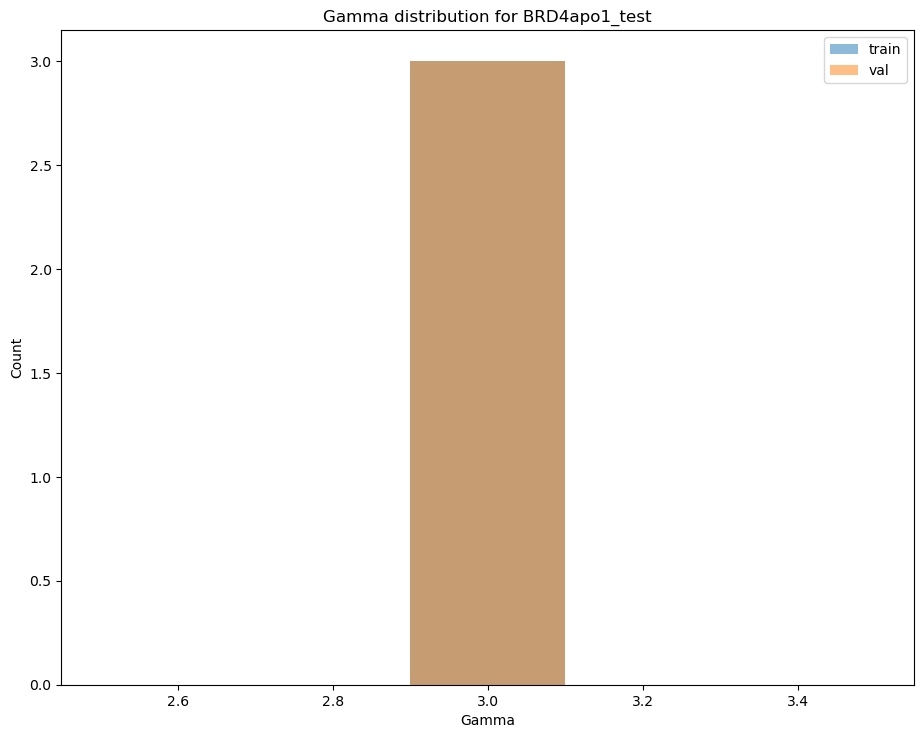

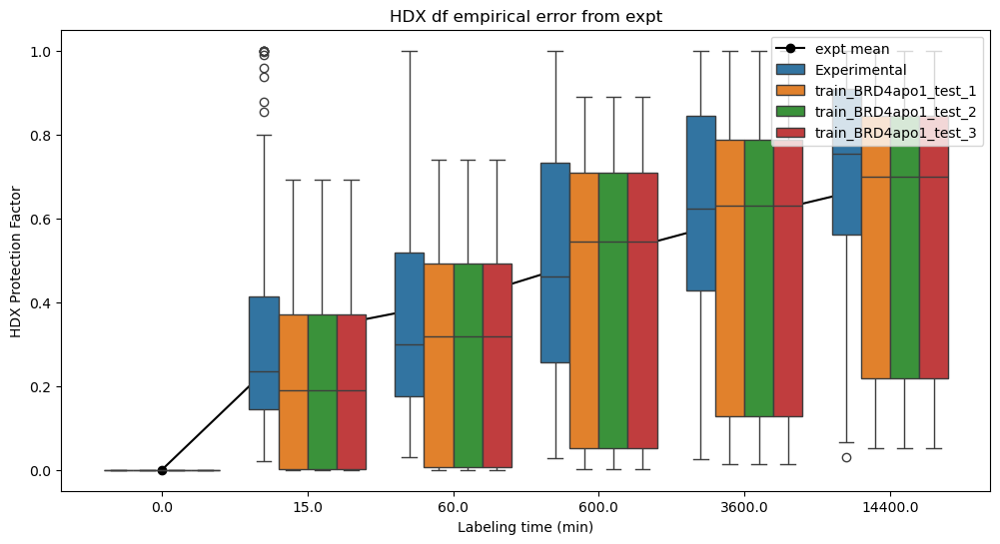

plotting dfracs compare for val
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
615  0.0  0.009133  0.033507  0.155815  0.301658  0.467570       99   
616  0.0  0.771977  0.809584  0.836324  0.849986  0.885274      100   
617  0.0  0.842081  0.882880  0.909378  0.910803  0.915748      101   
618  0.0  0.897817  0.924217  0.941362  0.942284  0.945484      102   
619  0.0  1.000000  1.000000  1.000000  1.000000  1.000000      103   

                calc_name  ResStr  ResEnd path  
0            Experimental     NaN     NaN  NaN

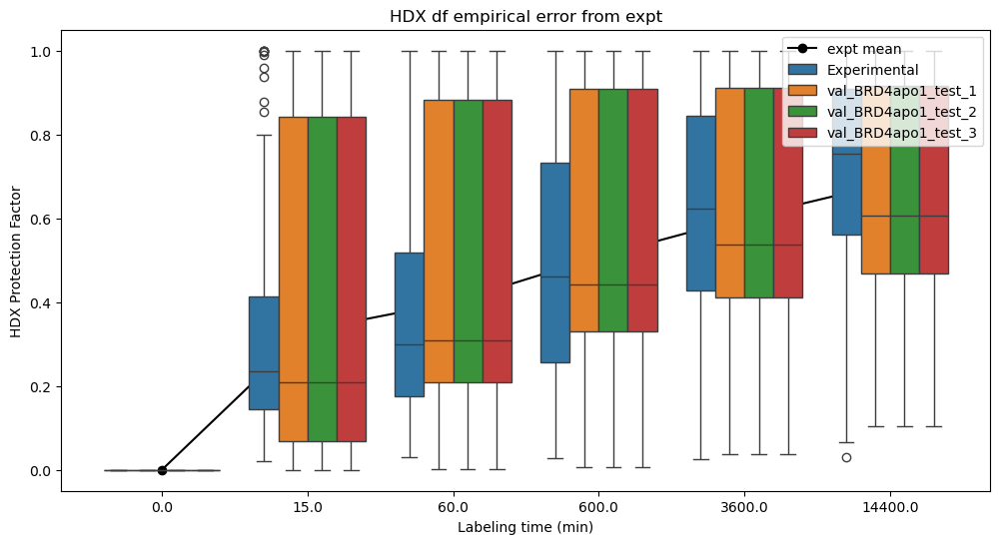

Restoring trainval peptide numbers
train_rep_names ['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
val_rep_names ['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
test_rep_names ['test_BRD4apo1_test_1', 'test_BRD4apo1_test_2', 'test_BRD4apo1_test_3']
train_rep_peptides [7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 24, 25, 27, 28, 29, 30, 36, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58]
val_rep_peptides [0, 1, 2, 3, 4, 59, 62, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 97, 98, 99, 100, 101, 102, 103]
test_rep_peptides [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


val_BRD4apo1_test_1 values
221    1.000000
222    1.000000
223    1.000000
224    1.000000
225    1.000000
226    0.485156
227    0.457482
228    0.558483
229    0.627010
230    0.557352
231    0.395259
232    0.351096
233    0.329153
234    0.419570
235    0.035766
236    0.031296
237    0.035754
238    0.442483
239    0.419203
240    0.442492
241    0.350631
242    0.006856
243    0.025637
244    0.106724
245    0.155815
246    0.836324
247    0.909378
248    0.941362
249    1.000000
Name: 600.0, dtype: float64
[  0   1   2   3   4  59  62  71  72  73  74  75  76  77  78  79  80  81
  82  83  84  85  97  98  99 100 101 102 103]
Values to compute R values
[0.95687, 0.93472, 0.99807, 0.92883, 1.0, 0.82995, 0.18231, 0.75748, 0.69493, 0.61914, 0.45083, 0.41712, 0.35811, 0.38847, 0.57848, 0.20102, 0.15004, 0.50275, 0.4176, 0.45312, 0.4046, 0.11066, 0.2156, 0.23121, 0.34088, 0.92541, 0.99768, 1.0, 1.0]
[1.0, 1.0, 1.0, 1.0, 1.0, 0.4851560984848638, 0.4574819264012315, 0.5584825902676269, 0.

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


plotting R agreement
plotting paired trainval agreement
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
303  0.0  0.009133  0.033507  0.155815  0.301658  0.467570       99   
304  0.0  0.771977  0.809584  0.836324  0.849986  0.885274      100   
305  0.0  0.842081  0.882880  0.909378  0.910803  0.915748      101   
306  0.0  0.897817  0.924217  0.941362  0.942284  0.945484      102   
307  0.0  1.000000  1.000000  1.000000  1.000000  1.000000      103   

               calc_name  ResStr  ResEnd  \
0           Experimental     NaN     NaN   
1  

/home/alexi/Documents/ValDX/ValDX/ValidationDX.py:1358: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dump["name"] = [name]*len(dump)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:929: UserWarning: Reader has no dt information, set to 1.0 ps
  pickle.dump(self, f)


Preparing HDX data for Experimental
Path /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO/BRD4_APO.dat
AVG: ncol = 8, len(names) = 6
                                                 HDX  \
0  /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4...   
1                                                NaN   

                                                 SEG      calc_name  \
0  /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4...   Experimental   
1                                                NaN  BRD4apo1_test   

  experimental                                                top  \
0        False                                                NaN   
1          NaN  /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4...   

                                                traj  
0                                                NaN  
1  [/home/alexi/Documents/ValDX/raw_data/BRD4/BRD...  
Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A

train_segs
    ResStr  ResEnd  peptide              calc_name
47     136     148       47  train_BRD4apo1_test_1
48     138     148       48  train_BRD4apo1_test_1
49     144     151       49  train_BRD4apo1_test_1
50     148     155       50  train_BRD4apo1_test_1
51     149     155       51  train_BRD4apo1_test_1
Saved train BRD4apo1_test_1 segments to /home/alexi/Documents/ValDX/data/LvsX_SR/train_BRD4apo1_test_1/train_residue_segs__BRD4apo1_test_.txt
Train Peptide numbers: [47 48 49 50 51 52 53 78 79 80 81 82 83 84 85 99]
Saved val BRD4apo1_test_1 segments to /home/alexi/Documents/ValDX/data/LvsX_SR/val_BRD4apo1_test_1/val_residue_segs__BRD4apo1_test_.txt
Val Peptide numbers: [  7   8  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32
  33  34  35  36  37  38  39  40  41  42  43  44  45  56  57  58  61  62
  63  64  65  66  67  68  89  91  92  93  94 103]
train_HDX_data
    0.0     15.0     60.0    600.0   3600.0  14400.0  peptide  \
0   0.0  0.30735  0.37942  0.49720 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/LvsX_SR/train_BRD4apo1_test_1/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
0.9999999999999999
Finished reweighting
[(array([0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_1
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_1
    ResStr  ResEnd  peptide                                               path
0       66      72        7  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
1       68      74        8  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
2       82      88       17  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
3       89     102       18  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
4       89     106       19  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
5       92      99       20  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
6       92     102       21  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
7       92     106       22  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
8       92     117       23  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
9       93     102       24  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
10      98     111       25  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
11      98     117

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(111,)
[17.29435692 17.74182209 16.41211198 16.99418482 18.81348874 17.49273152
  8.18624231 15.52725685 16.31292468 12.59567119 13.50114496  6.18615535
  4.12932395  4.35902086 11.53762636  5.05594216 11.65636758 12.18065064
 12.17282007 13.36419     4.20240933 11.99545531  4.83929621  4.00027656
 16.07824463 15.30878314  3.21314651  1.77754084  5.58059078  7.82013563
 17.48829357 16.6161495  17.51771112 18.32987209 17.08815174 16.58177447
 19.83668406 19.07189776 14.8459967  13.29554257 12.4831187  15.7316086
  5.71110038 13.90972015  6.6011759  13.57950205  3.89962705 15.16146439
  8.84891688 18.71654608 16.64963946 18.2887888  19.00664296 18.16877128
 17.12208424 17.90887439 17.46401941 12.77240749 12.87942537 14.15132004
  1.92893199  2.43269907  3.43425608 12.83807917  4.53202465 12.07702539
  1.30321698  1.19732142 14.38477512 14.58314972  4.36833931 12.60872215
 15.52772505  6.34015669 12.33465198 15.75363812  6.03476421  3.29294015
  2.84249923  5.23865561  

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[1.82713449e-02 0.00000000e+00 5.22038426e-03 2.08815371e-02
 4.95936505e-02 6.78649954e-02 1.56611528e-02 1.82713449e-02
 1.08505750e-01 4.43732662e-02 5.22038426e-02 4.95936505e-02
 1.84201322e-01 1.12238262e-01 2.45723613e-01 8.35261482e-02
 1.60709592e-01 7.56955718e-02 3.39324977e-02 3.39324977e-02
 7.83057640e-03 1.30509607e-02 1.30509607e-02 7.83057640e-03
 0.00000000e+00 0.00000000e+00 1.04407685e-02 1.04407685e-02
 5.22038426e-02 3.39324977e-02 7.56955718e-02 1.43560567e-01
 2.58409021e-01 3.44545361e-01 4.20240933e-01 3.60206514e-01
 6.60378609e-01 9.81432242e-01 2.55798829e+00 2.41181753e+00
 3.98576339e+00 4.20240933e+00 4.70356622e+00 5.03767081e-01
 8.65996966e+00 1.98374602e+00 5.06638293e+00 6.33530186e+00
 8.28772557e+00 1.52834636e+01 8.15348345e+00 1.56085897e+01
 1.63945974e+01 1.63285858e+01 1.72943569e+01 1.77418221e+01
 1.64121120e+01 1.69941848e+01 1.88134887e+01 1.74927315e+01
 8.18624231e+00 1.55272568e+01 1.63129247e+01 1.57125805e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory: <Universe with 4155 atoms>
BRD4apo1_test Traj: no frames 110
Topology <Universe with 4155 atoms>
Writing train PDB to results/LvsX_SR/train_1_LvsX_SR_20240229-165149.pdb
Writing val PDB to results/LvsX_SR/val_1_LvsX_SR_20240229-165149.pdb
Splitting segments for BRD4apo1_test by spatial split: PCA1D and redundancy aware
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithC

Saved train BRD4apo1_test HDX data to /home/alexi/Documents/ValDX/data/LvsX_SR/train_BRD4apo1_test_2/train_BRD4apo1_test_2_expt_dfracs.dat
   ResStr  ResEnd  0.0     15.0     60.0    600.0   3600.0  14400.0  peptide  \
0     400     406  0.0  0.48354  0.49634  0.57848  0.70134  0.81139       78   
1     468     477  0.0  0.99813  1.00000  1.00000  1.00000  1.00000      103   

             calc_name                                               path  
0  val_BRD4apo1_test_2  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...  
1  val_BRD4apo1_test_2  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...  
#	ResStr	ResEnd	0.0	15.0	60.0	600.0	3600.0	14400.0	 times/min

Saved val BRD4apo1_test HDX data to /home/alexi/Documents/ValDX/data/LvsX_SR/val_BRD4apo1_test_2/val_BRD4apo1_test_2_expt_dfracs.dat
/home/alexi/Documents/ValDX/data/LvsX_SR/train_BRD4apo1_test_2
BRD4apo1_test
/home/alexi/Documents/ValDX/data/LvsX_SR/train_BRD4apo1_test_2/out__train_BRD4apo1_test_2
envs ['# conda environments:'

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/LvsX_SR/train_BRD4apo1_test_2/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
0.9999999999999999
Finished reweighting
[(array([0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_2
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_2
    ResStr  ResEnd  peptide                                               path
48     400     406       78  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
49     468     477      103  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
Residues for recalculation: [400 401 402 403 404 405 406 468 469 470 471 472 473 474 475 476 477]
[400 401 402 403 404 405 406 468 469 470 471 472 473 474 475 476 477]
dict_keys([2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 36, 38, 39, 40, 41, 42, 43, 44, 49, 50, 51, 52, 54, 55, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 83, 84, 85, 87, 88, 89, 90, 91, 92, 93, 94, 96, 97, 98, 99, 100, 101, 102, 103, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 143, 144, 14

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(13,)
[23.64907451 20.87075868 16.98111653 23.55207845 21.50126253 17.26414869
 21.86830735  2.10567815  1.82234531  1.32651284  1.34583099  1.35870976
  0.86287729]
LogPf_by_res [23.64907451 20.87075868 16.98111653 23.55207845 21.50126253 17.26414869
 21.86830735  2.10567815  1.82234531  1.32651284  1.34583099  1.35870976
  0.86287729]
Pf_by_res [1.86493011e+10 1.15892499e+09 2.37031031e+07 1.69253519e+10
 2.17710649e+09 3.14575222e+07 3.14257181e+09 8.21267058e+00
 6.18635039e+00 3.76788126e+00 3.84137737e+00 3.89116951e+00
 2.36996998e+00]
kints [ 818.07699266 3826.43355208 2151.76171416  373.93332921  680.4468002
 3915.56263922 2305.65421727  252.80995882 2151.76171492 5926.44387567
  729.11188632  252.80995882  620.57485765]
kobs_by_res [4.38663621e-08 3.30170941e-06 9.07797473e-05 2.20930904e-08
 3.12546402e-07 1.24471426e-04 7.33683860e-07 3.07829172e+01
 3.47824093e+02 1.57288499e+03 1.89804806e+02 6.49701737e+01
 2.61849249e+02]
times [[    0.]
 [   15.]
 [ 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[4.50756792e-02 0.00000000e+00 1.28787655e-02 5.15150619e-02
 1.22348272e-01 1.67423951e-01 3.86362964e-02 4.50756792e-02
 6.85516433e-02 1.09469507e-01 1.28787655e-01 1.22348272e-01
 2.55293743e-01 2.76893458e-01 2.07936497e-01 2.06060248e-01
 1.97339298e-01 1.86742099e-01 8.37119756e-02 8.37119756e-02
 1.93181482e-02 3.21969137e-02 3.21969137e-02 1.93181482e-02
 0.00000000e+00 0.00000000e+00 2.57575309e-02 2.57575309e-02
 1.28787655e-01 8.37119756e-02 1.86742099e-01 3.54166051e-01
 6.37498891e-01 8.49998521e-01 1.03674062e+00 8.88634818e-01
 1.62916383e+00 2.42120791e+00 6.31059508e+00 5.94998965e+00
 9.83293744e+00 1.03674062e+01 1.16037677e+01 1.24280087e+00
 6.42924979e+00 4.89393088e+00 1.24988419e+01 1.52310164e+01
 2.00476747e+01 1.97825030e+01 1.95173638e+01 1.89915245e+01
 1.91384144e+01 1.83781619e+01 2.07607335e+01 2.20637704e+01
 1.85842222e+01 2.00202045e+01 2.45084543e+01 2.12501266e+01
 1.66111756e+01 1.64012714e+01 1.83395256e+01 1.68584676e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory: <Universe with 4155 atoms>
BRD4apo1_test Traj: no frames 110
Topology <Universe with 4155 atoms>
Writing train PDB to results/LvsX_SR/train_2_LvsX_SR_20240229-165304.pdb
Writing val PDB to results/LvsX_SR/val_2_LvsX_SR_20240229-165304.pdb
Splitting segments for BRD4apo1_test by spatial split: PCA1D and redundancy aware
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 1

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithC

Saved train BRD4apo1_test HDX data to /home/alexi/Documents/ValDX/data/LvsX_SR/train_BRD4apo1_test_3/train_BRD4apo1_test_3_expt_dfracs.dat
    ResStr  ResEnd  0.0     15.0     60.0    600.0   3600.0  14400.0  peptide  \
0        1      26  0.0  1.00000  1.00000  0.95687  0.96195  0.97437        0   
1        5      26  0.0  1.00000  1.00000  0.93472  0.89664  0.89861        1   
2       12      26  0.0  1.00000  1.00000  0.99807  0.95428  0.94989        2   
3       15      26  0.0  0.93736  0.96691  0.92883  0.95483  0.96986        3   
4       27      40  0.0  1.00000  1.00000  1.00000  1.00000  1.00000        4   
5       75      91  0.0  0.23889  0.33563  0.60965  0.73874  0.81860       12   
6       78      88  0.0  0.18862  0.24845  0.39858  0.54321  0.66430       13   
7       78      91  0.0  0.18665  0.28612  0.55148  0.67617  0.74918       14   
8       79      88  0.0  0.22451  0.29133  0.44498  0.58436  0.69089       15   
9       79      91  0.0  0.18912  0.28667  0.56129 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/LvsX_SR/train_BRD4apo1_test_3/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
0.9999999999999999
Finished reweighting
[(array([0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_3
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_3
    ResStr  ResEnd  peptide                                               path
50       1      26        0  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
51       5      26        1  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
52      12      26        2  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
53      15      26        3  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
54      27      40        4  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
55      75      91       12  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
56      78      88       13  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
57      78      91       14  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
58      79      88       15  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
59      79      91       16  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
60      82      88       17  /home/alexi/Documents/ValDX/data/LvsX_SR/val_B...
61      89     102

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(122,)
[4.35621859e-02 0.00000000e+00 1.24463388e-02 4.97853553e-02
 1.18240219e-01 1.61802405e-01 3.73390165e-02 4.35621859e-02
 5.77312844e-02 1.05793880e-01 1.24463388e-01 1.18240219e-01
 2.38203197e-01 2.67596285e-01 1.83917432e-01 1.99141421e-01
 1.82194673e-01 1.80471913e-01 8.09012024e-02 8.09012024e-02
 1.86695082e-02 3.11158471e-02 3.11158471e-02 1.86695082e-02
 0.00000000e+00 0.00000000e+00 2.48926777e-02 2.48926777e-02
 1.24463388e-01 8.09012024e-02 1.80471913e-01 3.42274318e-01
 6.16093772e-01 8.21458363e-01 1.00193028e+00 1.53553674e+01
 1.15929906e+01 1.22821766e+01 4.85646277e+00 8.65020549e+00
 2.08031375e+01 1.16435500e+01 9.73278695e+00 1.79205805e+01
 1.47489115e+01 9.84505402e+00 1.03926929e+01 1.82633480e+01
 1.20542792e+01 7.09138546e+00 8.74330301e+00 8.72463350e+00
 1.17660406e+01 1.00193028e+01 1.53355745e+01 1.15377561e+01
 7.92965357e+00 8.79143411e+00 1.64023018e+01 7.66072155e+00
 4.23797837e+00 1.33051362e+01 1.86446156e+01 2.29192959e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[4.35621859e-02 0.00000000e+00 1.24463388e-02 4.97853553e-02
 1.18240219e-01 1.61802405e-01 3.73390165e-02 4.35621859e-02
 5.77312844e-02 1.05793880e-01 1.24463388e-01 1.18240219e-01
 2.38203197e-01 2.67596285e-01 1.83917432e-01 1.99141421e-01
 1.82194673e-01 1.80471913e-01 8.09012024e-02 8.09012024e-02
 1.86695082e-02 3.11158471e-02 3.11158471e-02 1.86695082e-02
 0.00000000e+00 0.00000000e+00 2.48926777e-02 2.48926777e-02
 1.24463388e-01 8.09012024e-02 1.80471913e-01 3.42274318e-01
 6.16093772e-01 8.21458363e-01 1.00193028e+00 8.58797379e-01
 1.57446186e+00 2.33991170e+00 6.09870603e+00 5.75020854e+00
 9.50277970e+00 1.00193028e+01 1.12141513e+01 1.20107170e+00
 5.57448021e+00 4.72960876e+00 1.20791718e+01 1.47025717e+01
 1.93575024e+01 1.83515957e+01 1.88364789e+01 1.75190268e+01
 1.75843170e+01 1.68240354e+01 1.91266081e+01 2.03944119e+01
 1.70231768e+01 1.84109436e+01 2.27484927e+01 1.95995690e+01
 1.59000917e+01 1.49135224e+01 1.67866964e+01 1.53553674e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory: <Universe with 4155 atoms>
BRD4apo1_test Traj: no frames 110
Topology <Universe with 4155 atoms>
Writing train PDB to results/LvsX_SR/train_3_LvsX_SR_20240229-165417.pdb
Writing val PDB to results/LvsX_SR/val_3_LvsX_SR_20240229-165417.pdb
Finished running VDX loop
Evaluating HDX
plotting gamma distributions
['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
plotting dfracs compare for train
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000

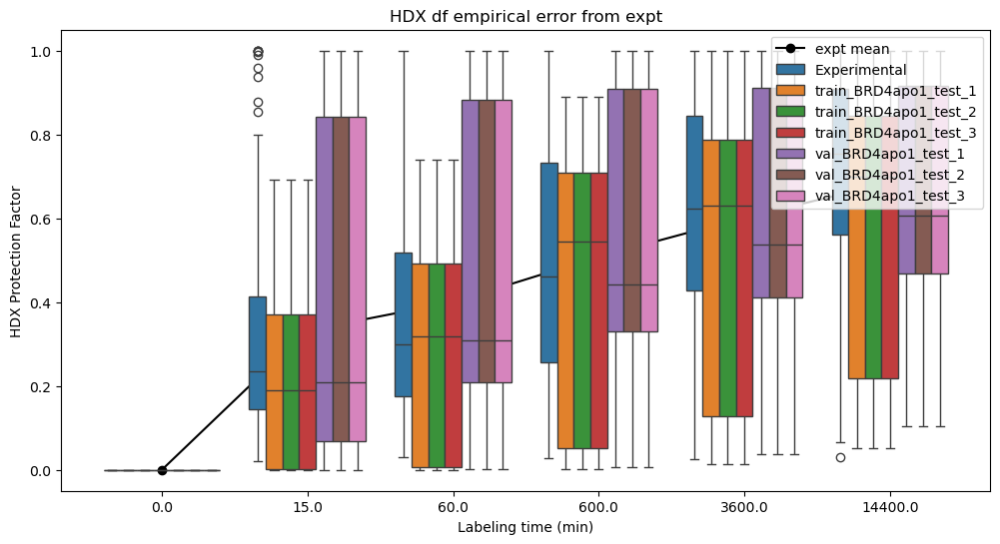

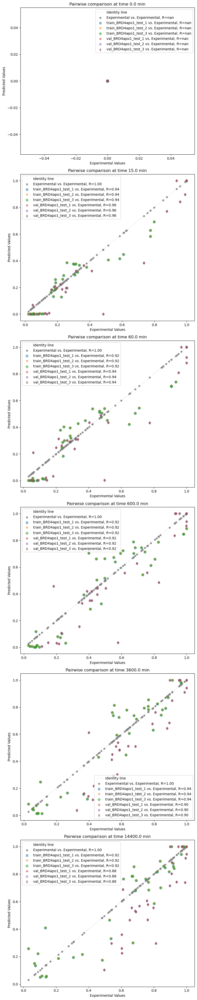

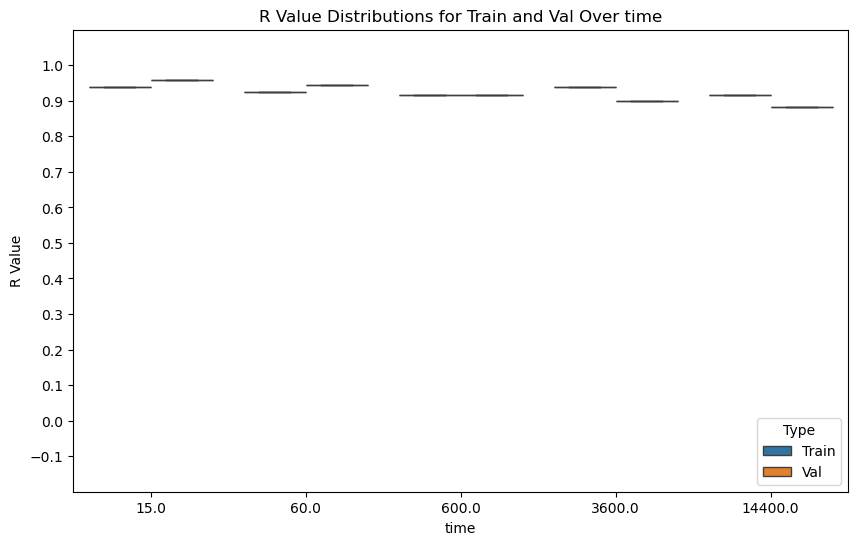

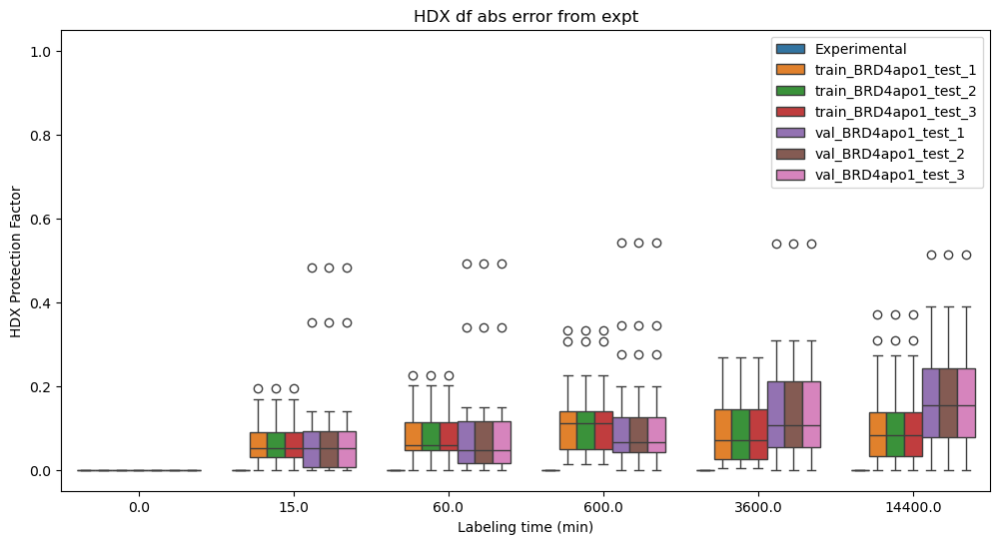

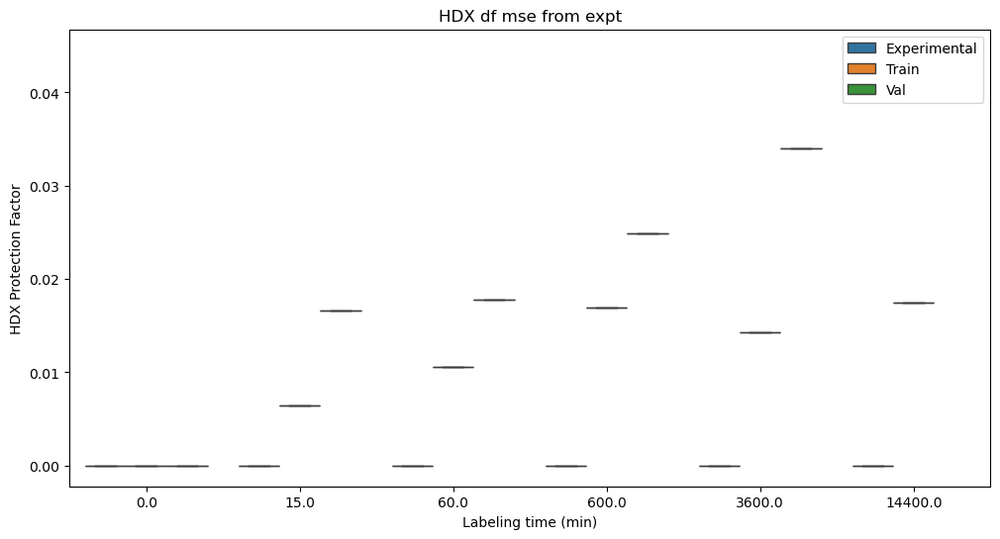

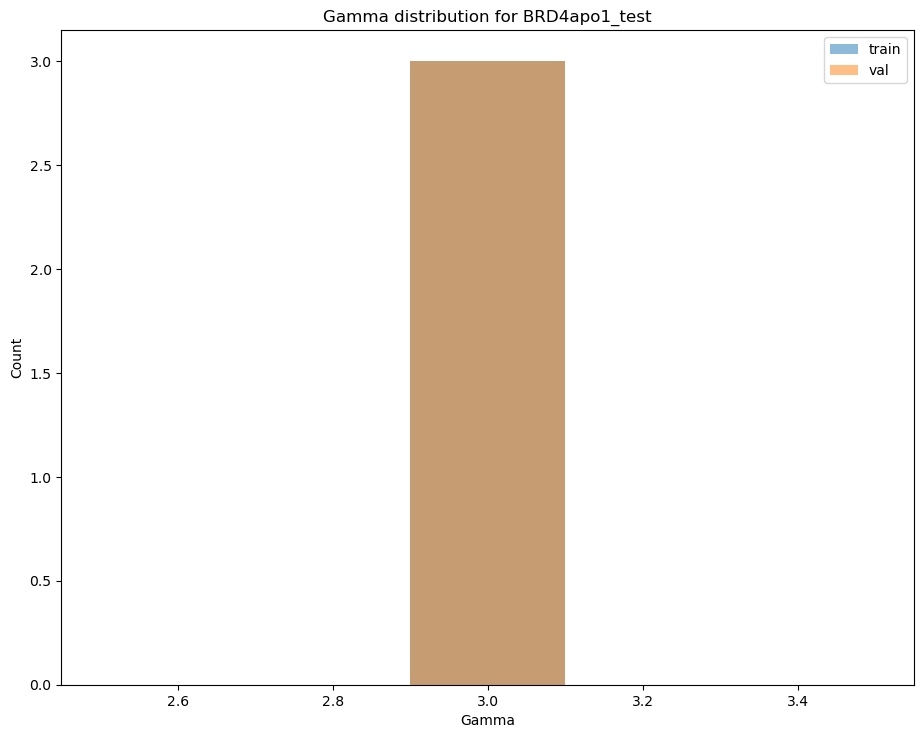

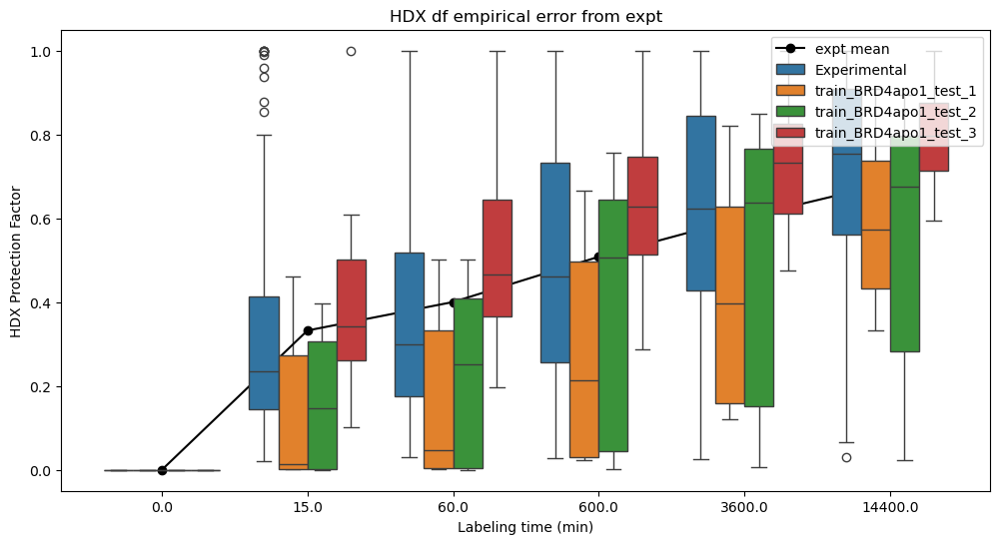

plotting dfracs compare for val
plot_dfracs_compare
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
551  0.0  0.026410  0.081749  0.216473  0.412591  0.540851       99   
552  0.0  0.803246  0.832563  0.839868  0.866657  0.915294      100   
553  0.0  0.876099  0.907578  0.909712  0.912756  0.922887      101   
554  0.0  0.919829  0.940198  0.941578  0.943548  0.950103      102   
555  0.0  1.000000  1.000000  1.000000  1.000000  1.000000      103   

                calc_name  ResStr  ResEnd path  
0            Experimental     NaN     NaN  NaN

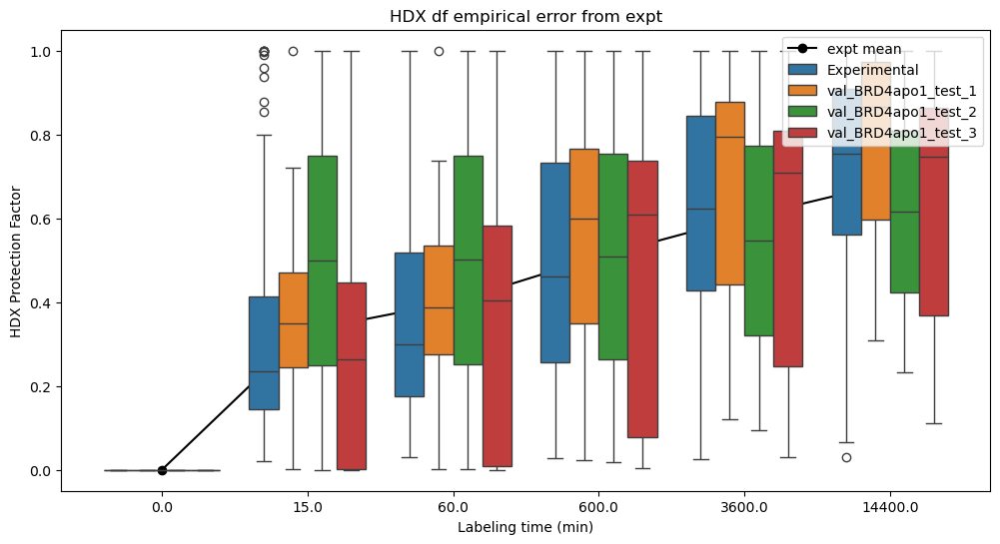

Restoring trainval peptide numbers
train_rep_names ['train_BRD4apo1_test_1', 'train_BRD4apo1_test_2', 'train_BRD4apo1_test_3']
val_rep_names ['val_BRD4apo1_test_1', 'val_BRD4apo1_test_2', 'val_BRD4apo1_test_3']
test_rep_names ['test_BRD4apo1_test_1', 'test_BRD4apo1_test_2', 'test_BRD4apo1_test_3']
train_rep_peptides [47, 48, 49, 50, 51, 52, 53, 78, 79, 80, 81, 82, 83, 84, 85, 99]
val_rep_peptides [7, 8, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 56, 57, 58, 61, 62, 63, 64, 65, 66, 67, 68, 89, 91, 92, 93, 94, 103]
test_rep_peptides [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99,

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


val_BRD4apo1_test_3 values
210    1.000000
211    1.000000
212    1.000000
213    1.000000
214    1.000000
215    0.663397
216    0.705818
217    0.662048
218    0.669045
219    0.631325
220    0.685233
221    0.738867
222    0.695282
223    0.858114
224    0.801305
225    0.733253
226    0.779228
227    0.587582
228    0.005167
229    0.114237
230    0.372454
231    0.015920
232    0.017488
233    0.028633
234    0.032300
235    0.066953
236    0.058584
237    0.066934
238    0.471210
239    0.446427
240    0.471229
241    0.367016
242    0.016980
243    0.216473
Name: 600.0, dtype: float64
[ 0  1  2  3  4 12 13 14 15 16 17 18 19 20 21 22 24 27 45 46 49 50 51 52
 53 78 79 80 81 82 83 84 85 99]
Values to compute R values
[0.95687, 0.93472, 0.99807, 0.92883, 1.0, 0.60965, 0.39858, 0.55148, 0.44498, 0.56129, 0.39754, 0.67362, 0.72188, 0.82574, 0.68366, 0.67434, 0.74418, 0.73015, 0.07153, 0.07449, 0.40875, 0.04927, 0.03807, 0.07952, 0.02771, 0.57848, 0.20102, 0.15004, 0.50275, 0.4176, 0.4

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


plotting R agreement
plotting paired trainval agreement
     0.0      15.0      60.0     600.0    3600.0   14400.0  peptide  \
0    0.0  1.000000  1.000000  0.956870  0.961950  0.974370        0   
1    0.0  1.000000  1.000000  0.934720  0.896640  0.898610        1   
2    0.0  1.000000  1.000000  0.998070  0.954280  0.949890        2   
3    0.0  0.937360  0.966910  0.928830  0.954830  0.969860        3   
4    0.0  1.000000  1.000000  1.000000  1.000000  1.000000        4   
..   ...       ...       ...       ...       ...       ...      ...   
239  0.0  0.253361  0.334423  0.446427  0.506689  0.540822       82   
240  0.0  0.267437  0.353002  0.471229  0.534836  0.570861       83   
241  0.0  0.195023  0.269360  0.367016  0.441804  0.485033       84   
242  0.0  0.000450  0.001794  0.016980  0.077000  0.151510       85   
243  0.0  0.026410  0.081749  0.216473  0.412591  0.540851       99   

               calc_name  ResStr  ResEnd  \
0           Experimental     NaN     NaN   
1  

/home/alexi/Documents/ValDX/ValDX/ValidationDX.py:1358: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dump["name"] = [name]*len(dump)
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:929: UserWarning: Reader has no dt information, set to 1.0 ps
  pickle.dump(self, f)


Preparing HDX data for Experimental
Path /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO/BRD4_APO.dat
AVG: ncol = 8, len(names) = 6
                                                 HDX  \
0  /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4...   
1                                                NaN   

                                                 SEG      calc_name  \
0  /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4...   Experimental   
1                                                NaN  BRD4apo1_test   

  experimental                                                top  \
0        False                                                NaN   
1          NaN  /home/alexi/Documents/ValDX/raw_data/BRD4/BRD4...   

                                                traj  
0                                                NaN  
1  [/home/alexi/Documents/ValDX/raw_data/BRD4/BRD...  
Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A

Saved val BRD4apo1_test HDX data to /home/alexi/Documents/ValDX/data/mixAandB_Sp/val_BRD4apo1_test_1/val_BRD4apo1_test_1_expt_dfracs.dat
/home/alexi/Documents/ValDX/data/mixAandB_Sp/train_BRD4apo1_test_1
BRD4apo1_test
/home/alexi/Documents/ValDX/data/mixAandB_Sp/train_BRD4apo1_test_1/out__train_BRD4apo1_test_1
envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/mixAandB_Sp/train_BRD4apo1_test_1/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
0.9999999999999999
Finished reweighting
[(array([0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_1
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

Recalculating val_BRD4apo1_test_1
    ResStr  ResEnd  peptide                                               path
0        1      26        0  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
1        5      26        1  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
2       12      26        2  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
3       15      26        3  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
4       27      40        4  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
5      162     173       57  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
6      165     172       58  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
7      407     424       81  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
8      446     453       99  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
9      453     467      100  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
10     454     467      101  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
11     454     477

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(89,)
[3.90060054e-02 0.00000000e+00 1.11445730e-02 4.45782919e-02
 1.05873443e-01 1.44879449e-01 3.34337189e-02 3.90060054e-02
 7.32942547e-02 9.47288703e-02 1.11445730e-01 1.05873443e-01
 2.34890563e-01 2.39608319e-01 2.07883661e-01 1.78313168e-01
 1.84739985e-01 1.61596308e-01 7.24397244e-02 7.24397244e-02
 1.67168595e-02 2.78614324e-02 2.78614324e-02 1.67168595e-02
 0.00000000e+00 0.00000000e+00 2.22891460e-02 2.22891460e-02
 1.11445730e-01 7.24397244e-02 1.61596308e-01 3.06475757e-01
 5.51656362e-01 7.35541817e-01 8.97138125e-01 1.07988058e+01
 1.10272695e+01 1.31091505e+01 4.11791972e+00 5.19337101e+00
 6.85647597e+00 1.28391529e+01 9.04166681e+00 1.13727870e+01
 2.14874842e+00 2.08102645e+00 2.44560349e+01 1.26539321e+01
 1.00906803e+01 1.04961933e+01 1.22192937e+01 1.09058192e+01
 1.08416750e+01 9.24999557e+00 1.70400521e+01 7.58388191e+00
 1.48224061e+01 2.02363904e+01 2.43668783e+01 1.98923322e+01
 1.96540236e+01 2.42052820e+01 1.94576939e+01 1.55626656e+01

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[3.90060054e-02 0.00000000e+00 1.11445730e-02 4.45782919e-02
 1.05873443e-01 1.44879449e-01 3.34337189e-02 3.90060054e-02
 7.32942547e-02 9.47288703e-02 1.11445730e-01 1.05873443e-01
 2.34890563e-01 2.39608319e-01 2.07883661e-01 1.78313168e-01
 1.84739985e-01 1.61596308e-01 7.24397244e-02 7.24397244e-02
 1.67168595e-02 2.78614324e-02 2.78614324e-02 1.67168595e-02
 0.00000000e+00 0.00000000e+00 2.22891460e-02 2.22891460e-02
 1.11445730e-01 7.24397244e-02 1.61596308e-01 3.06475757e-01
 5.51656362e-01 7.35541817e-01 8.97138125e-01 7.68975536e-01
 1.40978848e+00 2.09517972e+00 5.46084076e+00 5.14879272e+00
 8.50888147e+00 8.97138125e+00 1.00412603e+01 1.07545129e+00
 6.61152640e+00 4.23493773e+00 1.08158081e+01 1.32080280e+01
 1.73760983e+01 1.83762966e+01 1.69311699e+01 1.78036150e+01
 1.80564864e+01 1.74405262e+01 1.95022722e+01 2.06158750e+01
 1.76188394e+01 1.88614592e+01 2.27453429e+01 1.99257660e+01
 1.46259167e+01 1.57298342e+01 1.74070925e+01 1.61254666e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory: <Universe with 4155 atoms>
BRD4apo1_test Traj: no frames 110
Topology <Universe with 4155 atoms>
Writing train PDB to results/mixAandB_Sp/train_1_mixAandB_Sp_20240229-165552.pdb
Writing val PDB to results/mixAandB_Sp/val_1_mixAandB_Sp_20240229-165552.pdb
Splitting segments for BRD4apo1_test by spatial split: random point in space
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 13

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_segs["calc_name"] = train_rep_name
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_segs["calc_name

envs ['# conda environments:', '#', 'base                     /home/alexi/anaconda3', 'HDXER_ENV             *  /home/alexi/anaconda3/envs/HDXER_ENV', 'openfold_env             /home/alexi/anaconda3/envs/openfold_env', 'plumed-masterclass-2022     /home/alexi/anaconda3/envs/plumed-masterclass-2022', '                         /home/alexi/localcolabfold/colabfold-conda', '                         /home/alexi/localcolabfold/conda', '']
name base
name HDXER_ENV
Environment 'HDXER_ENV' found.
Path to 'HDXER_ENV' environment: /home/alexi/anaconda3/envs/HDXER_ENV
PATH /home/alexi/anaconda3/envs/HDXER_ENV:/home/alexi/anaconda3/envs/HDXER_ENV/bin:/home/alexi/anaconda3/condabin:/home/alexi/.vscode/cli/servers/Stable-903b1e9d8990623e3d7da1df3d33db3e42d80eda/server/bin/remote-cli:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/usr/games:/usr/local/games:/snap/bin:/snap/bin
calc_hdx
/home/alexi/Documents/HDXer/HDXer/calc_hdx.py
conda run -n HDXER_ENV python /home/alexi/Documents/HDXer

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

/home/alexi/Documents/ValDX/data/mixAandB_Sp/train_BRD4apo1_test_2/reweighting_gamma_3x10^0
Contacts read
Hbonds read
Segments and experimental dfracs read
Sum of Output Weights
0.9999999999999999
Finished reweighting
[(array([0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 0.00909091, 0.00909091,
       0.00909091, 0.00909091, 0.00909091, 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: inva

Recalculating no_weight_BRD4apo1_test_2
     ResStr  ResEnd  peptide
0         1      26        0
1         5      26        1
2        12      26        2
3        15      26        3
4        27      40        4
..      ...     ...      ...
99      446     453       99
100     453     467      100
101     454     467      101
102     454     477      102
103     468     477      103

[104 rows x 3 columns]
Residues for recalculation: [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar di

Recalculating val_BRD4apo1_test_2
    ResStr  ResEnd  peptide                                               path
13      27      40        4  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
14      66      72        7  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
15      68      74        8  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
16      69      78        9  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
17      69      88       10  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
18      69      91       11  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
19      75      91       12  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
20      78      88       13  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
21      78      91       14  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
22      79      88       15  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
23      79      91       16  /home/alexi/Documents/ValDX/data/mixAandB_Sp/v...
24      82      88

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(75,)
[1.52816982e-02 0.00000000e+00 0.00000000e+00 2.03755976e-02
 2.03755976e-02 1.01877988e-01 6.62206924e-02 1.47723083e-01
 2.80164468e-01 5.04296042e-01 6.72394722e-01 8.20117805e-01
 1.76563555e+01 1.86759145e+01 1.59346175e+01 1.70705571e+01
 2.06210050e+01 1.80434919e+01 1.33421813e+01 1.42077856e+01
 1.57410494e+01 1.45694525e+01 9.74391060e+00 1.19993705e+01
 4.06613035e+00 7.08052018e+00 1.87922350e+01 9.53068580e+00
 9.80348024e+00 1.59599068e+01 1.20725416e+01 8.05854887e+00
 8.50681202e+00 1.57858150e+01 9.86688316e+00 7.67776608e+00
 8.99355024e+00 8.97826854e+00 1.14495888e+01 8.20117805e+00
 1.37530497e+01 9.44408951e+00 6.63621239e+00 1.93628118e+01
 1.73201582e+01 1.90019240e+01 1.51058700e+01 1.74831630e+01
 1.55431663e+01 1.35358095e+01 1.63174991e+01 9.94730805e+00
 1.12544625e+01 1.09233591e+01 9.07001784e+00 7.35049685e+00
 1.24499708e+01 5.63894665e+00 7.59500402e+00 1.66483623e+01
 1.59988606e+01 1.73785282e+01 2.38403494e+01 1.94901593e+01

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

LogPf_by_res shape
(257,)
[3.56572959e-02 0.00000000e+00 1.01877988e-02 4.07511953e-02
 9.67840888e-02 1.32441385e-01 3.05633965e-02 3.56572959e-02
 6.54416368e-02 8.65962900e-02 1.01877988e-01 9.67840888e-02
 2.13164720e-01 2.19037675e-01 1.86916167e-01 1.63004781e-01
 1.67319625e-01 1.47723083e-01 6.62206924e-02 6.62206924e-02
 1.52816982e-02 2.54694971e-02 2.54694971e-02 1.52816982e-02
 0.00000000e+00 0.00000000e+00 2.03755976e-02 2.03755976e-02
 1.01877988e-01 6.62206924e-02 1.47723083e-01 2.80164468e-01
 5.04296042e-01 6.72394722e-01 8.20117805e-01 7.02958119e-01
 1.28875655e+00 1.91530618e+00 4.99202142e+00 4.70676306e+00
 7.77838440e+00 8.20117805e+00 9.17920674e+00 9.83122586e-01
 5.92690264e+00 3.87136355e+00 9.88725876e+00 1.20709835e+01
 1.58812203e+01 1.66582507e+01 1.54729292e+01 1.61222527e+01
 1.63393728e+01 1.57716128e+01 1.76563555e+01 1.86759145e+01
 1.59346175e+01 1.70705571e+01 2.06210050e+01 1.80434919e+01
 1.33421813e+01 1.42077856e+01 1.57410494e+01 1.45694525e+0

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/core/universe.py:817: DeprecationWarning

Structures loaded BRD4apo1_test: 
BRD4apo1_test Topology: <Universe with 4155 atoms>
BRD4apo1_test Trajectory: <Universe with 4155 atoms>
BRD4apo1_test Traj: no frames 110
Topology <Universe with 4155 atoms>
Writing train PDB to results/mixAandB_Sp/train_2_mixAandB_Sp_20240229-165715.pdb
Writing val PDB to results/mixAandB_Sp/val_2_mixAandB_Sp_20240229-165715.pdb
Splitting segments for BRD4apo1_test by spatial split: random point in space
HDX residues:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 13

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:753: UserWarning: Unit cell dimensions not found. CRYST1 record set to unitary values.
  warnings.warn("Unit cell dimensions not found. "
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:1129: UserWarning: Found no information for attr: 'formalcharges' Using default value of '0'
  warnings.warn("Found no information for attr: '{}'"
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/coordinates/PDB.py:432: UserWarning: 1 A^3 CRYST1 record, this is usually a placeholder. Unit cell dimensions will be set to None.
  warnings.warn("1 A^3 CRYST1 record,"
/home/alexi/Documents/ValDX/ValDX/Experiment_ABC.py:733: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-do

Saved train BRD4apo1_test_3 segments to /home/alexi/Documents/ValDX/data/mixAandB_Sp/train_BRD4apo1_test_3/train_residue_segs__BRD4apo1_test_.txt
Train Peptide numbers: [  0   1   2   3  59  62  78  79  80  81  82  83  84  85  97  98  99 100
 101 102 103]
Saved val BRD4apo1_test_3 segments to /home/alexi/Documents/ValDX/data/mixAandB_Sp/val_BRD4apo1_test_3/val_residue_segs__BRD4apo1_test_.txt
Val Peptide numbers: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27 28 29 30 36 42
 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 65 66 67 68]
train_HDX_data
    0.0     15.0     60.0    600.0   3600.0  14400.0  peptide  \
0   0.0  1.00000  1.00000  0.95687  0.96195  0.97437        0   
1   0.0  1.00000  1.00000  0.93472  0.89664  0.89861        1   
2   0.0  1.00000  1.00000  0.99807  0.95428  0.94989        2   
3   0.0  0.93736  0.96691  0.92883  0.95483  0.96986        3   
4   0.0  0.73567  0.77284  0.82995  0.87946  0.93920       59   
5   0.0  0.04717  0.06008  0.18231  0.39881

KeyboardInterrupt: 

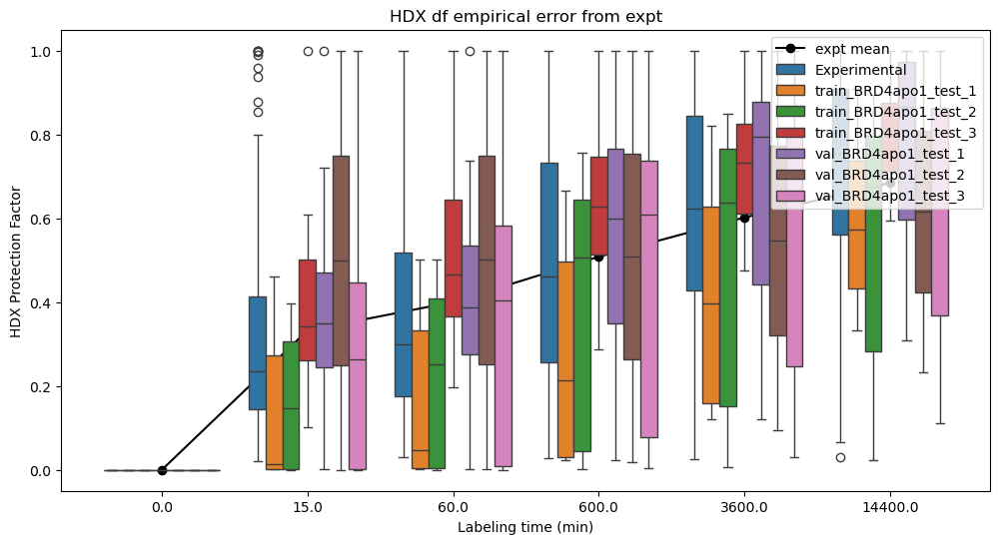

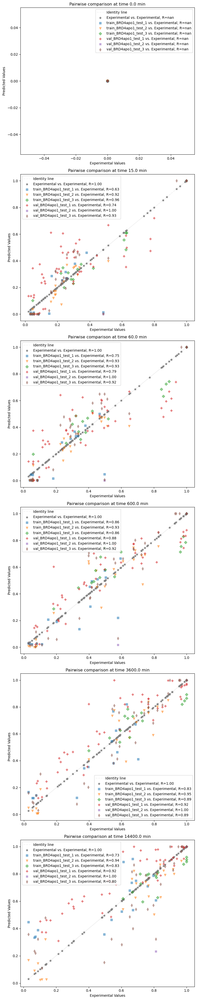

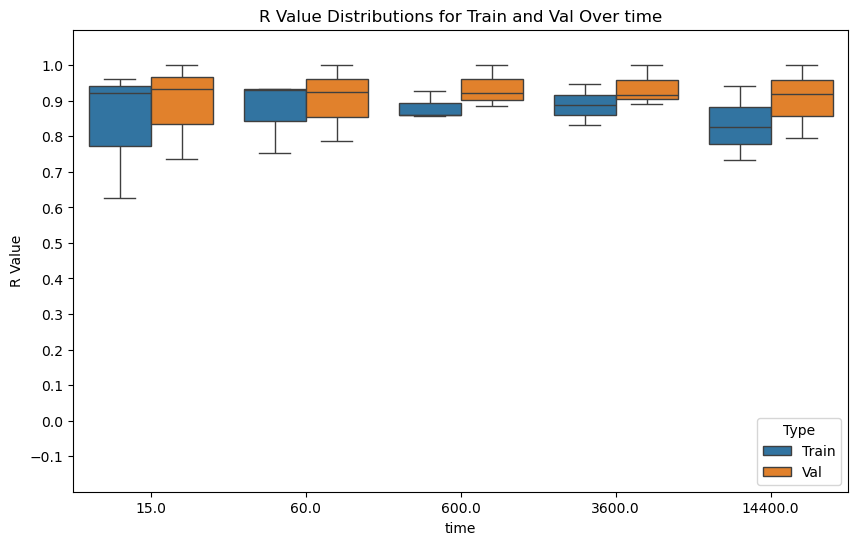

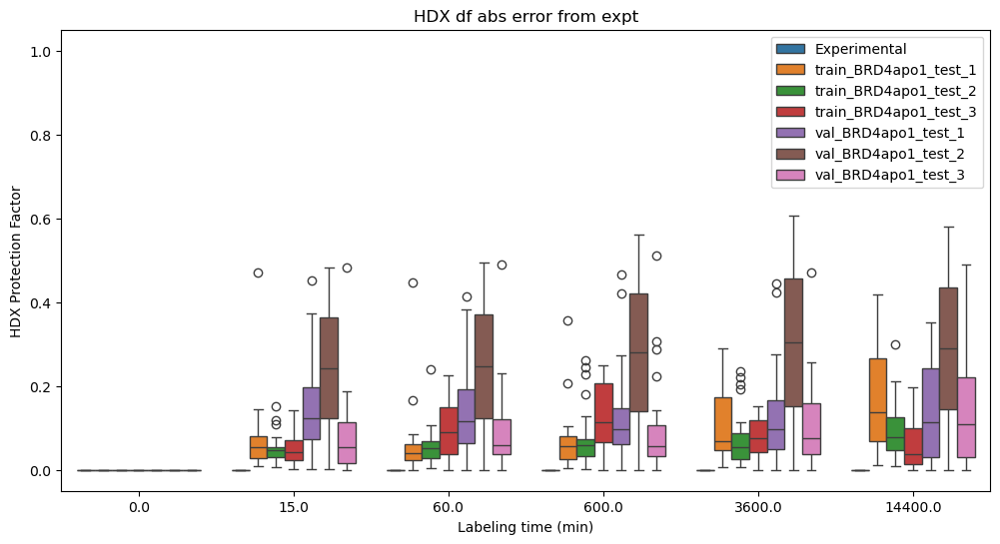

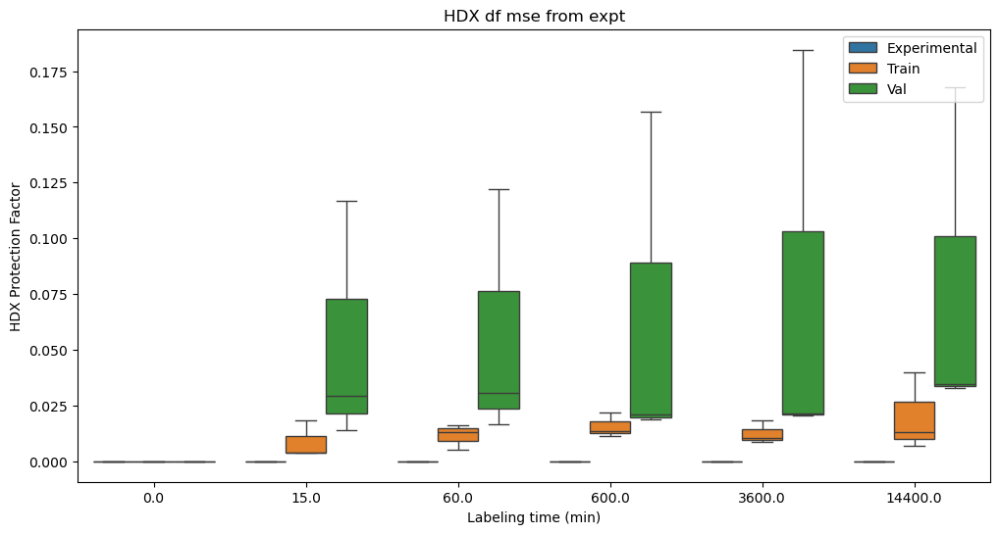

Residue predictions complete



/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/mdtraj/formats/pdb/pdbfile.py:200: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn('Unlikely unit cell vectors detected in PDB file likely '
/home/alexi/Documents/HDXer/HDXer/dfpred.py:505: RuntimeWarning: divide by zero encountered in log
  logerr = logf + np.log(err) + np.log(time) # sd(e^Aa) = f * sd(A) * a
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degr

In [ ]:

# splits = ['S', 'SR', 'Sp']
# split_names = ['AvsB', 'LvsX', 'mixAandB']
# system = 'BPTITtut_test'

# raw_run_outputs = {}
# analysis_dumps = {}
# analysis_df = pd.DataFrame()
# names = []
# save_paths = []

# pr = cProfile.Profile()
# pr.enable()


# for split, split_name in zip(splits, split_names):
#     run_outputs, analysis_dump, df, name, save_path = run_split_test(split, split_name, system)
#     raw_run_outputs[name] = run_outputs
#     analysis_dumps.update(analysis_dump)
#     analysis_df = pd.concat([analysis_df, df])
#     names.append(name)
#     save_paths.append(save_path)

# pr.disable()
# ps = pstats.Stats(pr).sort_stats('cumulative')


In [ ]:
ps = pstats.Stats(pr).sort_stats('cumulative')
ps.print_stats()

         30099889 function calls (29568428 primitive calls) in 239.850 seconds

   Ordered by: cumulative time

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        2    0.000    0.000  239.855  119.927 /home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3472(run_code)
        2    0.000    0.000  239.855  119.927 {built-in method builtins.exec}
        1    0.000    0.000  239.855  239.855 /tmp/ipykernel_215014/742124640.py:15(<module>)
        3    0.000    0.000  239.853   79.951 /tmp/ipykernel_215014/853554474.py:1(run_split_test)
        3    0.000    0.000  236.854   78.951 /home/alexi/Documents/ValDX/ValDX/ValidationDX.py:597(run_VDX)
        3    0.000    0.000  148.239   49.413 /home/alexi/Documents/ValDX/ValDX/ValidationDX.py:673(train_HDX)
     5236  142.140    0.027  142.140    0.027 {method 'acquire' of '_thread.lock' objects}
      780    0.004    0.000  141.891    0.182 /home/alexi/anaconda3/envs/HD

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:718: UserWarning: Using the boxplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:723: UserWarning: Using the boxplot function without specifying `hue_order` is likely to produce an incorrect plot.
  warnings.warn(warning)


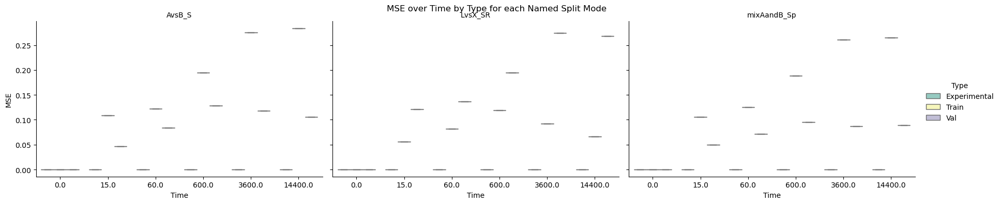

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming your DataFrame is named df
# Replace 'your_dataframe' with your actual DataFrame variable
df = analysis_df

# Create a FacetGrid, using 'name' for each subplot
g = sns.FacetGrid(df, col="name", col_wrap=3, height=4, aspect=1.5)
g.fig.suptitle('MSE over Time by Type for each Named Split Mode')

# Create boxplots
g = g.map(sns.boxplot, "time", "mse", "Type", palette="Set3")

# Adding some additional options for better visualization
g.add_legend(title='Type')
g.set_axis_labels("Time", "MSE")
g.set_titles("{col_name}")

# Adjust the arrangement of the plots
plt.subplots_adjust(top=0.9)

# Show plot
plt.show()


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:718: UserWarning: Using the boxplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:723: UserWarning: Using the boxplot function without specifying `hue_order` is likely to produce an incorrect plot.
  warnings.warn(warning)


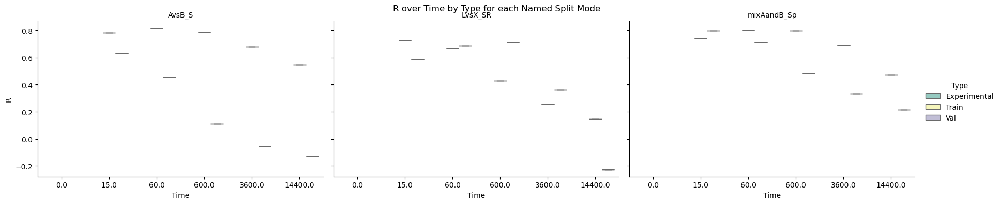

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming your DataFrame is named df
# Replace 'your_dataframe' with your actual DataFrame variable
df = analysis_df

# Create a FacetGrid, using 'name' for each subplot
g = sns.FacetGrid(df, col="name", col_wrap=3, height=4, aspect=1.5)
g.fig.suptitle('R over Time by Type for each Named Split Mode')

# Create boxplots
g = g.map(sns.boxplot, "time", "R", "Type", palette="Set3")

# Adding some additional options for better visualization
g.add_legend(title='Type')
g.set_axis_labels("Time", "R")
g.set_titles("{col_name}")

# Adjust the arrangement of the plots
plt.subplots_adjust(top=0.9)

# Show plot
plt.show()


                                               LogPf  \
0  [9.46195966523599e-08, 0.0, 0.3474833764348352...   
1  [0.03888888888888889, 0.0, 0.02333333333333333...   
2  [11.810079571145488, 11.448168395988198, 2.800...   
3  [9.46195966523599e-08, 0.0, 0.3474833764348352...   
0  [3.537111349121258e-05, 0.0, 0.209311715549231...   
1  [0.03888888888888889, 0.0, 0.02333333333333333...   
2  [0.6802743245668219, 0.8947929163997181, 1.740...   
3  [3.537111349121258e-05, 0.0, 0.209311715549231...   
0  [0.6999140846895217, 1.0501323471686763, 2.448...   
1  [0.03888888888888889, 0.0, 0.02333333333333333...   
2  [7.793364602866008e-09, 0.0, 0.349417904533897...   
3  [7.793364602866008e-09, 0.0, 0.349417904533897...   

                   calc_name  \
0      train_BRD4apo1_test_1   
1  no_weight_BRD4apo1_test_1   
2        val_BRD4apo1_test_1   
3       test_BRD4apo1_test_1   
0      train_BRD4apo1_test_1   
1  no_weight_BRD4apo1_test_1   
2        val_BRD4apo1_test_1   
3       test_BR

ValueError: Multi-dimensional indexing (e.g. `obj[:, None]`) is no longer supported. Convert to a numpy array before indexing instead.

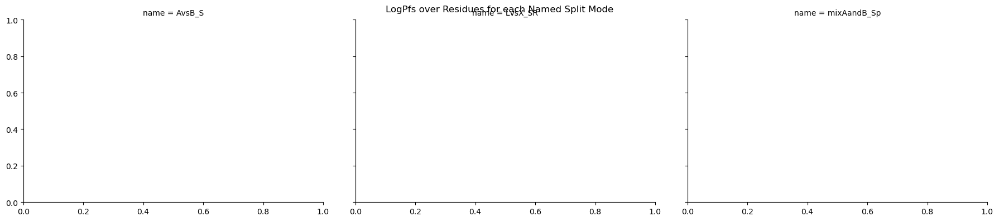

In [ ]:
# plot LogPfs by Residues colour by calc_name facet wrap by name
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
LogPfs = pd.concat([analysis_dumps[i]["LogPfs"] for i in names])

print(LogPfs)

LogPfs_df = LogPfs.explode(['LogPf','Residues'])


# Create a FacetGrid, using 'name' for each subplot
g = sns.FacetGrid(LogPfs_df, col="name", col_wrap=3, height=4, aspect=1.5)
g.fig.suptitle('LogPfs over Residues for each Named Split Mode')

# Create lineplots
g = g.map(sns.lineplot, "Residues", "LogPf", "calc_name", palette="Set2")

# Adding some additional options for better visualization
g.add_legend(title='calc_name')
g.set_axis_labels("Residues", "LogPf")
g.set_titles("{col_name}")

# Adjust the arrangement of the plots
plt.subplots_adjust(top=0.9)

# Show plot
plt.show()


In [ ]:
# from MDAnalysis.analysis.dssp import DSSP



In [ ]:
# VDX.paths.head()

In [ ]:
# print(top_path)

In [ ]:
# pdb_test = mda.Universe(top_path)

# # write out as a pdb and add header
# pdb_test.atoms.write('test.pdb')
# with open('test.pdb', 'r') as original: data = original.read()
# with open('test.pdb', 'w') as modified: modified.write('HEADER    '+sim_name+'\n'+data)



In [ ]:


# def PDB_to_DSSP(top_path: str, dssp_path: str=None, sim_name: str=None):
#     """
#     Run DSSP on a PDB file to generate a DSSP file. Reads the output and returns a list of secondary structure elements.
#     Secondary structure elements are reduced to a single character: H (alpha helix), S (beta sheet), or L (loop).
#     Args:
#     - top_path (str): The path to the topology file to create the PDB file from.
#     - dssp_path (str): The path to save the DSSP file.
#     - sim_name (str): Simulation name to be included in the HEADER of the PDB file.
#     Returns:
#     - List of tuples, each containing the residue number and its secondary structure element.
#     """
#     temp_pdb = "do_mkdssp.pdb"

#     if sim_name is None:
#         sim_name = "DSSP HEADER"
#     if dssp_path is None:
#         dssp_path = "dssp_file.dssp"
#     print(top_path)
#     pdb_test = mda.Universe(top_path)

#     # write out as a pdb and add header
#     pdb_test.atoms.write(temp_pdb)


#     with open(temp_pdb, 'r') as original: data = original.read()
#     with open(temp_pdb, 'w') as modified: modified.write('HEADER    '+sim_name+'\n'+data)

#     # Run mkdssp to generate DSSP file
#     try:
#         subprocess.run(['mkdssp', temp_pdb,  dssp_path], check=True)
#     except subprocess.CalledProcessError as e:
#         print(f"Error running DSSP: {e}")
#         return []

#     # Parse the DSSP file
#     secondary_structures = []
#     with open(dssp_path, 'r') as dssp_file:
#         # Skip header lines
#         for line in dssp_file:
#             if line.startswith('  #  RESIDUE AA'):
#                 break
#         # Read the secondary structure assignments
#         for line in dssp_file:
#             if len(line) > 13:  # Ensure line has enough data
#                 residue_num = line[5:10].strip()
#                 ss = line[16]
#                 # Simplify the secondary structure to H, S, or L
#                 if ss in 'GHI':
#                     ss = 'H'  # Helix
#                 elif ss in 'EB':
#                     ss = 'S'  # Sheet
#                 else:
#                     ss = 'L'  # Loop or other
#                 secondary_structures.append((residue_num, ss))

#     # Cleanup temp PDB file
#     os.remove(temp_pdb)
#     os.remove(dssp_path)
#     print(len(secondary_structures))
#     print(len(pdb_test.residues))
#     return secondary_structures

